# Simulating random galaxies

In this notebook, I will use galsim to simulate random galaxies.

## Downloading libraries

In [2]:
# Load modules/libraries
import copy
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
from astropy.io import fits
import galsim
import sys
import os
import math
import logging
import time

We will create elliptical galaxies, spiral galaxies, ring galaxies and mergers of two galaxies. We will do 100 each.

## Creating one elliptical galaxy


In [3]:
def main(argv):
    
    # In non-script code, use getLogger(__name__) at module scope instead.
    logging.basicConfig(format="%(message)s", level=logging.INFO, stream=sys.stdout)
    logger = logging.getLogger("demo2")

    gal_flux = 1.e5    # counts
    gal_r0 = round(np.random.uniform(0.1,5),2)#2.7       # arcsec
    g1 = round(np.random.uniform(-0.7,0.7),2) #0.1 
    g2 = round(np.random.uniform(-0.7,0.7),2) #0.2 
    if abs(g1+g2)>0.7:
        g1 = round(np.random.uniform(-0.35, 0.35),2)
        g2 = round(np.random.uniform(-0.35, 0.35),2)
    psf_beta = 5       #
    psf_re = 1.0       # arcsec
    pixel_scale = 0.2  # arcsec / pixel
    sky_level = 2.5e3  # counts / arcsec^2

    # This time use a particular seed, so the image is deterministic.
    random_seed = 1534225

    random_seed = galsim.BaseDeviate(random_seed).raw()

    logger.info('Starting demo script 2 using:')
    logger.info('    - sheared (%.2f,%.2f) exponential galaxy (flux = %.1e, scale radius = %.2f),',
                g1, g2, gal_flux, gal_r0)
    logger.info('    - circular Moffat PSF (beta = %.1f, re = %.2f),', psf_beta, psf_re)
    logger.info('    - pixel scale = %.2f,', pixel_scale)
    logger.info('    - Poisson noise (sky level = %.1e).', sky_level)

    # Initialize the (pseudo-)random number generator that we will be using below.
    # For a technical reason that will be explained later (demo9.py), we add 1 to the
    # given random seed here.
    rng = galsim.BaseDeviate(random_seed+1)

    # Define the galaxy profile.
    gal = galsim.Exponential(flux=gal_flux, scale_radius=gal_r0)
    gal = gal.shear(g1=g1, g2=g2)
    logger.debug('Made galaxy profile')

    # Define the PSF profile.
    psf = galsim.Moffat(beta=psf_beta, flux=1., half_light_radius=psf_re)
    logger.debug('Made PSF profile')

    # Final profile is the convolution of these.
    final = galsim.Convolve([gal, psf])
    logger.debug('Convolved components into final profile')
 
    # Draw the image with a particular pixel scale.
    image = final.drawImage(scale=pixel_scale)
    # The "effective PSF" is the PSF as drawn on an image, which includes the convolution
    # by the pixel response.  We label it epsf here.
    image_epsf = psf.drawImage(scale=pixel_scale)
    logger.debug('Made image of the profile')

    # To get Poisson noise on the image, we will use a class called PoissonNoise.
    # However, we want the noise to correspond to what you would get with a significant
    # flux from tke sky.  This is done by telling PoissonNoise to add noise from a
    # sky level in addition to the counts currently in the image.
    #
    # One wrinkle here is that the PoissonNoise class needs the sky level in each pixel,
    # while we have a sky_level in counts per arcsec^2.  So we need to convert:
    sky_level_pixel = sky_level * pixel_scale**2
    noise = galsim.PoissonNoise(rng, sky_level=sky_level_pixel)
    image.addNoise(noise)
    logger.debug('Added Poisson noise')

    # Write the image to a file.
    if not os.path.isdir('random_sim_gal'):
        os.mkdir('random_sim_gal')
    file_name = os.path.join('random_sim_gal', 'demo2.fits')
    file_name_epsf = os.path.join('random_sim_gal','demo2_epsf.fits')
    image.write(file_name)
    image_epsf.write(file_name_epsf)
    logger.info('Wrote image to %r',file_name)
    logger.info('Wrote effective PSF image to %r',file_name_epsf)

    results = galsim.hsm.EstimateShear(image, image_epsf)

    logger.info('HSM reports that the image has observed shape and size:')
    logger.info('    e1 = %.3f, e2 = %.3f, sigma = %.3f (pixels)', results.observed_shape.e1,
                results.observed_shape.e2, results.moments_sigma)
    logger.info('When carrying out Regaussianization PSF correction, HSM reports distortions')
    logger.info('    e1, e2 = %.3f, %.3f',
                results.corrected_e1, results.corrected_e2)
    logger.info('Expected values in the limit that noise and non-Gaussianity are negligible:')
    exp_shear = galsim.Shear(g1=g1, g2=g2)
    logger.info('    g1, g2 = %.3f, %.3f', exp_shear.e1,exp_shear.e2)

if __name__ == "__main__":
    main(sys.argv)

fits_file_path = 'random_sim_gal/demo2.fits'
# Open the FITS file
with fits.open(fits_file_path) as hdul:
    # Access the image data (assuming it's in the primary HDU)
    image_data = hdul[0].data

# Plot the image
size = (64,64)
plt.imshow(image_data, cmap='gray',extent=[0, size[0], 0, size[1]],origin='lower')
plt.colorbar(label='Intensity')
plt.title('FITS Image')
plt.show()



###################################################################
plt.imshow(image_data, cmap='gray',extent=[0, size[0], 0, size[1]])

filename = f'random_sim_gal{0}_ellips.png'
save_path = f'random_sim_gal/{filename}'
print(save_path)
plt.savefig(save_path)
plt.show()

png_image = Image.open(save_path)
# Convert the PNG image to a NumPy array
data = np.array(png_image)

# Create a FITS header
header = fits.Header()
header['COMMENT'] = 'Converted from PNG to FITS'

# Create a FITS HDU (Header/Data Unit)
hdu = fits.PrimaryHDU(data, header=header)

# Specify the path for saving the FITS file
filename = f'ellips{0}.fits'
fits_path = f'random_sim_gal/{filename}'

# Write the FITS file
hdu.writeto(fits_path, overwrite=True)

if os.path.exists(save_path):
    # Delete the file
    os.remove(save_path)
    
# Specify the path to your FITS file
fits_file_path = "random_sim_gal/ellips0.fits"

# Open the FITS file
hdul = fits.open(fits_file_path)

# Assuming the data is in the primary HDU (extension 0)
data = hdul[0].data

# Close the FITS file
hdul.close()

# Plot the image using matplotlib
plt.imshow(data, cmap='gray')  # Use 'cmap' to specify the color map
plt.title("FITS Image")
plt.colorbar(label="Intensity")
plt.show()

print(np.shape(np.array(data)))

Starting demo script 2 using:
    - sheared (0.47,-0.67) exponential galaxy (flux = 1.0e+05, scale radius = 4.12),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/demo2.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'


GalSimHSMError: Error: too many iterations in adaptive moments


Starting demo script 2 using:
    - sheared (-0.08,-0.13) exponential galaxy (flux = 1.0e+05, scale radius = 3.13),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips0.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'
HSM reports that the image has observed shape and size:
    e1 = -0.180, e2 = -0.222, sigma = 19.059 (pixels)
When carrying out Regaussianization PSF correction, HSM reports distortions
    e1, e2 = -0.194, -0.239
Expected values in the limit that noise and non-Gaussianity are negligible:
    g1, g2 = -0.156, -0.254


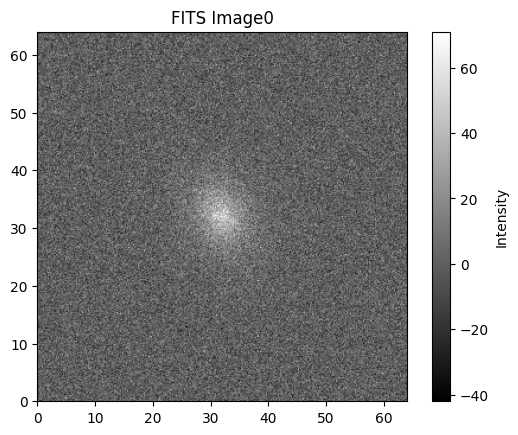

Starting demo script 2 using:
    - sheared (0.20,0.06) exponential galaxy (flux = 1.0e+05, scale radius = 0.15),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips1.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'
HSM reports that the image has observed shape and size:
    e1 = 0.031, e2 = 0.009, sigma = 4.253 (pixels)
When carrying out Regaussianization PSF correction, HSM reports distortions
    e1, e2 = 0.340, 0.098
Expected values in the limit that noise and non-Gaussianity are negligible:
    g1, g2 = 0.383, 0.115


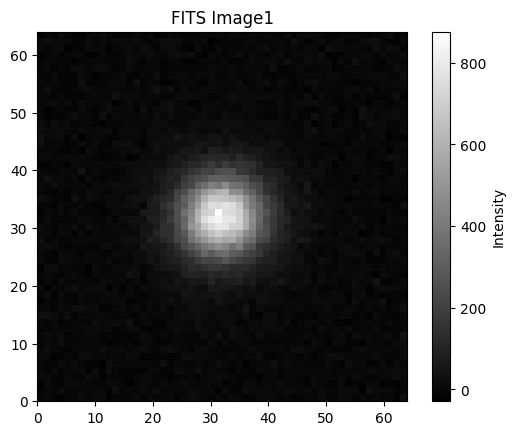

Starting demo script 2 using:
    - sheared (0.46,0.06) exponential galaxy (flux = 1.0e+05, scale radius = 4.73),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips2.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'
HSM reports that the image has observed shape and size:
    e1 = 0.736, e2 = 0.116, sigma = 29.428 (pixels)
When carrying out Regaussianization PSF correction, HSM reports distortions
    e1, e2 = 0.753, 0.119
Expected values in the limit that noise and non-Gaussianity are negligible:
    g1, g2 = 0.757, 0.099


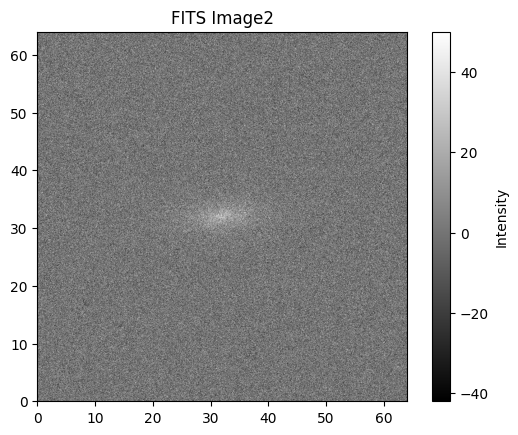

Starting demo script 2 using:
    - sheared (-0.39,0.12) exponential galaxy (flux = 1.0e+05, scale radius = 3.70),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips3.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'
HSM reports that the image has observed shape and size:
    e1 = -0.650, e2 = 0.154, sigma = 22.910 (pixels)
When carrying out Regaussianization PSF correction, HSM reports distortions
    e1, e2 = -0.677, 0.160
Expected values in the limit that noise and non-Gaussianity are negligible:
    g1, g2 = -0.669, 0.206


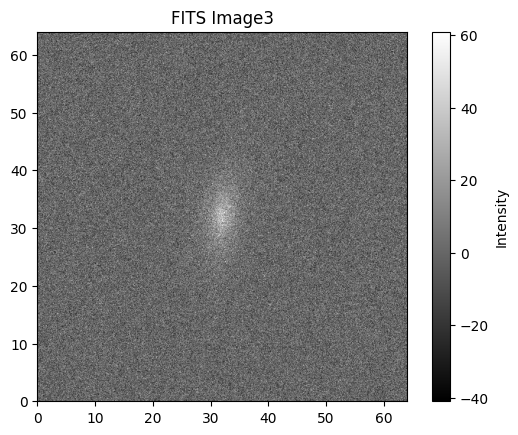

Starting demo script 2 using:
    - sheared (-0.04,-0.05) exponential galaxy (flux = 1.0e+05, scale radius = 2.60),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips4.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'
HSM reports that the image has observed shape and size:
    e1 = -0.023, e2 = -0.086, sigma = 16.089 (pixels)
When carrying out Regaussianization PSF correction, HSM reports distortions
    e1, e2 = -0.025, -0.095
Expected values in the limit that noise and non-Gaussianity are negligible:
    g1, g2 = -0.080, -0.100


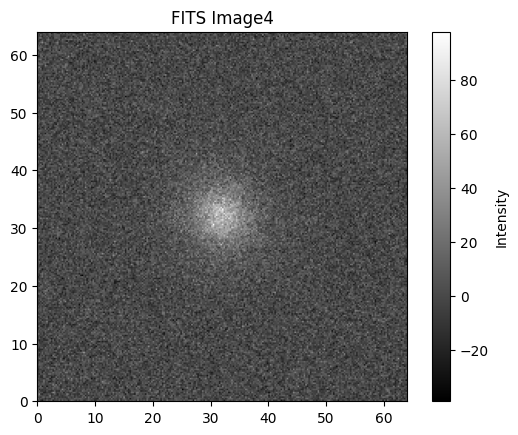

Starting demo script 2 using:
    - sheared (-0.14,0.51) exponential galaxy (flux = 1.0e+05, scale radius = 3.23),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips5.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'
HSM reports that the image has observed shape and size:
    e1 = -0.211, e2 = 0.768, sigma = 20.239 (pixels)
When carrying out Regaussianization PSF correction, HSM reports distortions
    e1, e2 = -0.219, 0.798
Expected values in the limit that noise and non-Gaussianity are negligible:
    g1, g2 = -0.219, 0.797


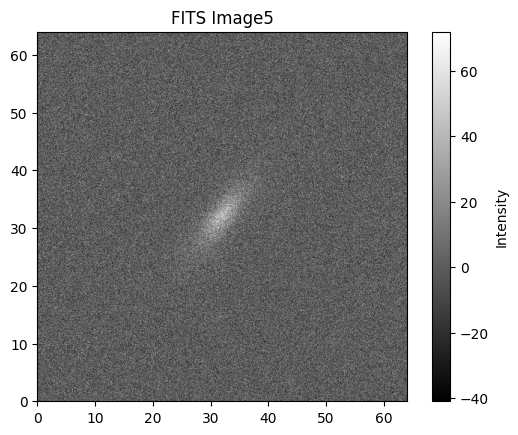

Starting demo script 2 using:
    - sheared (-0.40,0.62) exponential galaxy (flux = 1.0e+05, scale radius = 3.51),
    - circular Moffat PSF (beta = 5.0, re = 1.00),
    - pixel scale = 0.20,
    - Poisson noise (sky level = 2.5e+03).
Wrote image to 'random_sim_gal/ellips6.fits'
Wrote effective PSF image to 'random_sim_gal/demo2_epsf.fits'


GalSimHSMError: Error: too many iterations in adaptive moments


In [4]:


for i in range(400):
    def main(argv):
        
        # In non-script code, use getLogger(__name__) at module scope instead.
        logging.basicConfig(format="%(message)s", level=logging.INFO, stream=sys.stdout)
        logger = logging.getLogger("demo2")
    
        gal_flux = 1.e5    # counts
        gal_r0 = round(np.random.uniform(0.1,5),2)#2.7       # arcsec
        g1 = round(np.random.uniform(-0.7,0.7),2) #0.1 
        g2 = round(np.random.uniform(-0.7,0.7),2) #0.2 
        if abs(g1+g2)>0.7:
            g1 = round(np.random.uniform(-0.35, 0.35),2)
            g2 = round(np.random.uniform(-0.35, 0.35),2)
        psf_beta = 5       #
        psf_re = 1.0       # arcsec
        pixel_scale = 0.2  # arcsec / pixel
        sky_level = 2.5e3  # counts / arcsec^2
    
        # This time use a particular seed, so the image is deterministic.
        random_seed = 1534225
        random_seed = galsim.BaseDeviate(random_seed).raw()
    
        logger.info('Starting demo script 2 using:')
        logger.info('    - sheared (%.2f,%.2f) exponential galaxy (flux = %.1e, scale radius = %.2f),',
                    g1, g2, gal_flux, gal_r0)
        logger.info('    - circular Moffat PSF (beta = %.1f, re = %.2f),', psf_beta, psf_re)
        logger.info('    - pixel scale = %.2f,', pixel_scale)
        logger.info('    - Poisson noise (sky level = %.1e).', sky_level)
    
        # Initialize the (pseudo-)random number generator that we will be using below.
        # For a technical reason that will be explained later (demo9.py), we add 1 to the
        # given random seed here.
        rng = galsim.BaseDeviate(random_seed+1)
    
        # Define the galaxy profile.
        gal = galsim.Exponential(flux=gal_flux, scale_radius=gal_r0)

        gal = gal.shear(g1=g1, g2=g2)
        logger.debug('Made galaxy profile')
    
        # Define the PSF profile.
        psf = galsim.Moffat(beta=psf_beta, flux=1., half_light_radius=psf_re)
        logger.debug('Made PSF profile')
    
        # Final profile is the convolution of these.
        final = galsim.Convolve([gal, psf])
        logger.debug('Convolved components into final profile')
     
        # Draw the image with a particular pixel scale.
        image = final.drawImage(scale=pixel_scale)
        # The "effective PSF" is the PSF as drawn on an image, which includes the convolution
        # by the pixel response.  We label it epsf here.
        image_epsf = psf.drawImage(scale=pixel_scale)
        logger.debug('Made image of the profile')
        
        sky_level_pixel = sky_level * pixel_scale**2
        noise = galsim.PoissonNoise(rng, sky_level=sky_level_pixel)
        image.addNoise(noise)
        logger.debug('Added Poisson noise')
    
        # Write the image to a file.
        if not os.path.isdir('random_sim_gal'):
            os.mkdir('random_sim_gal')
        file_name = os.path.join('random_sim_gal', f'ellips{i}.fits')
        file_name_epsf = os.path.join('random_sim_gal','demo2_epsf.fits')
        image.write(file_name)
        image_epsf.write(file_name_epsf)
        logger.info('Wrote image to %r',file_name)
        logger.info('Wrote effective PSF image to %r',file_name_epsf)
    
        results = galsim.hsm.EstimateShear(image, image_epsf)
    
        logger.info('HSM reports that the image has observed shape and size:')
        logger.info('    e1 = %.3f, e2 = %.3f, sigma = %.3f (pixels)', results.observed_shape.e1,
                    results.observed_shape.e2, results.moments_sigma)
        logger.info('When carrying out Regaussianization PSF correction, HSM reports distortions')
        logger.info('    e1, e2 = %.3f, %.3f',
                    results.corrected_e1, results.corrected_e2)
        logger.info('Expected values in the limit that noise and non-Gaussianity are negligible:')
        exp_shear = galsim.Shear(g1=g1, g2=g2)
        logger.info('    g1, g2 = %.3f, %.3f', exp_shear.e1,exp_shear.e2)

    if __name__ == "__main__":
        main(sys.argv)
    
    fits_file_path = f'random_sim_gal/ellips{i}.fits'
    # Open the FITS file
    with fits.open(fits_file_path) as hdul:
        # Access the image data (assuming it's in the primary HDU)
        image_data = hdul[0].data
    
    # Plot the image
    size = (64,64) 
    plt.imshow(image_data, cmap='gray',extent=[0, size[0], 0, size[1]],origin='lower')
    plt.colorbar(label='Intensity')
    plt.title(f'FITS Image{i}')
    plt.show()



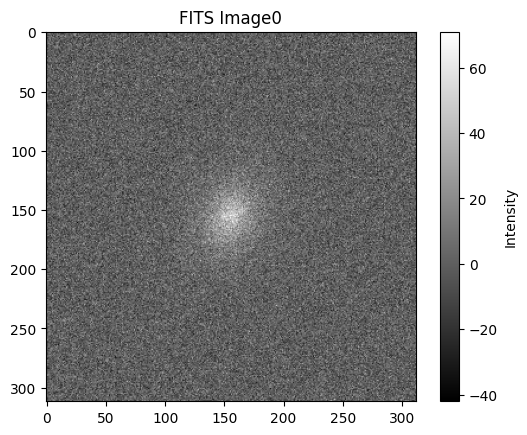

random_sim_gal/ellips0.png


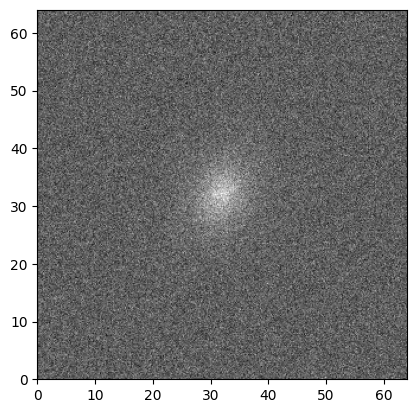

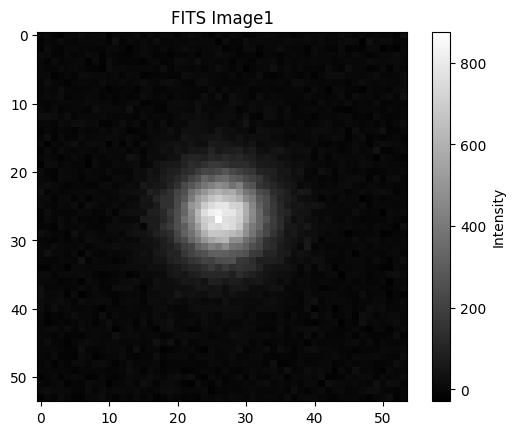

random_sim_gal/ellips1.png


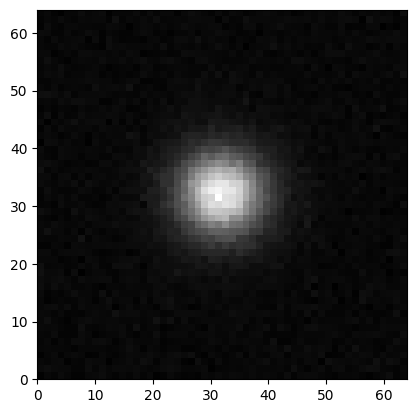

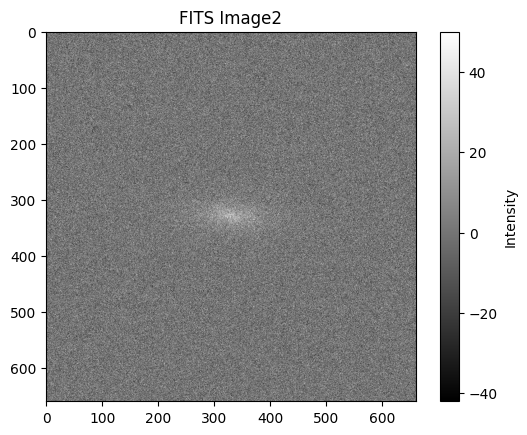

random_sim_gal/ellips2.png


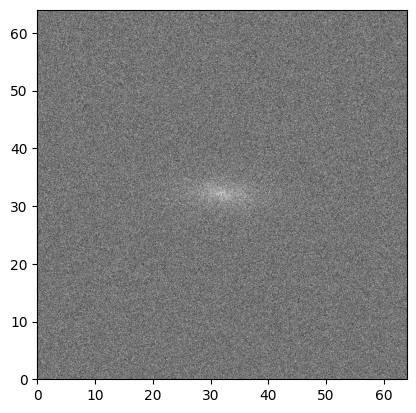

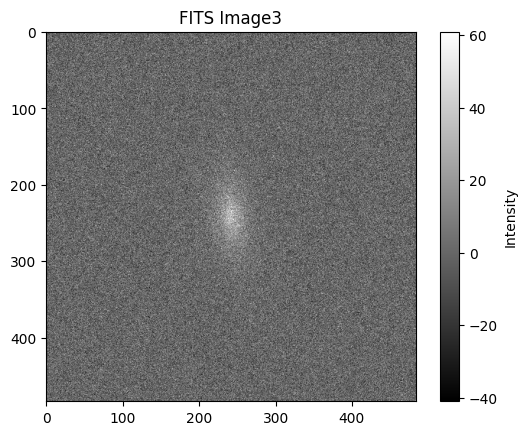

random_sim_gal/ellips3.png


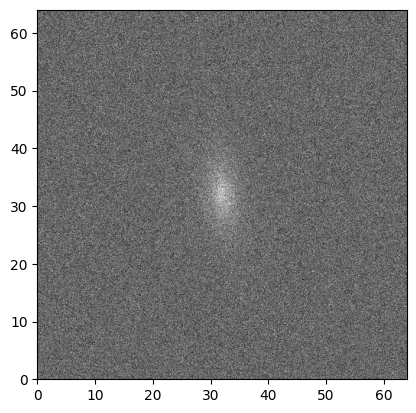

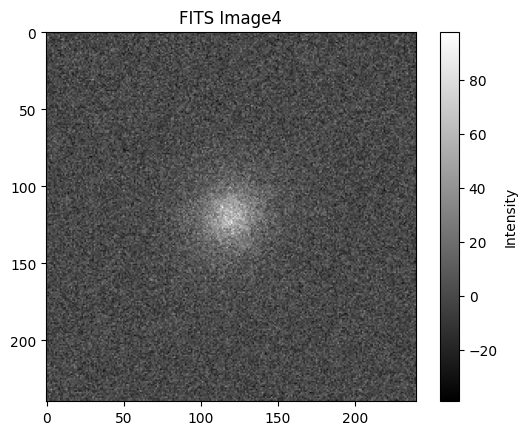

random_sim_gal/ellips4.png


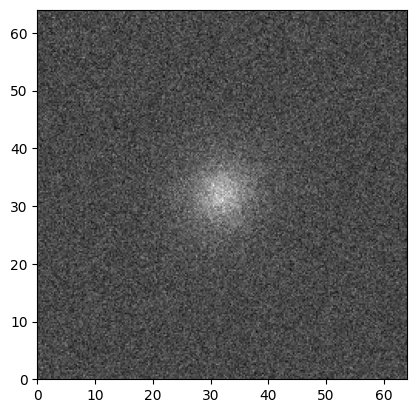

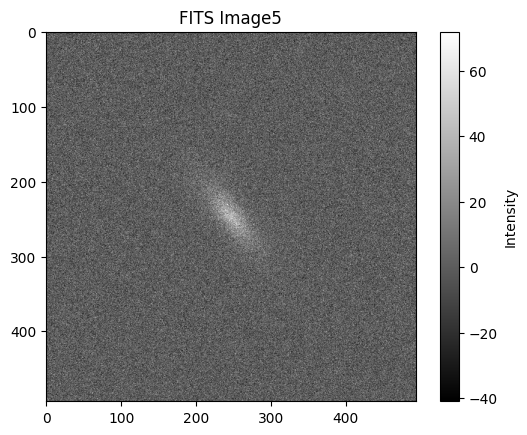

random_sim_gal/ellips5.png


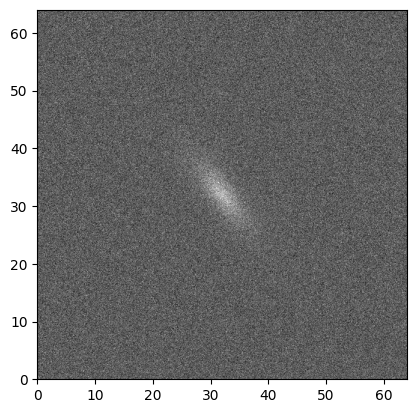

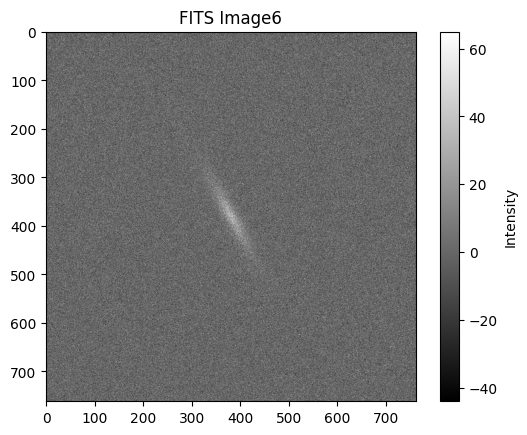

random_sim_gal/ellips6.png


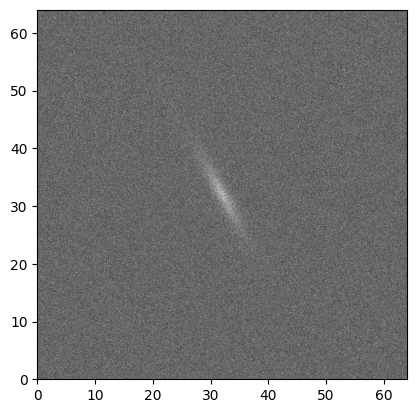

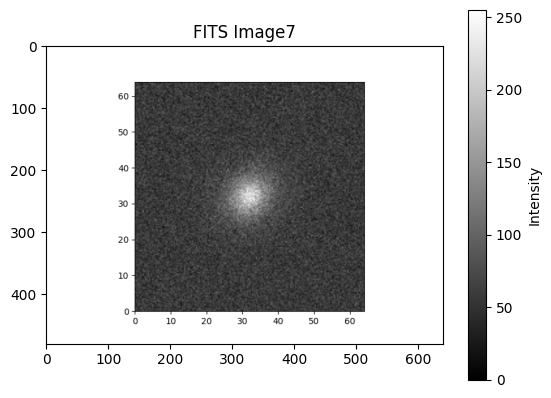

random_sim_gal/ellips7.png


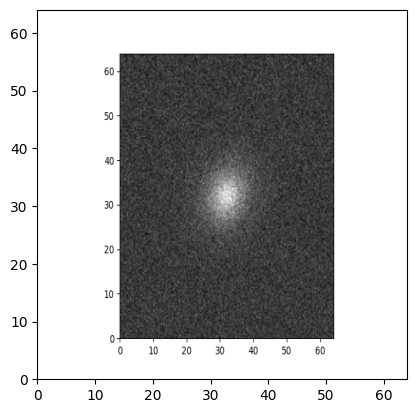

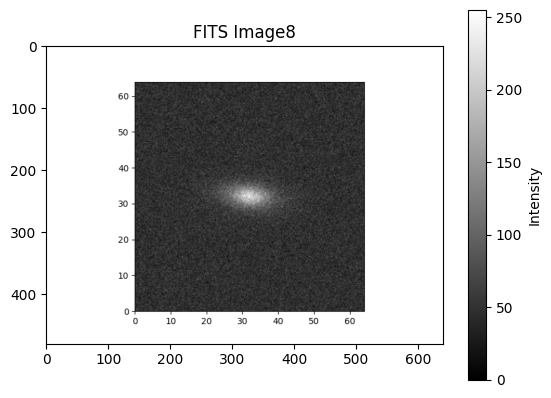

random_sim_gal/ellips8.png


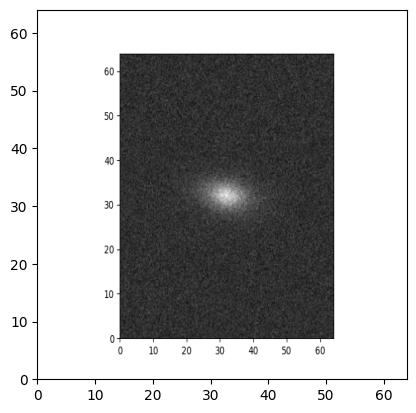

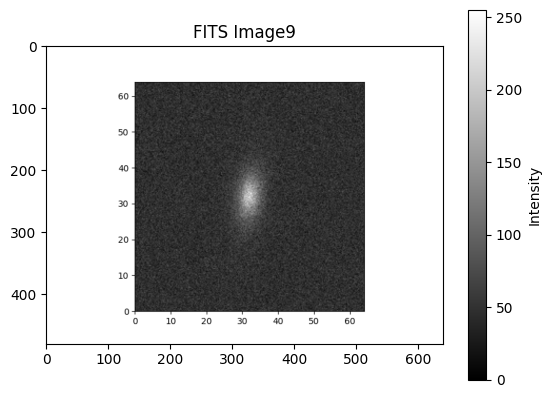

random_sim_gal/ellips9.png


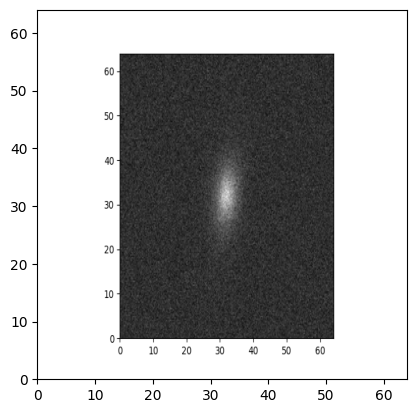

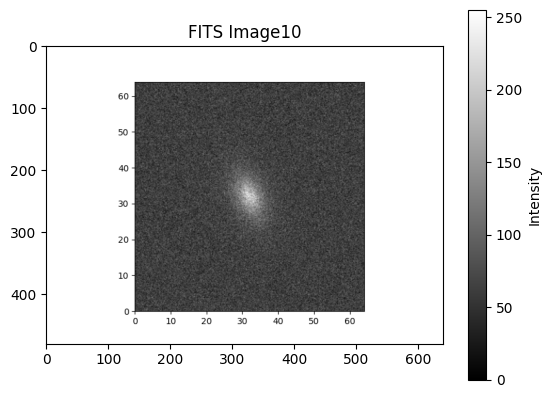

random_sim_gal/ellips10.png


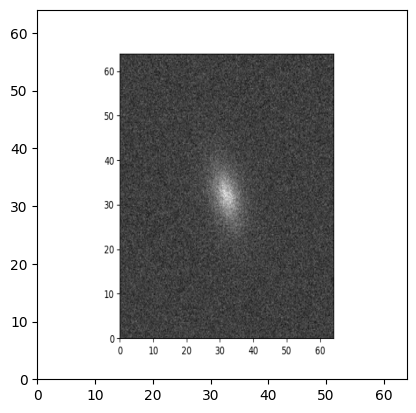

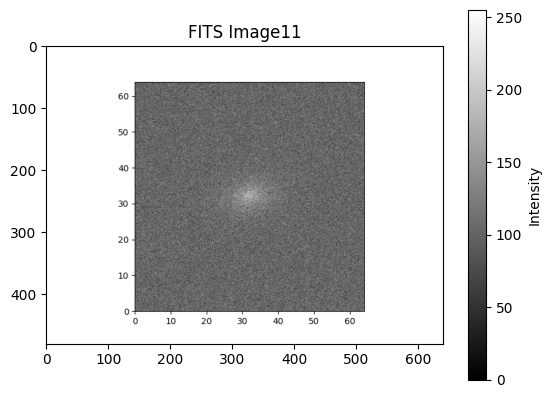

random_sim_gal/ellips11.png


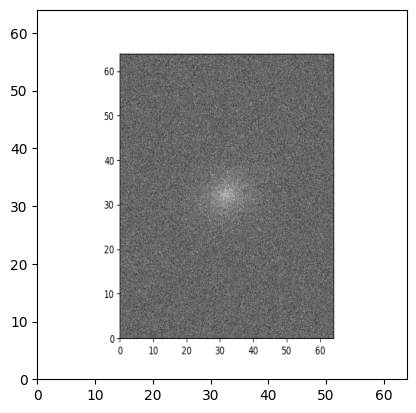

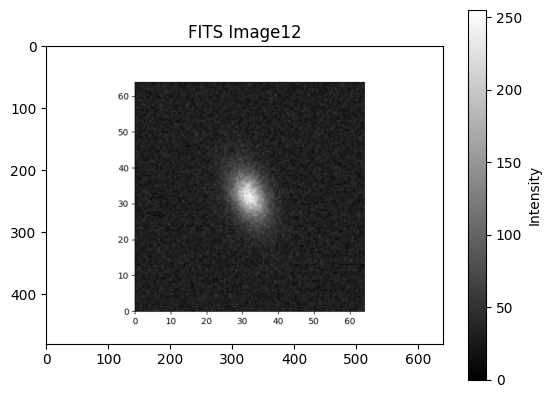

random_sim_gal/ellips12.png


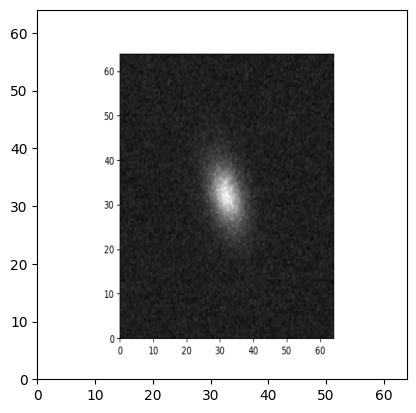

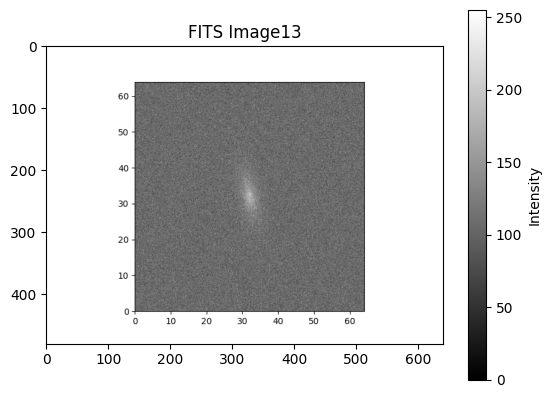

random_sim_gal/ellips13.png


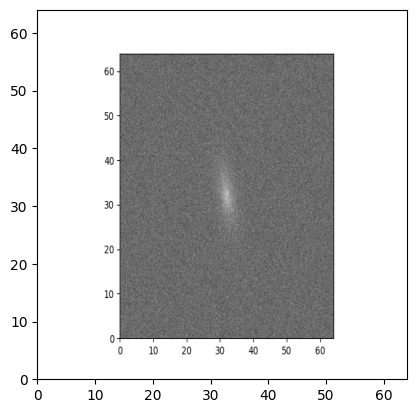

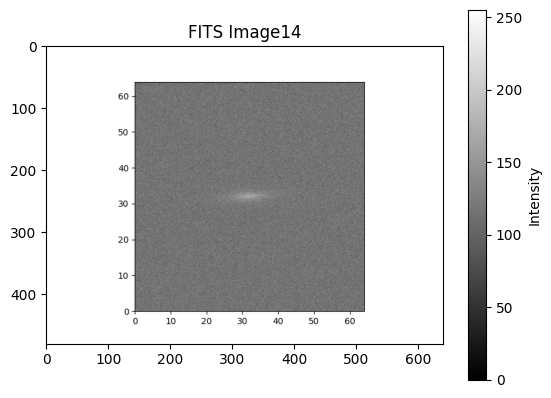

random_sim_gal/ellips14.png


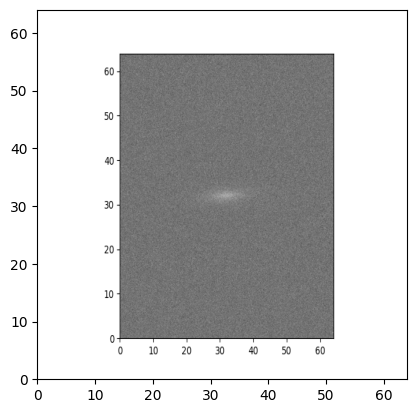

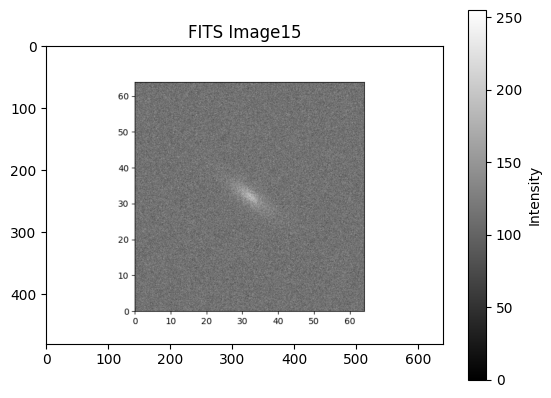

random_sim_gal/ellips15.png


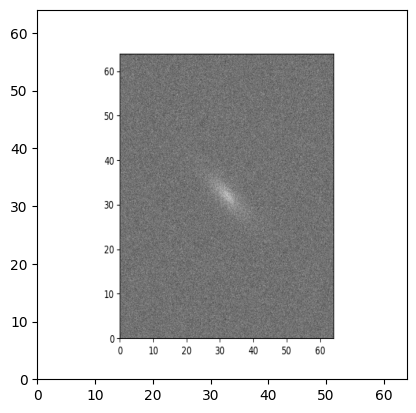

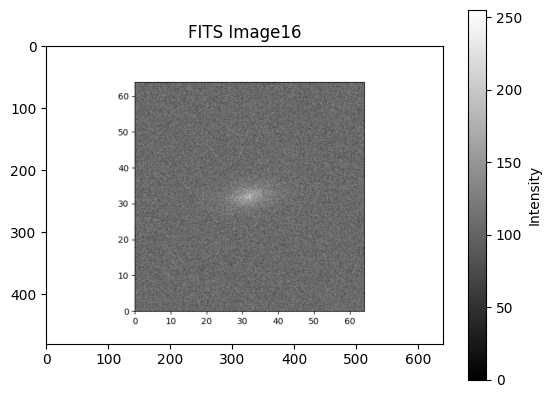

random_sim_gal/ellips16.png


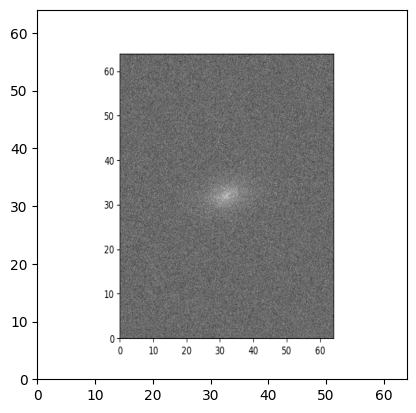

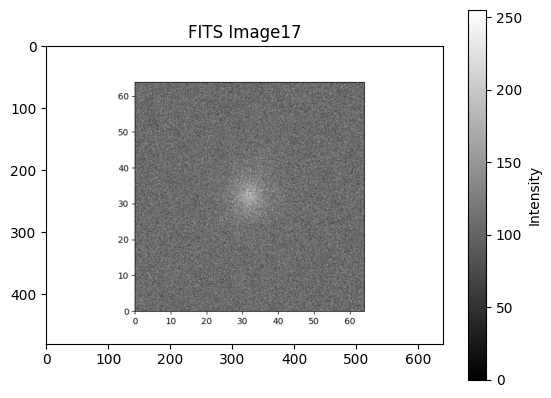

random_sim_gal/ellips17.png


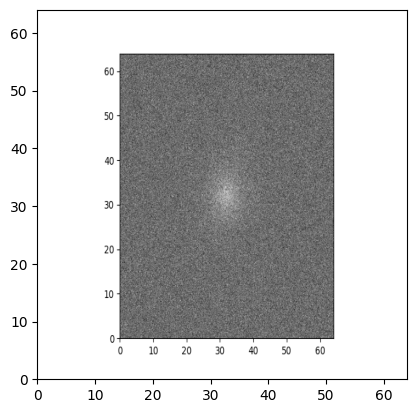

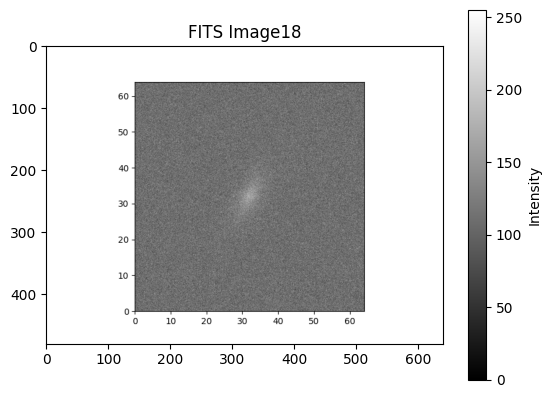

random_sim_gal/ellips18.png


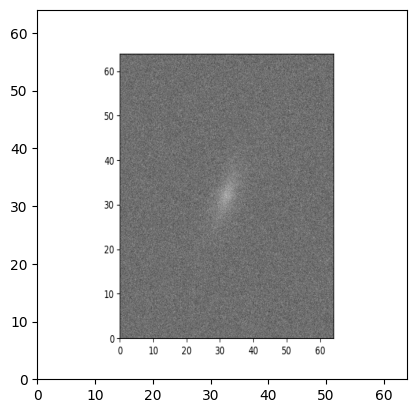

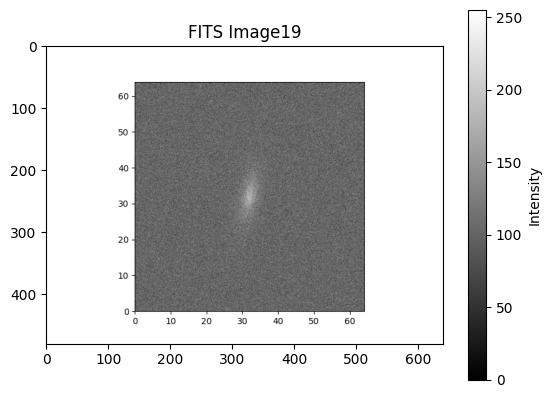

random_sim_gal/ellips19.png


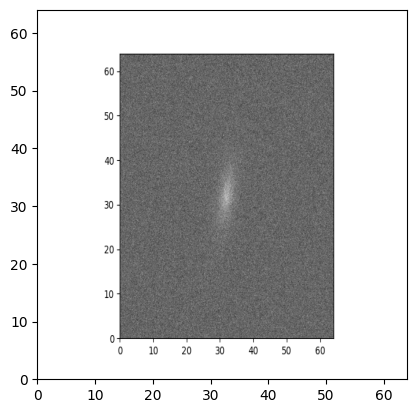

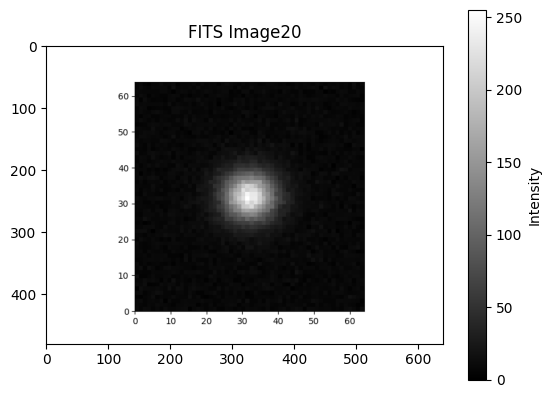

random_sim_gal/ellips20.png


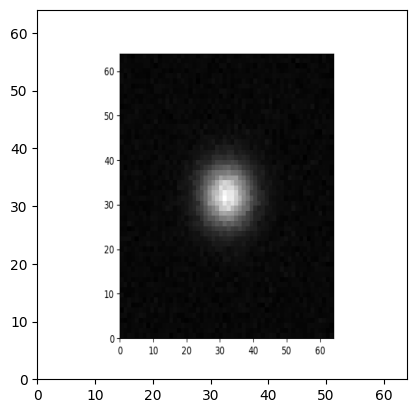

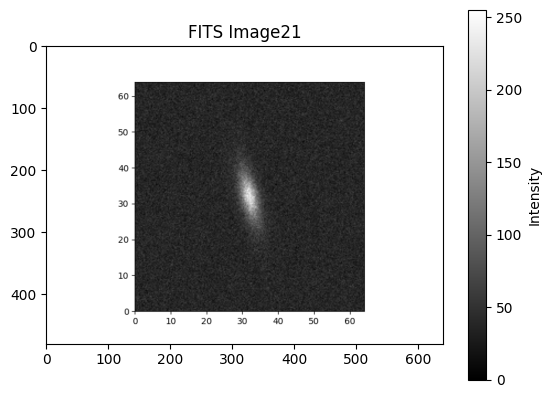

random_sim_gal/ellips21.png


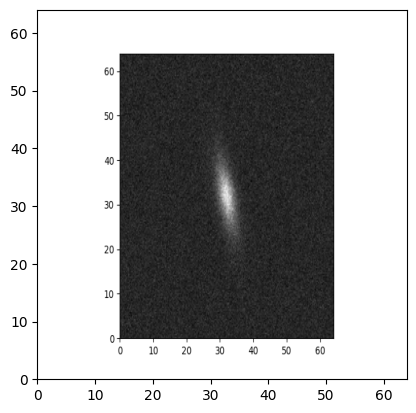

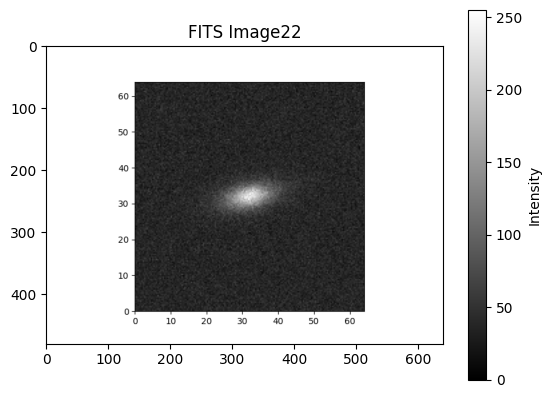

random_sim_gal/ellips22.png


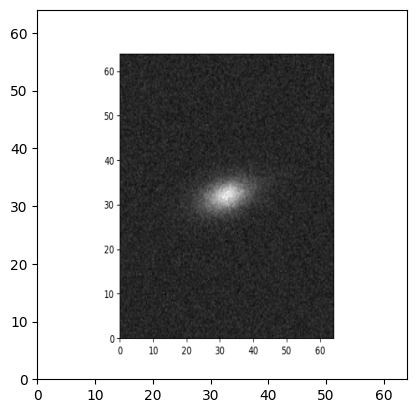

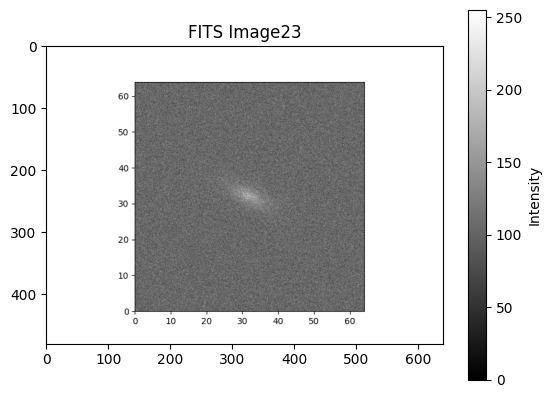

random_sim_gal/ellips23.png


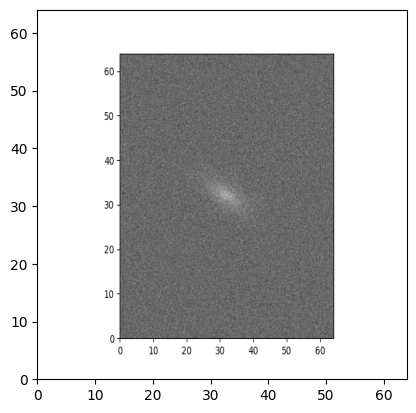

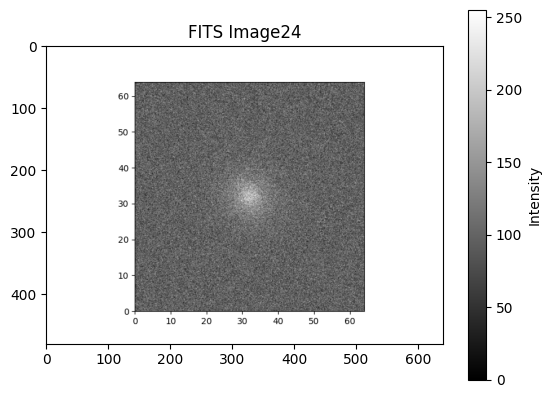

random_sim_gal/ellips24.png


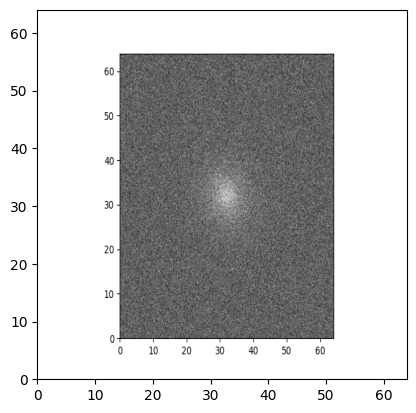

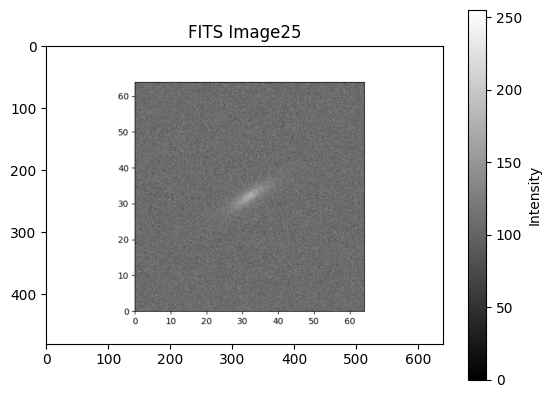

random_sim_gal/ellips25.png


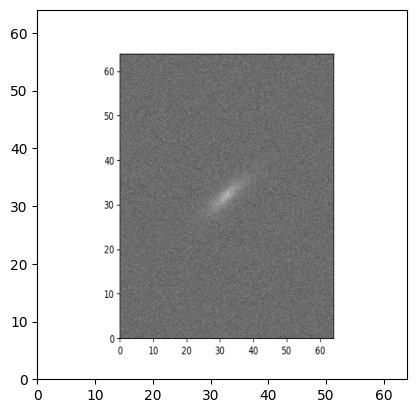

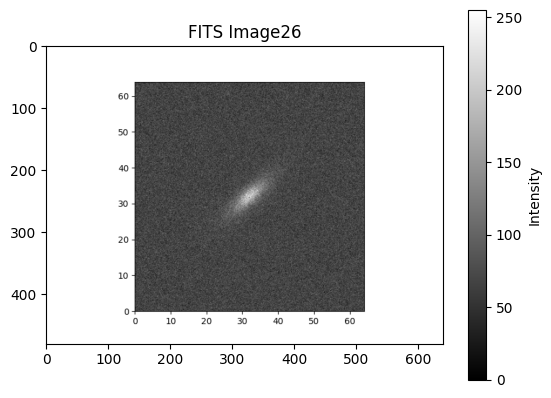

random_sim_gal/ellips26.png


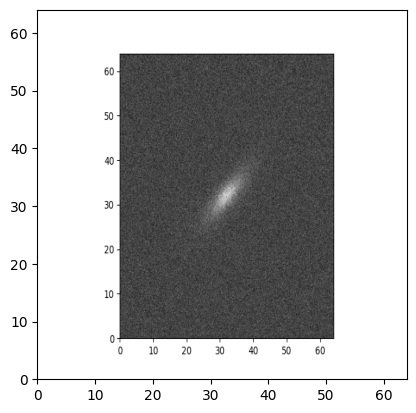

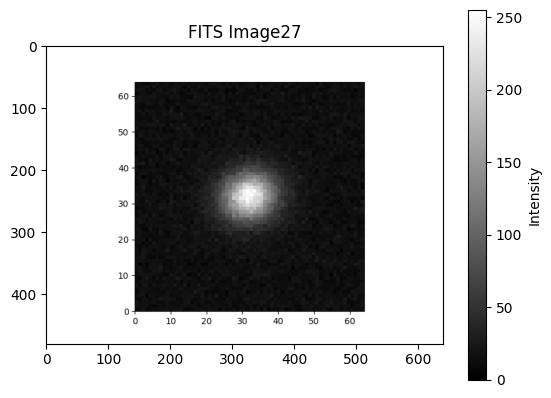

random_sim_gal/ellips27.png


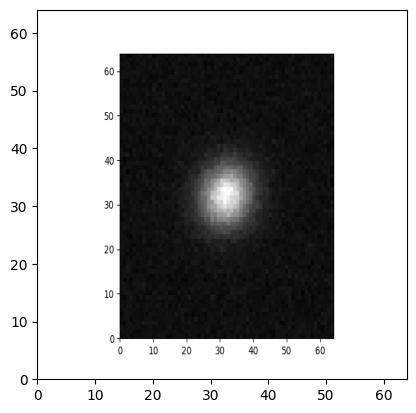

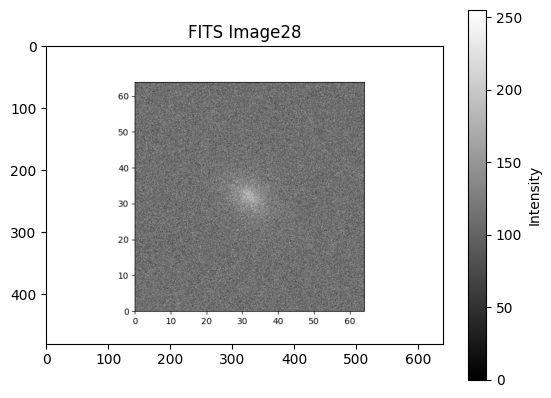

random_sim_gal/ellips28.png


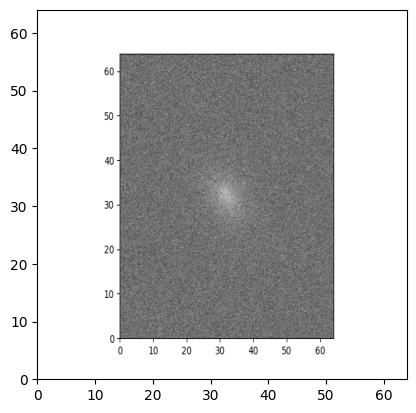

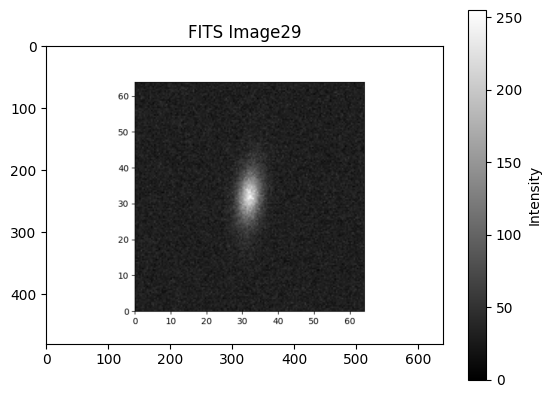

random_sim_gal/ellips29.png


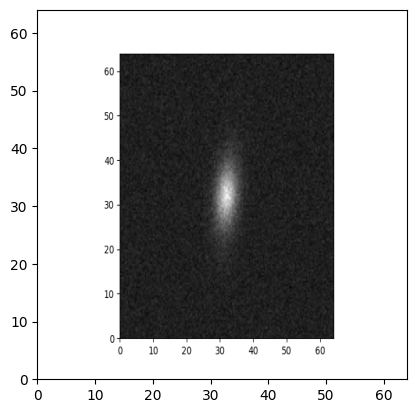

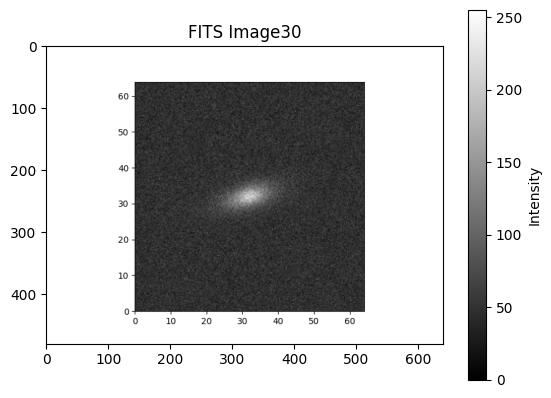

random_sim_gal/ellips30.png


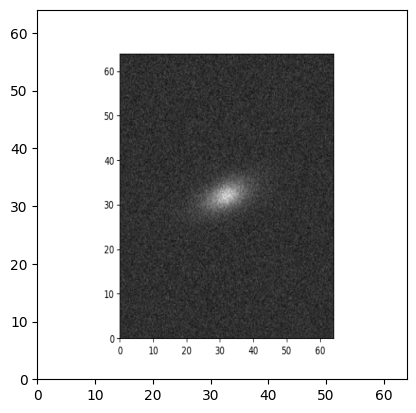

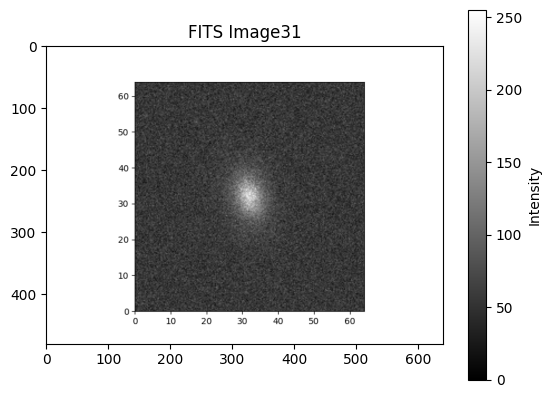

random_sim_gal/ellips31.png


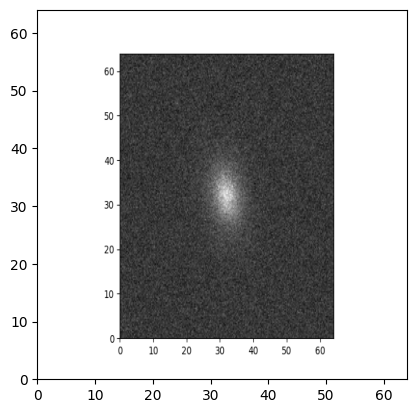

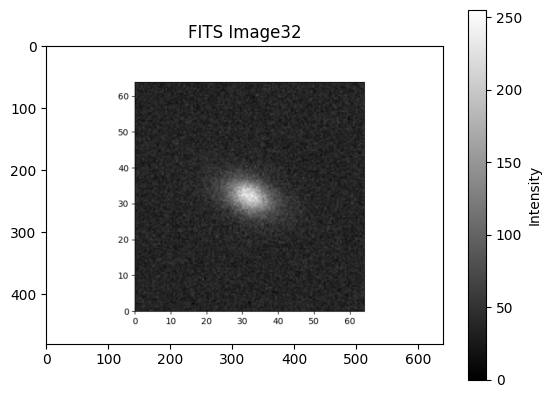

random_sim_gal/ellips32.png


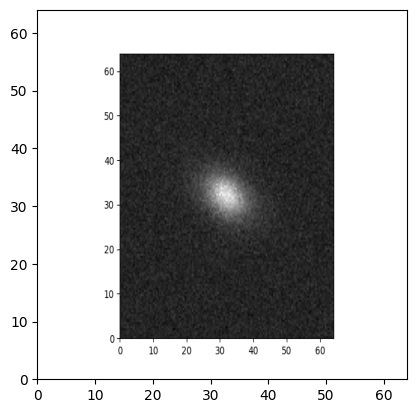

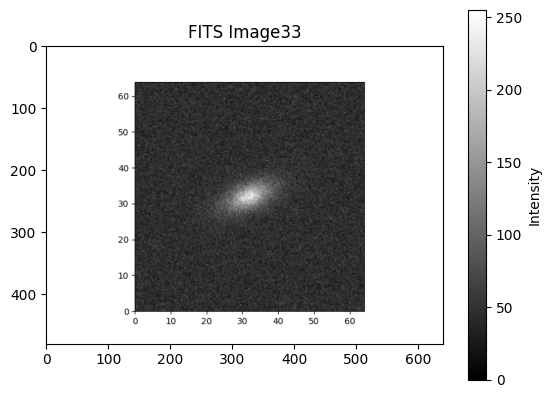

random_sim_gal/ellips33.png


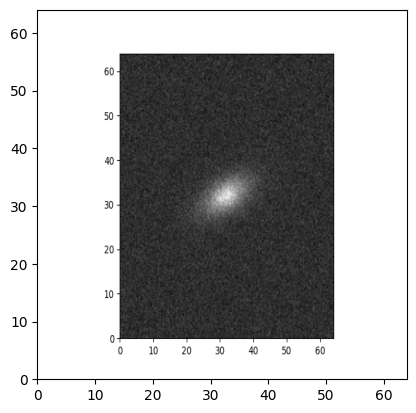

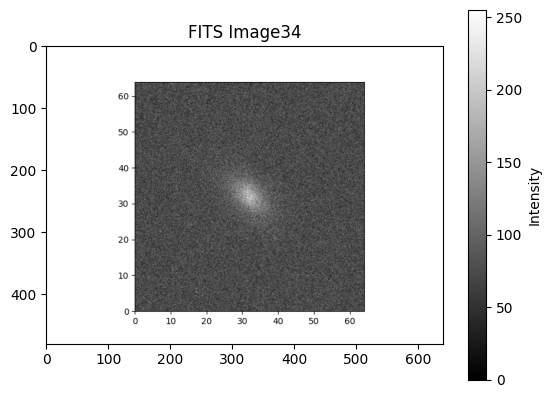

random_sim_gal/ellips34.png


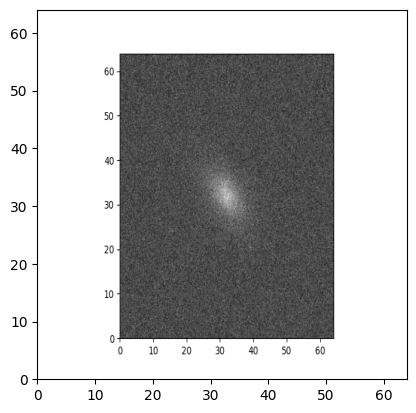

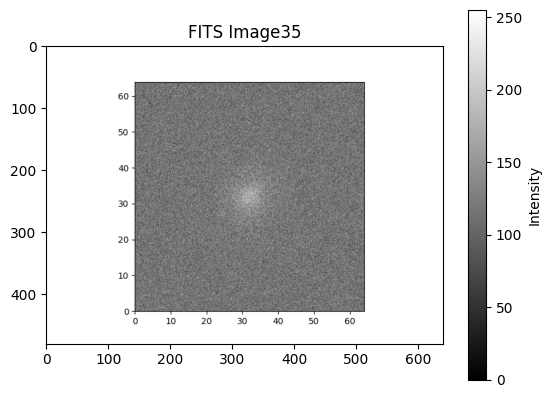

random_sim_gal/ellips35.png


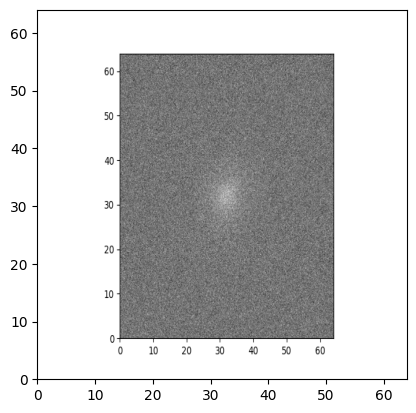

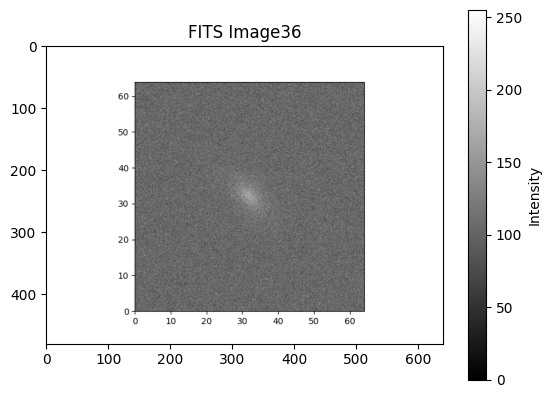

random_sim_gal/ellips36.png


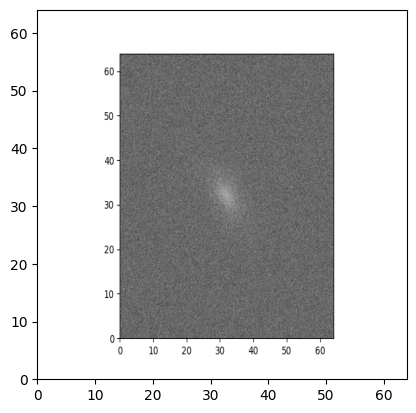

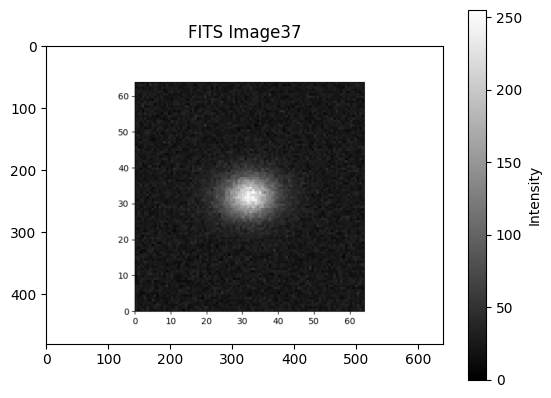

random_sim_gal/ellips37.png


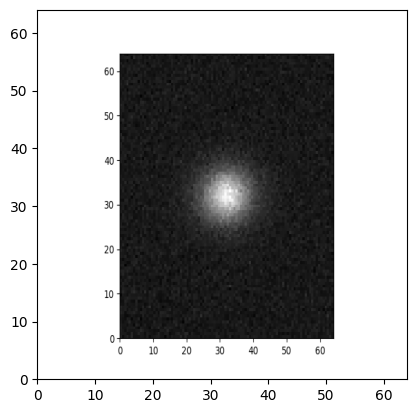

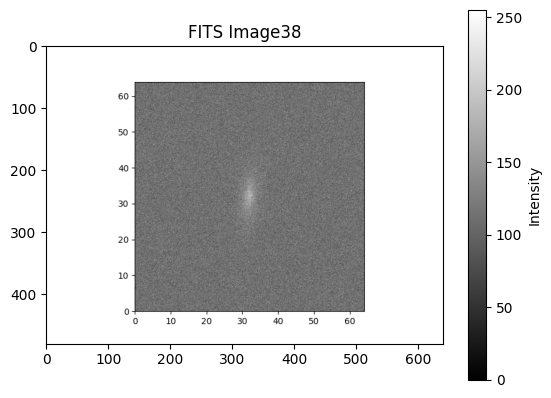

random_sim_gal/ellips38.png


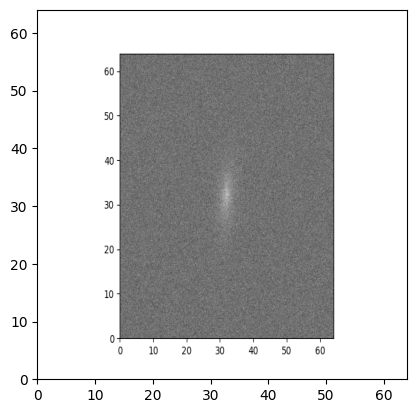

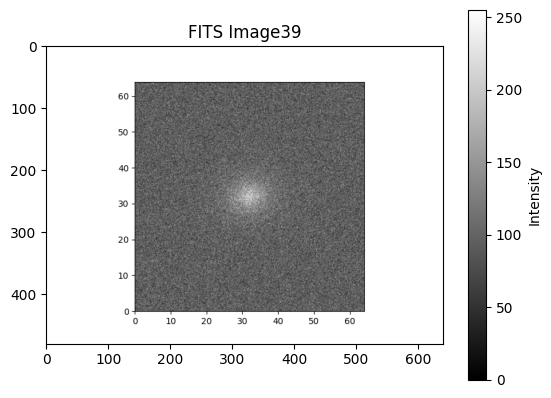

random_sim_gal/ellips39.png


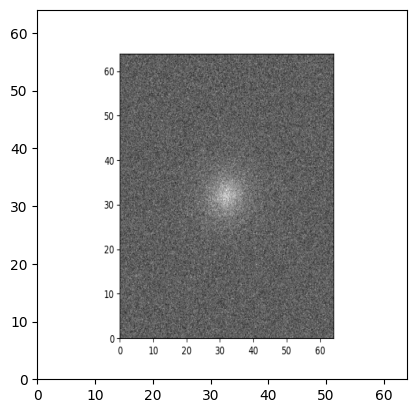

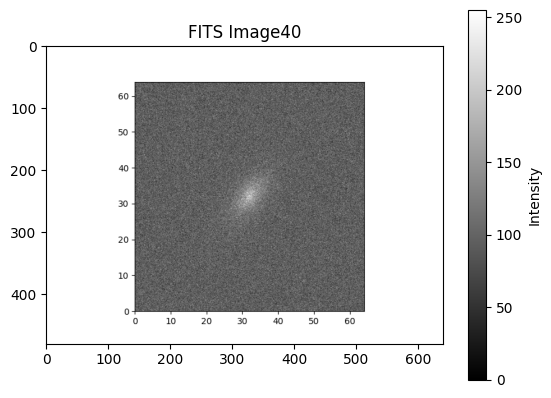

random_sim_gal/ellips40.png


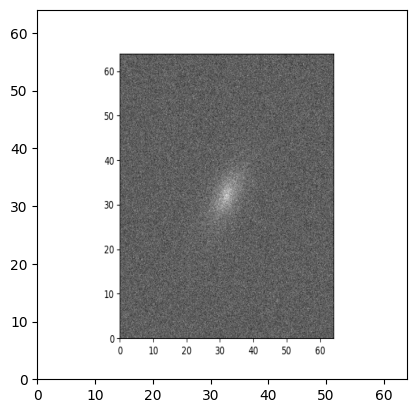

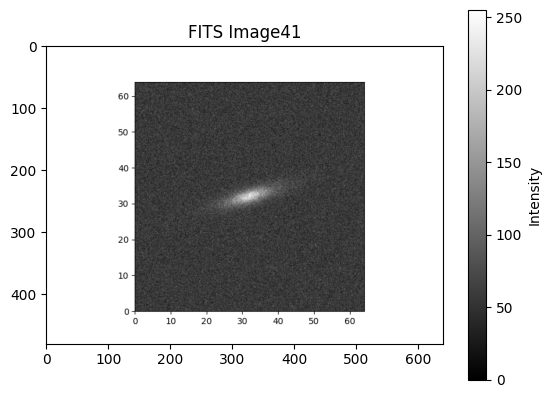

random_sim_gal/ellips41.png


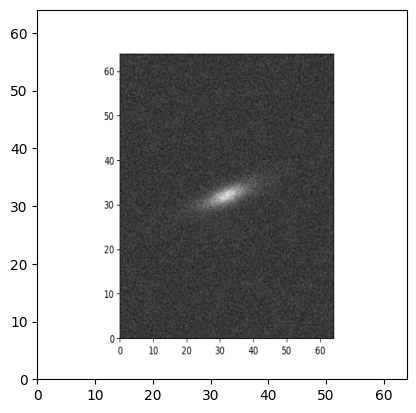

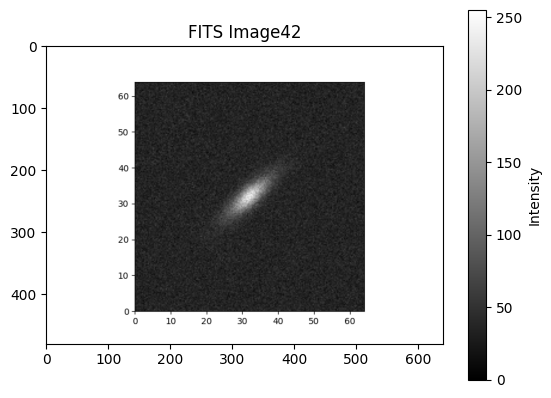

random_sim_gal/ellips42.png


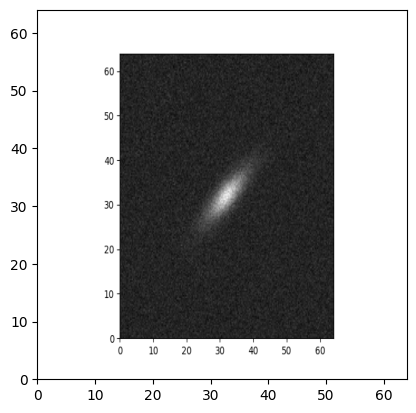

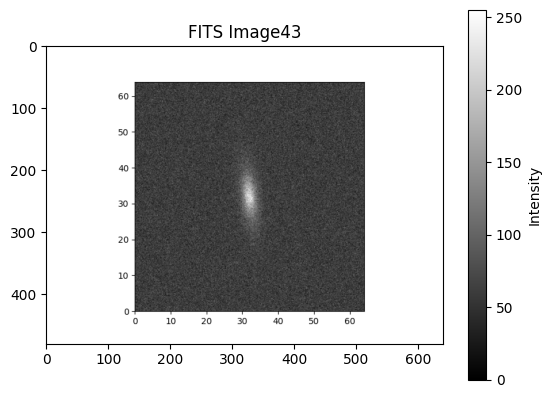

random_sim_gal/ellips43.png


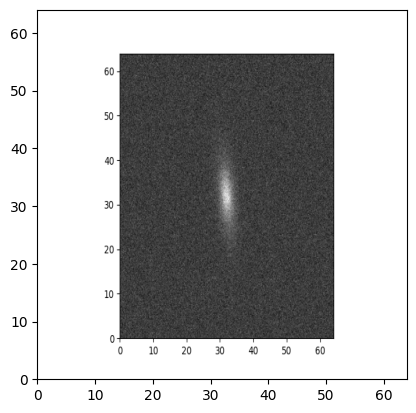

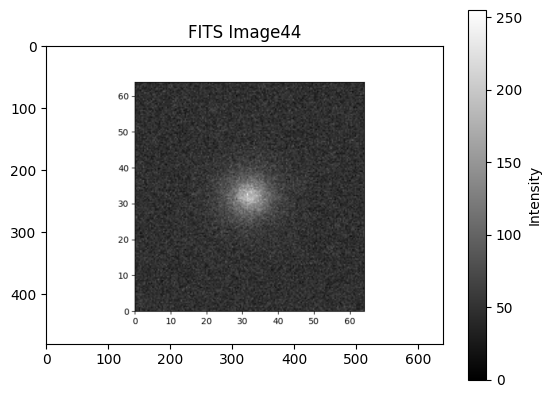

random_sim_gal/ellips44.png


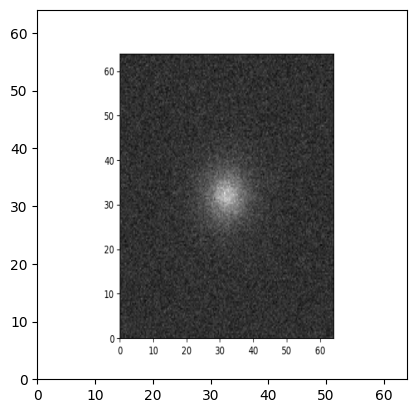

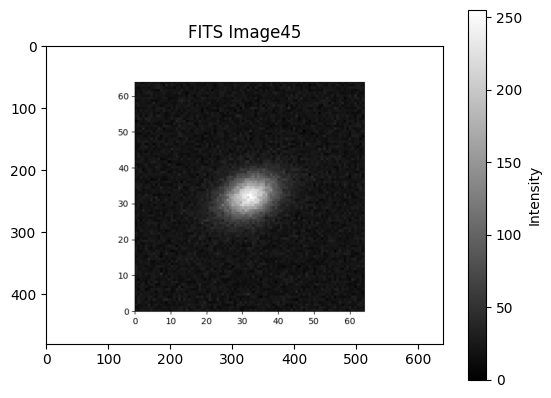

random_sim_gal/ellips45.png


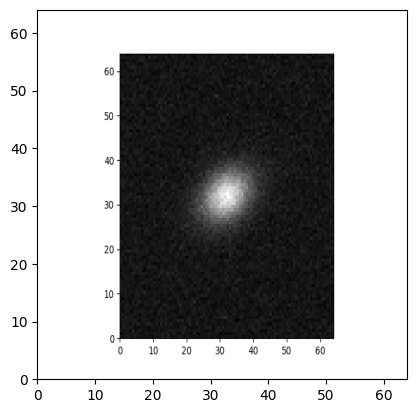

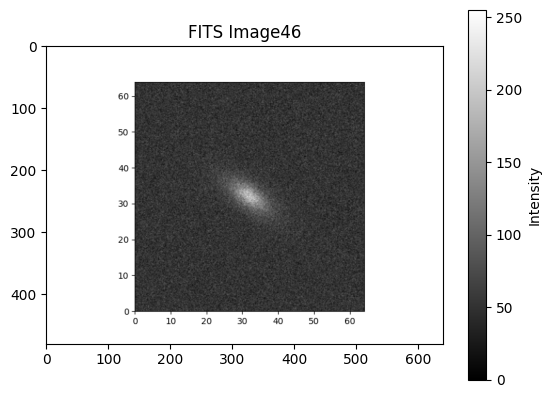

random_sim_gal/ellips46.png


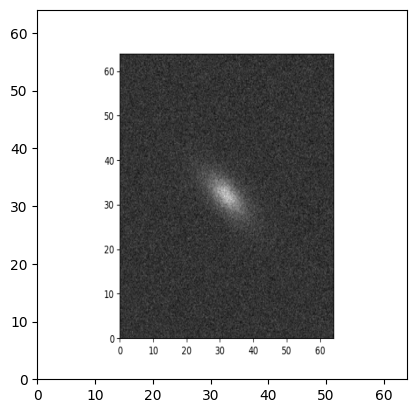

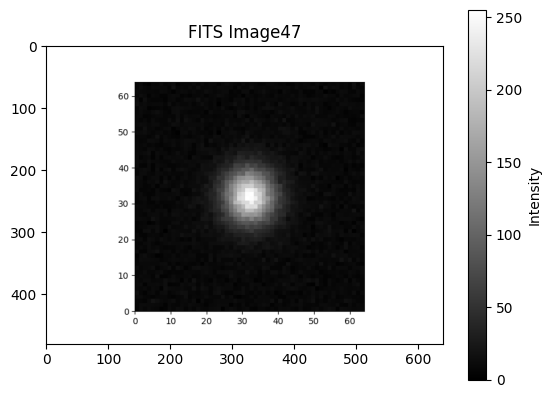

random_sim_gal/ellips47.png


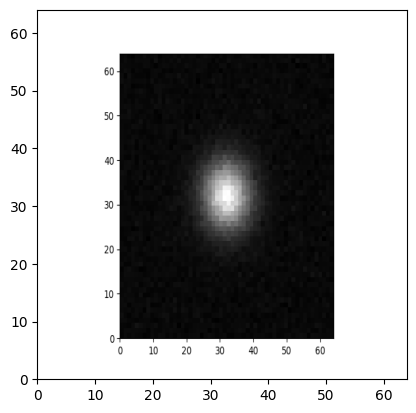

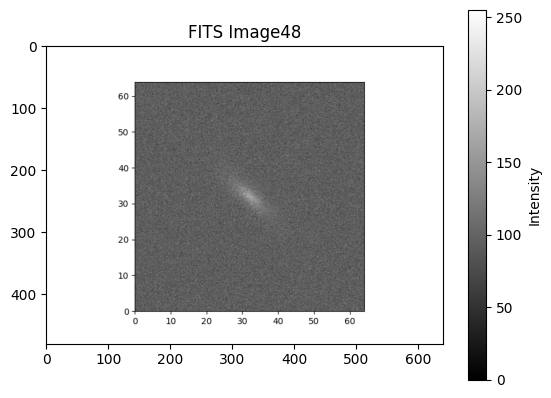

random_sim_gal/ellips48.png


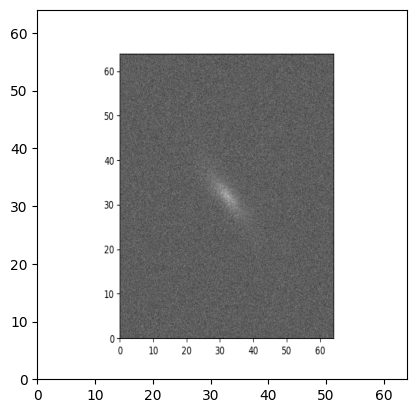

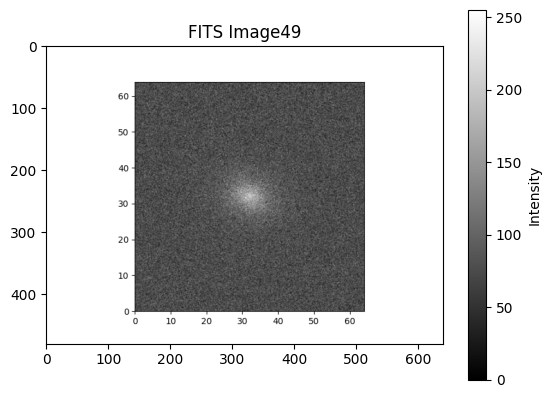

random_sim_gal/ellips49.png


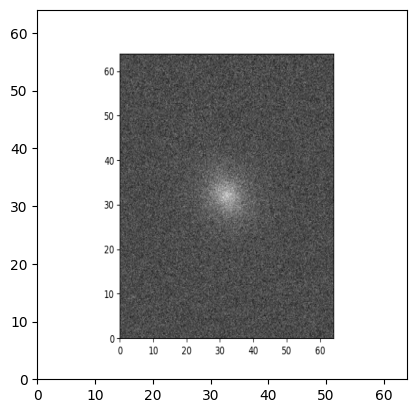

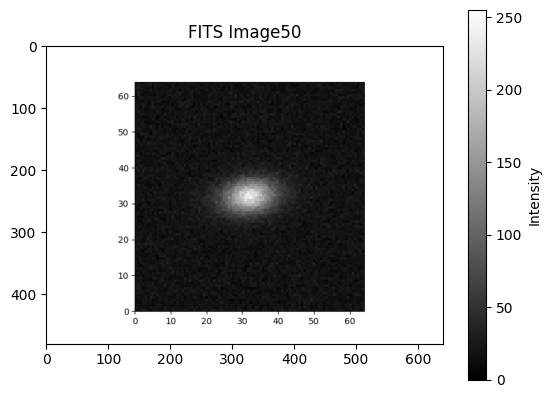

random_sim_gal/ellips50.png


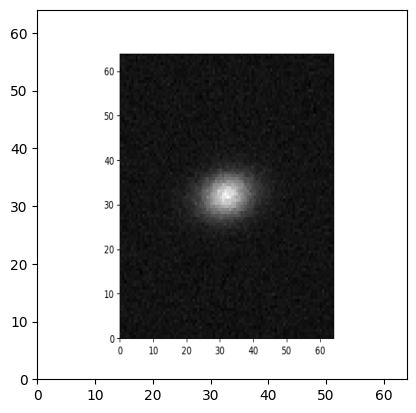

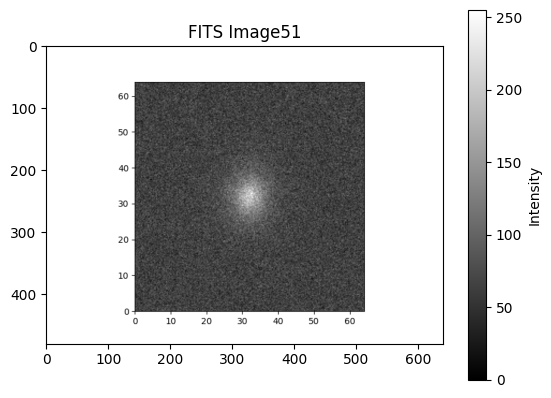

random_sim_gal/ellips51.png


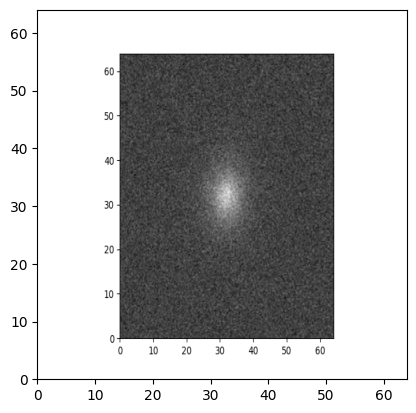

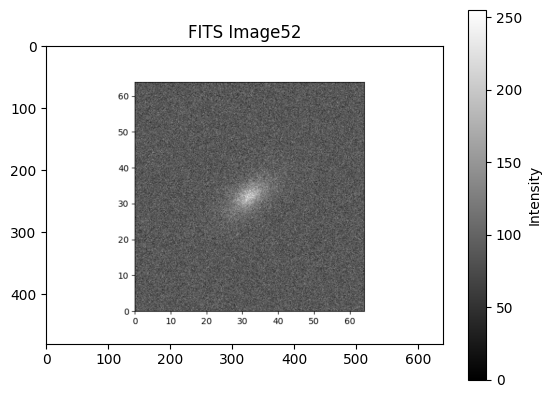

random_sim_gal/ellips52.png


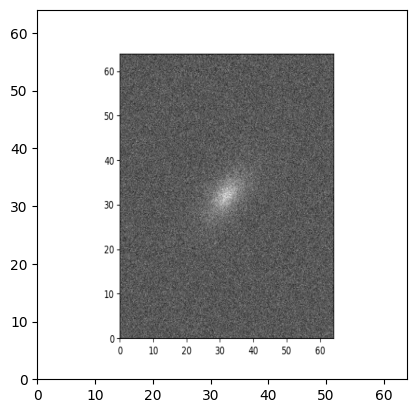

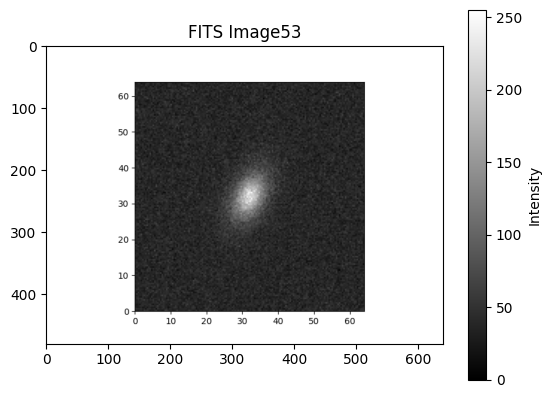

random_sim_gal/ellips53.png


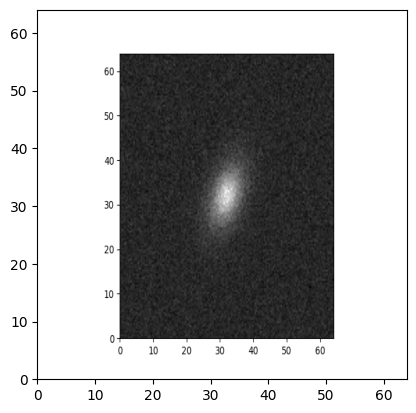

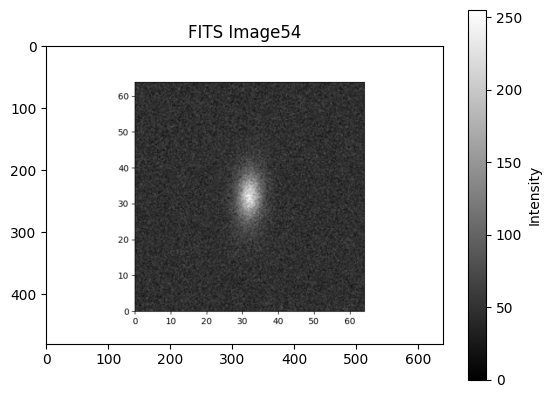

random_sim_gal/ellips54.png


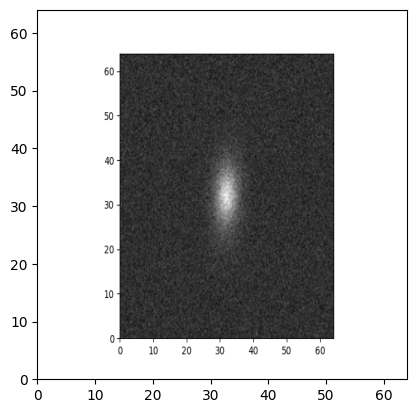

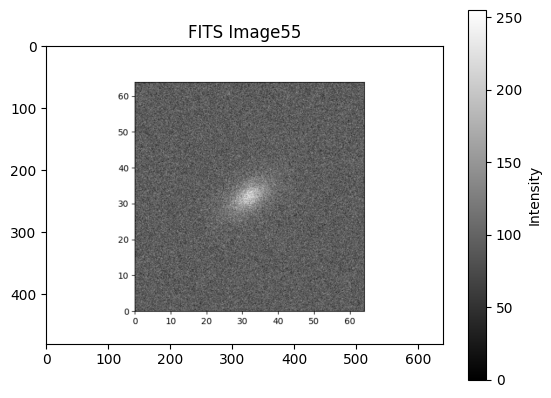

random_sim_gal/ellips55.png


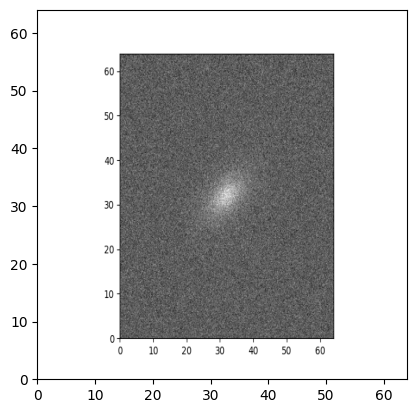

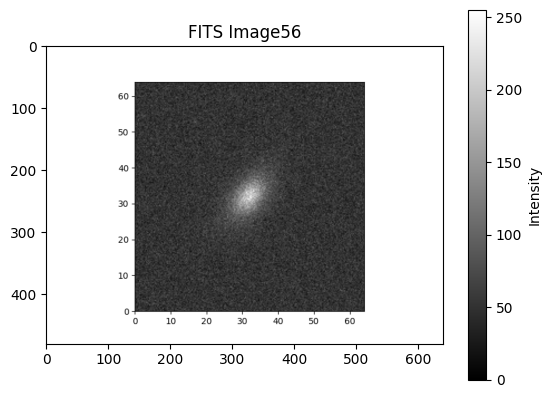

random_sim_gal/ellips56.png


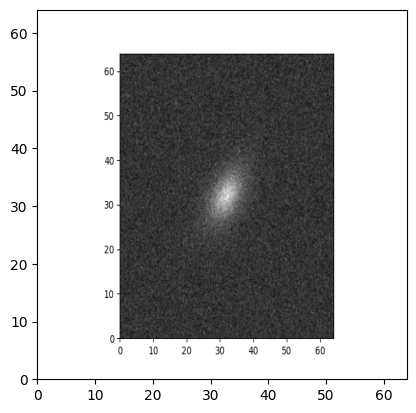

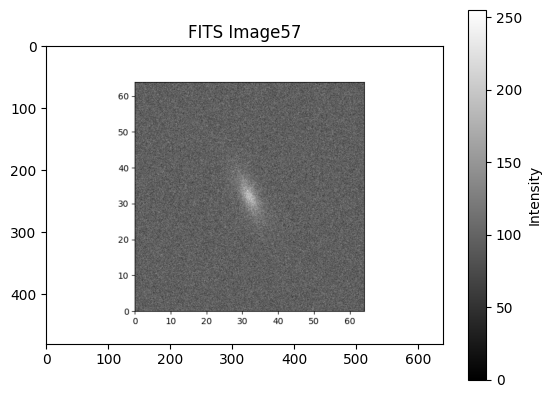

random_sim_gal/ellips57.png


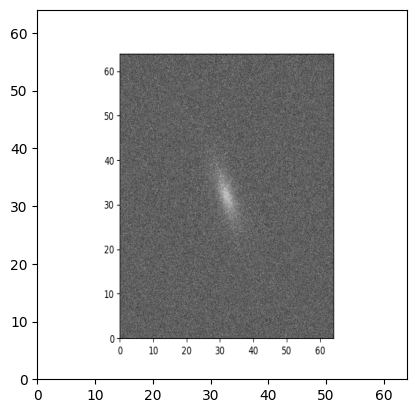

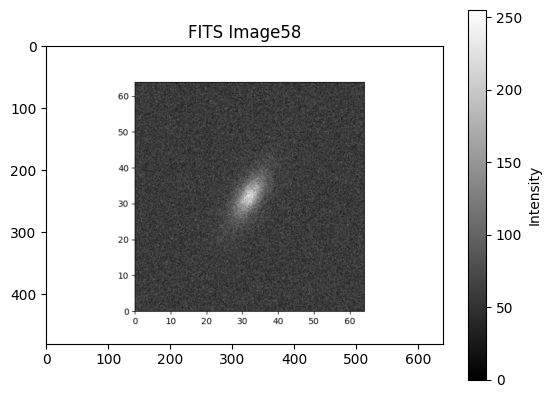

random_sim_gal/ellips58.png


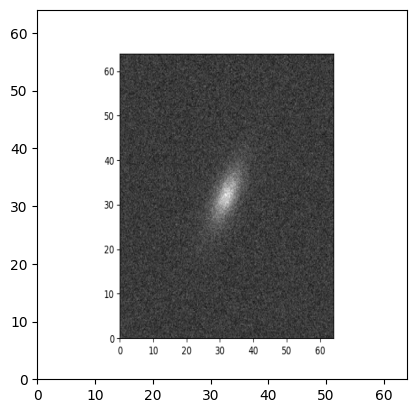

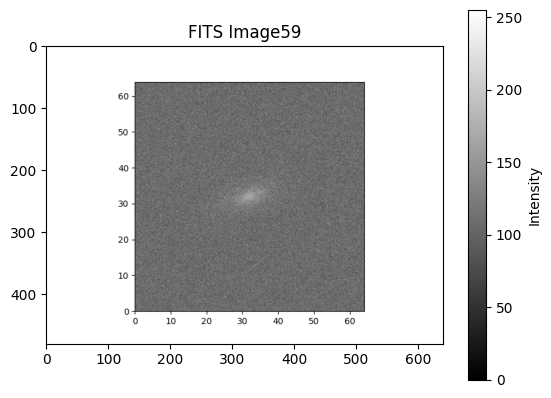

random_sim_gal/ellips59.png


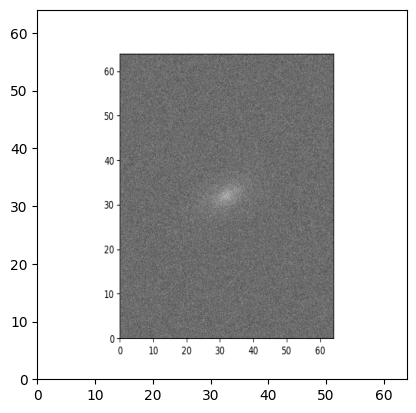

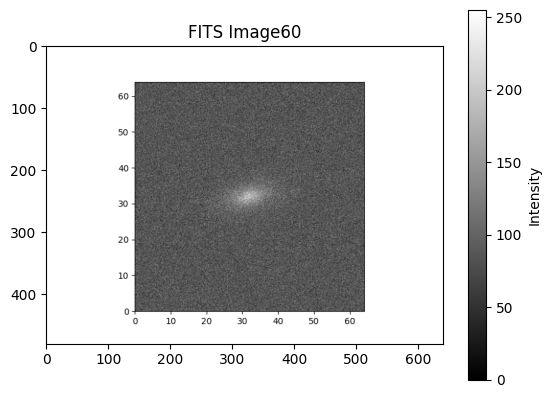

random_sim_gal/ellips60.png


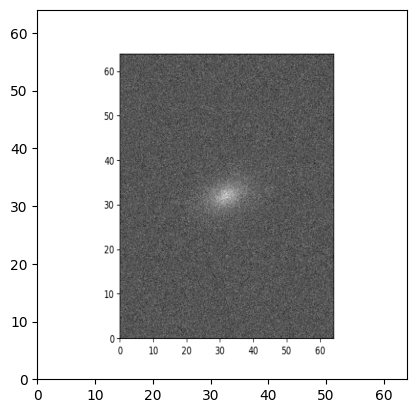

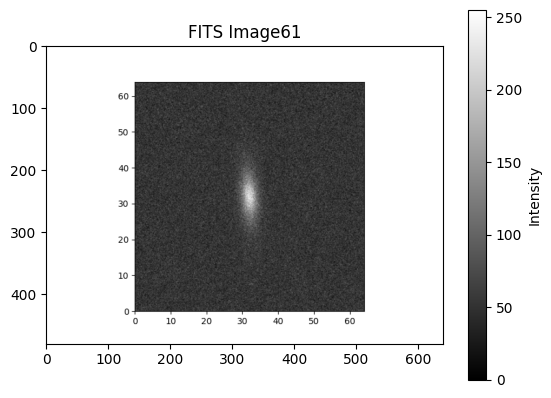

random_sim_gal/ellips61.png


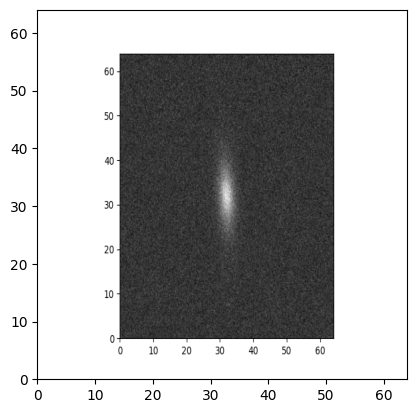

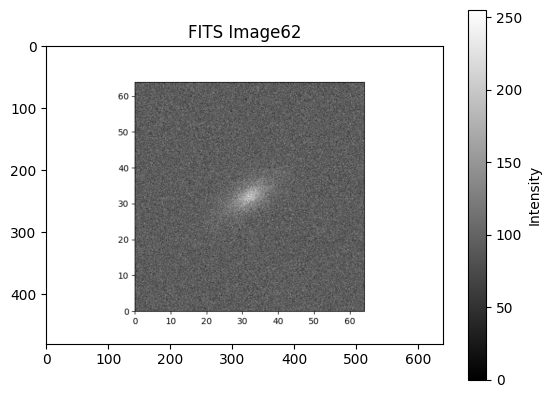

random_sim_gal/ellips62.png


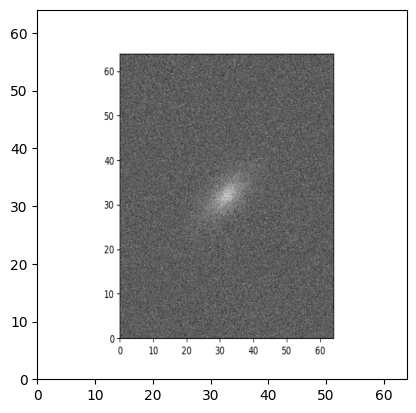

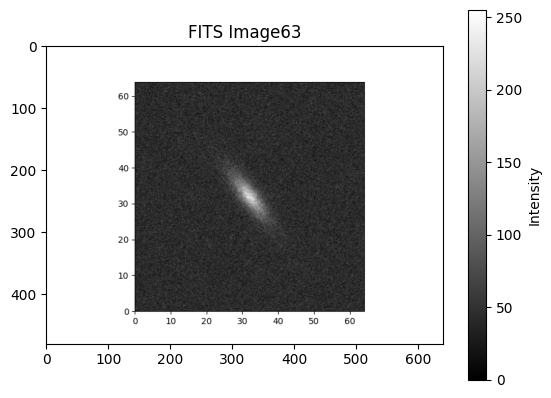

random_sim_gal/ellips63.png


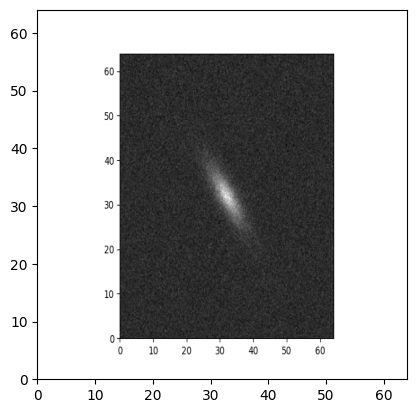

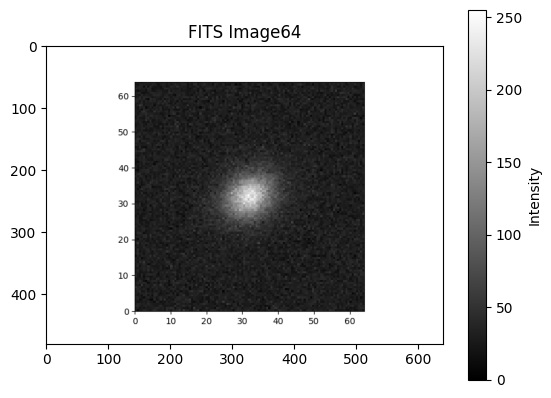

random_sim_gal/ellips64.png


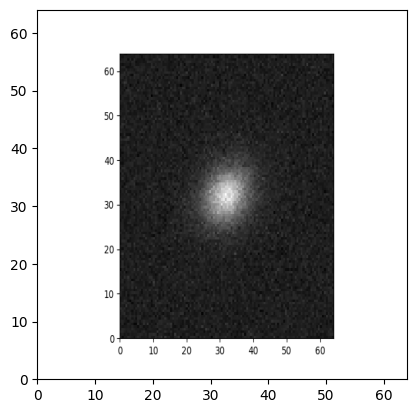

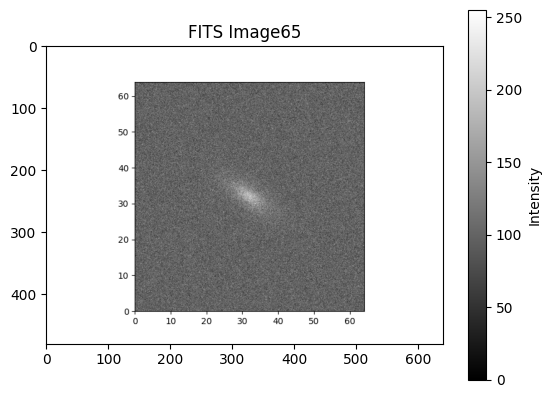

random_sim_gal/ellips65.png


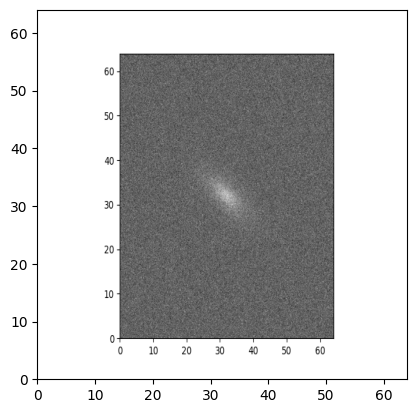

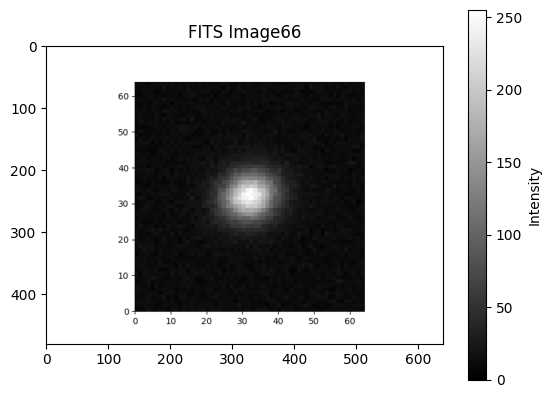

random_sim_gal/ellips66.png


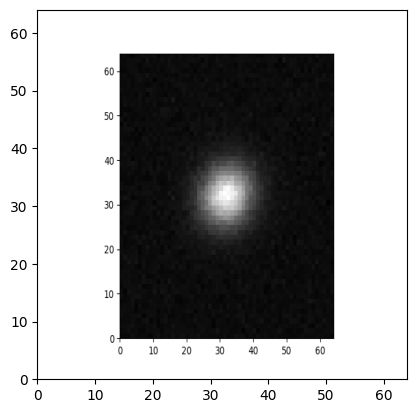

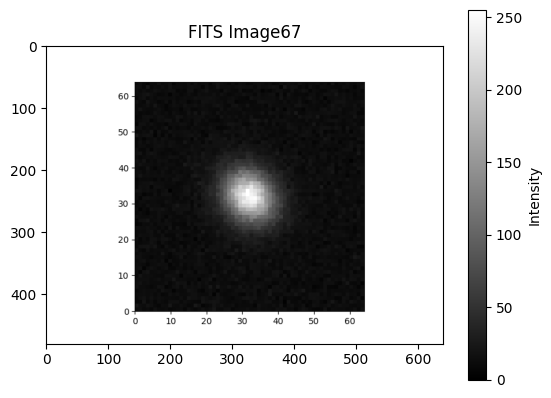

random_sim_gal/ellips67.png


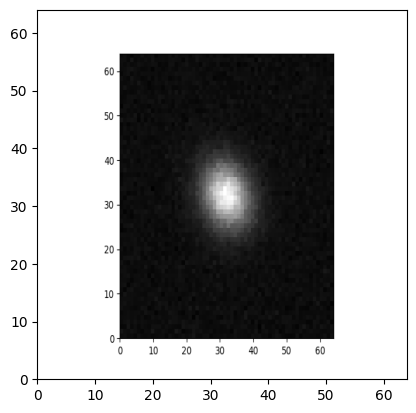

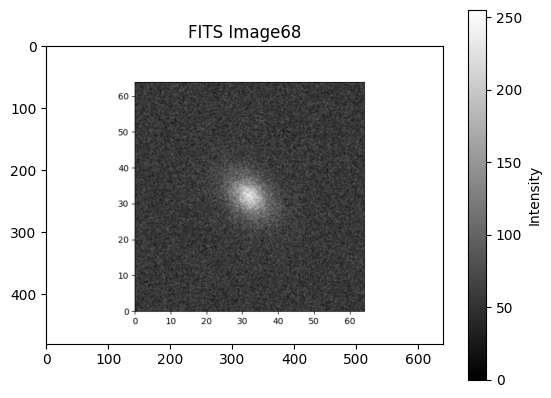

random_sim_gal/ellips68.png


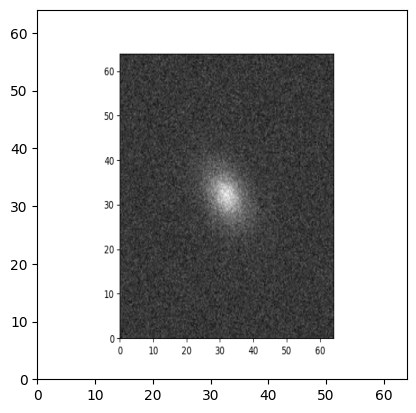

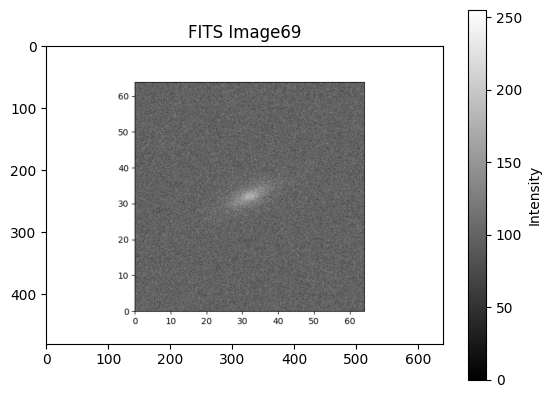

random_sim_gal/ellips69.png


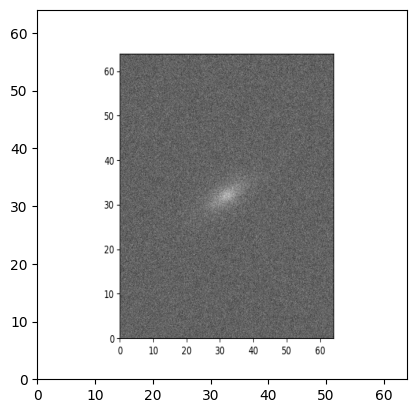

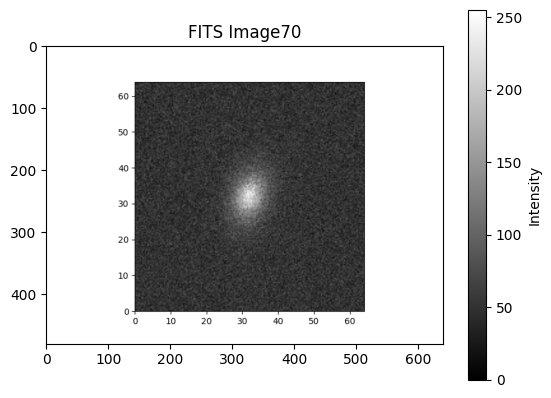

random_sim_gal/ellips70.png


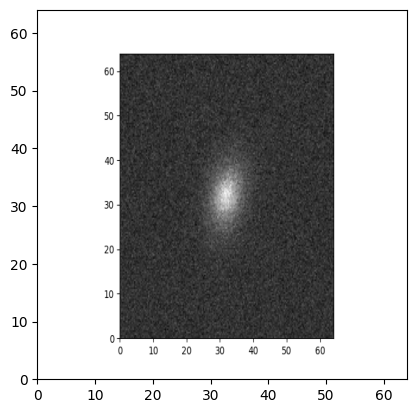

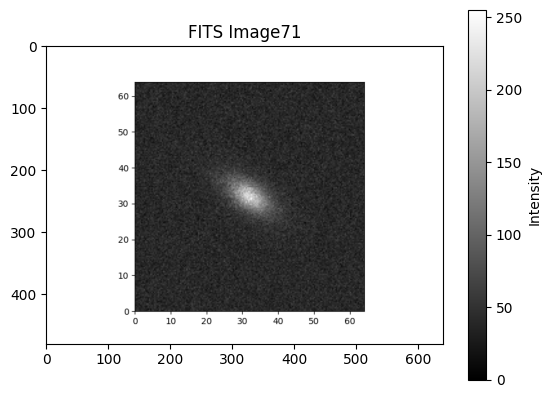

random_sim_gal/ellips71.png


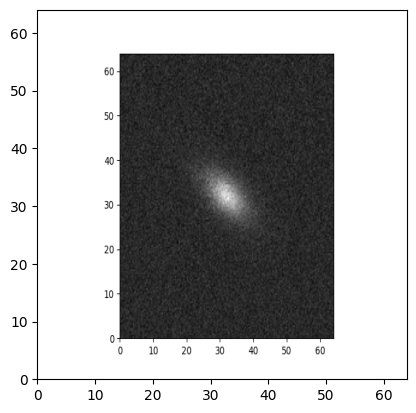

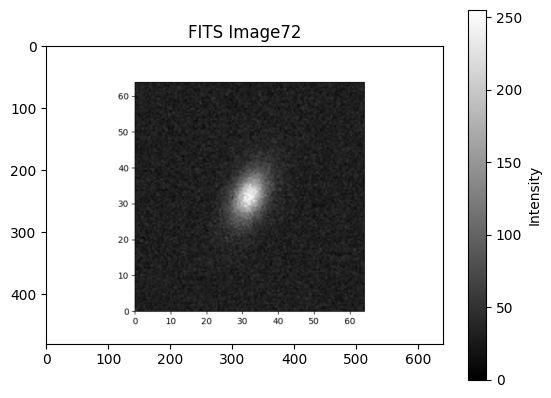

random_sim_gal/ellips72.png


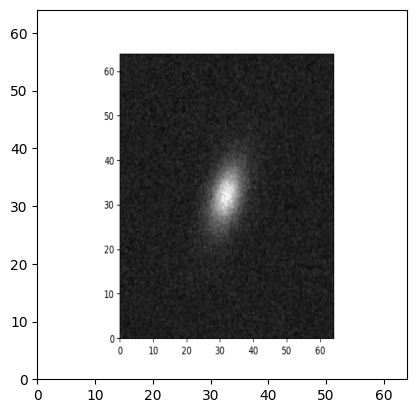

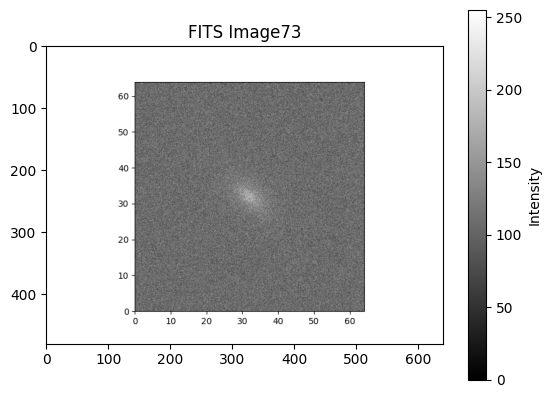

random_sim_gal/ellips73.png


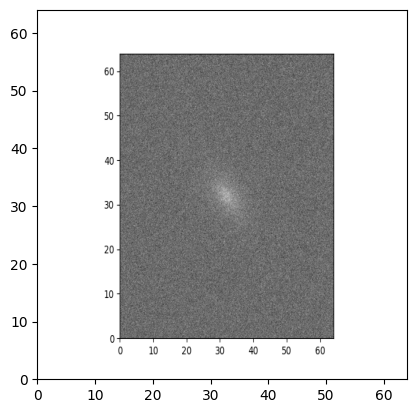

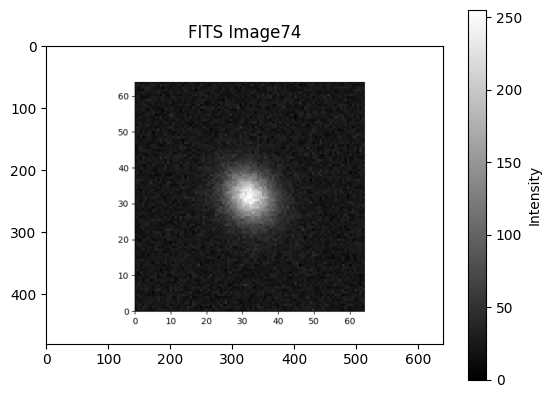

random_sim_gal/ellips74.png


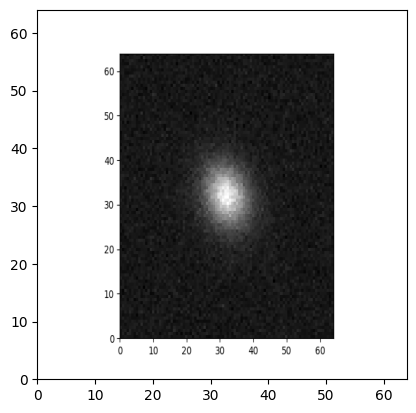

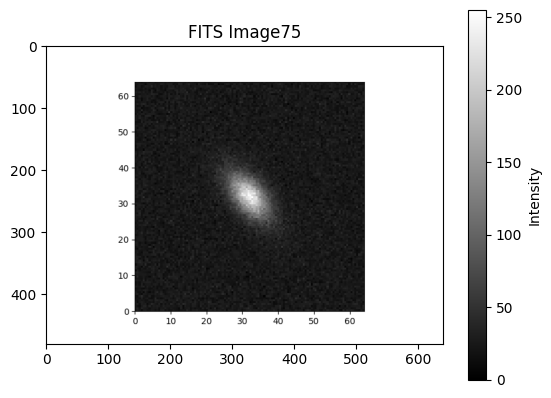

random_sim_gal/ellips75.png


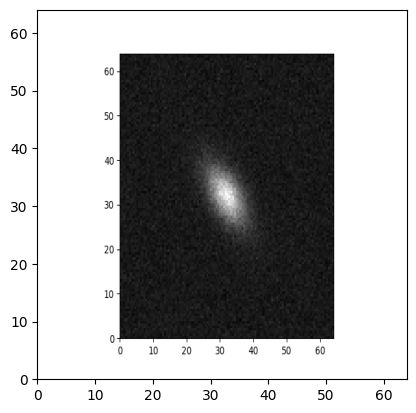

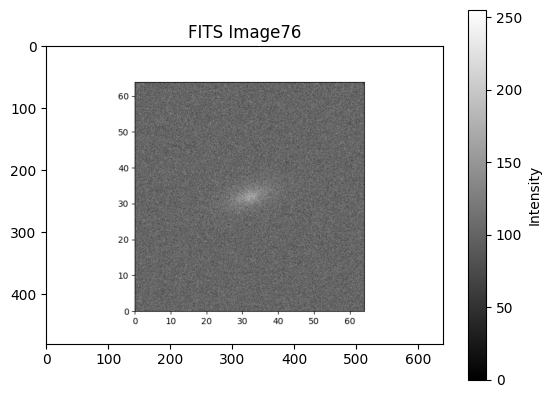

random_sim_gal/ellips76.png


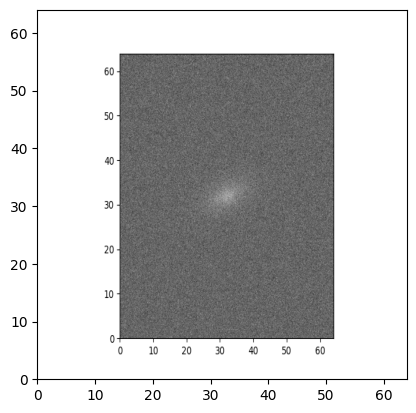

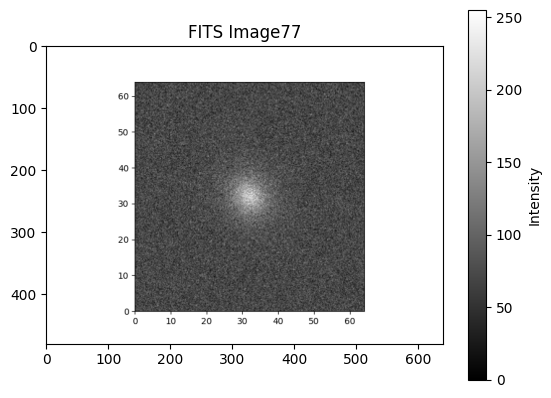

random_sim_gal/ellips77.png


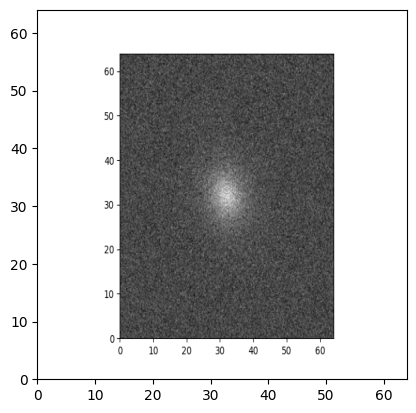

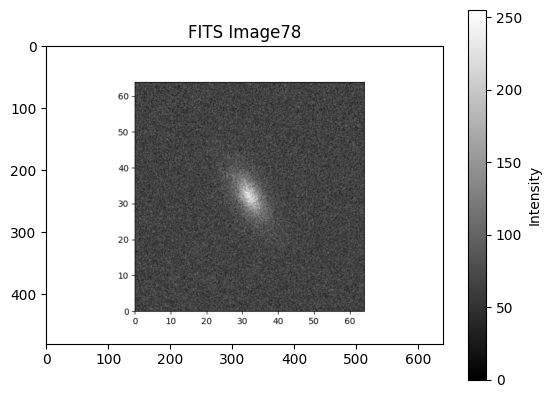

random_sim_gal/ellips78.png


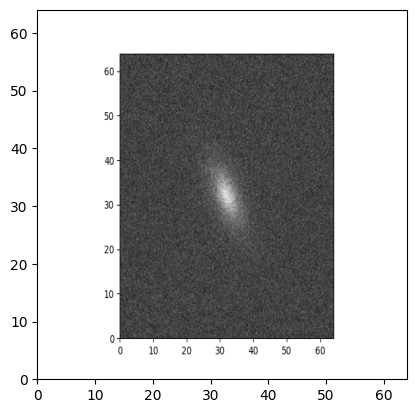

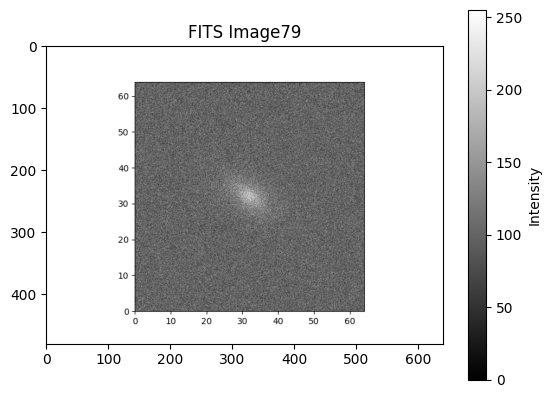

random_sim_gal/ellips79.png


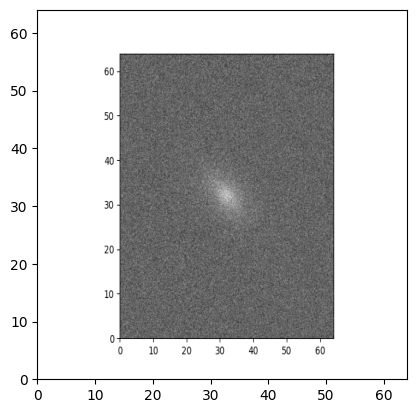

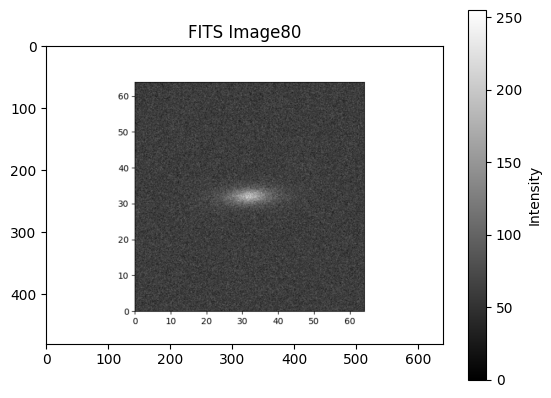

random_sim_gal/ellips80.png


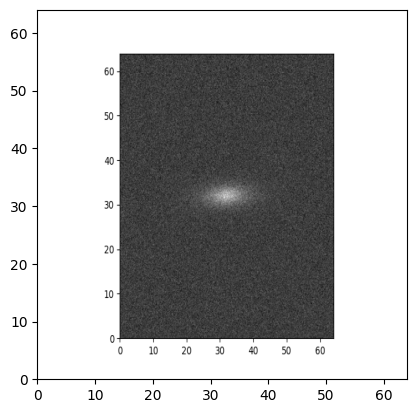

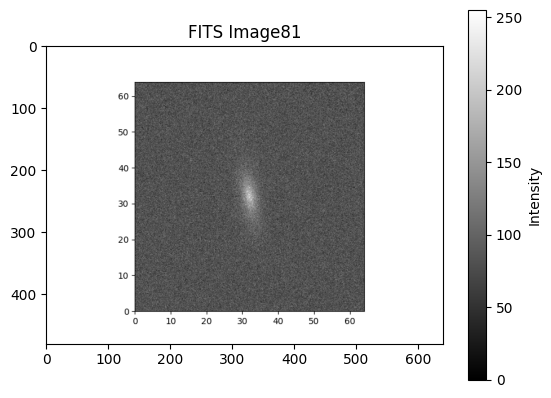

random_sim_gal/ellips81.png


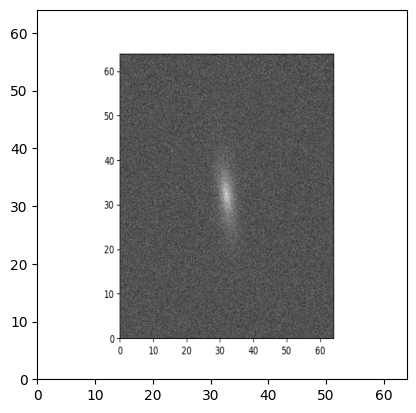

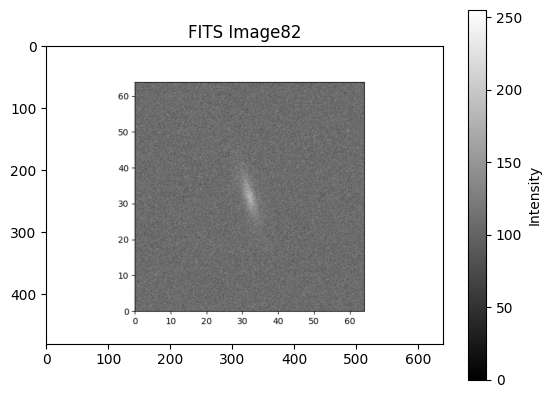

random_sim_gal/ellips82.png


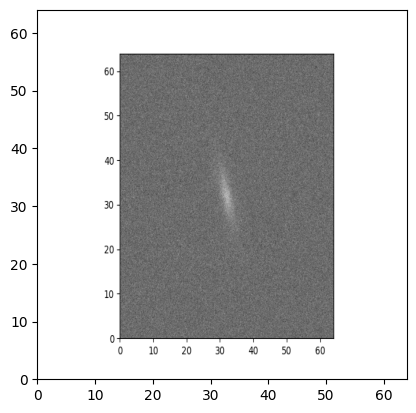

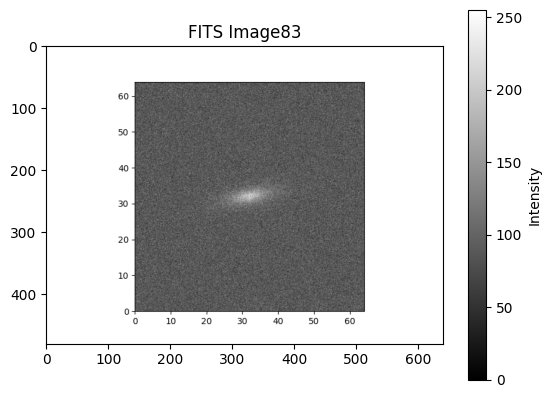

random_sim_gal/ellips83.png


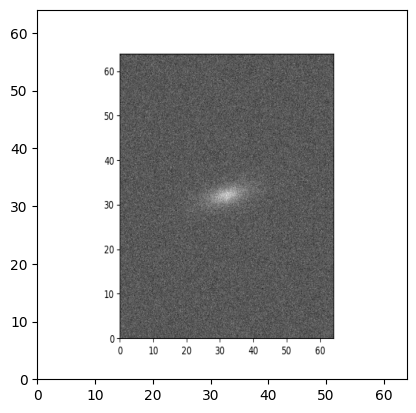

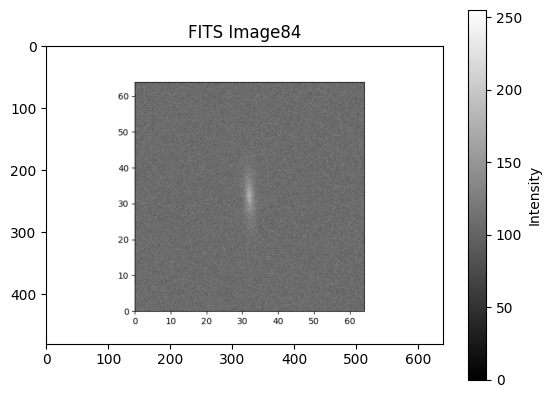

random_sim_gal/ellips84.png


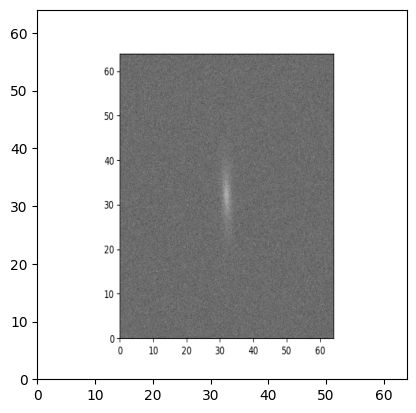

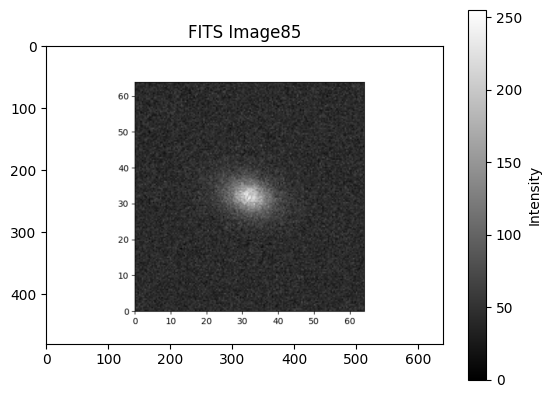

random_sim_gal/ellips85.png


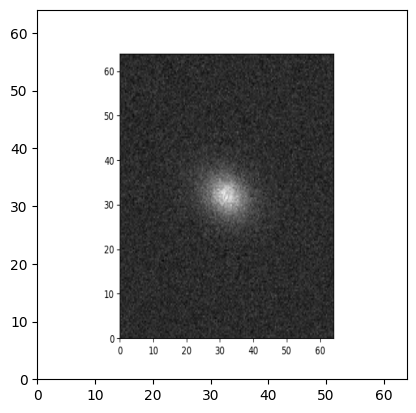

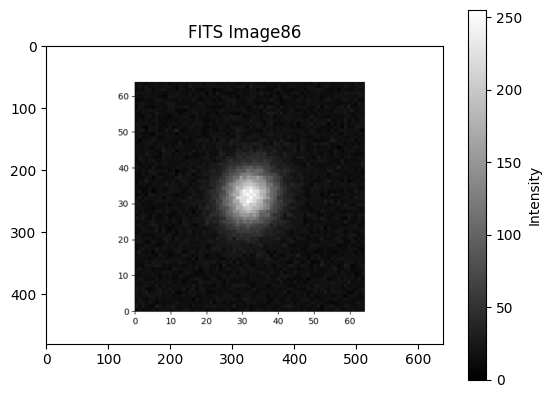

random_sim_gal/ellips86.png


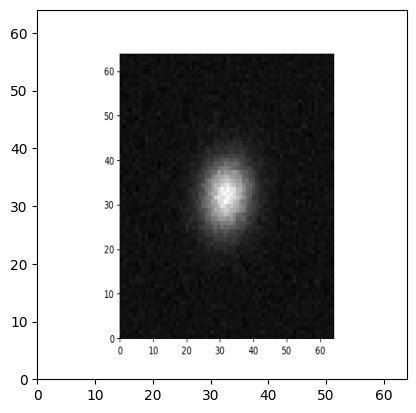

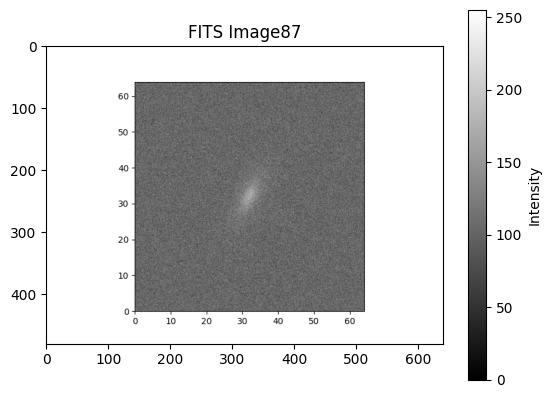

random_sim_gal/ellips87.png


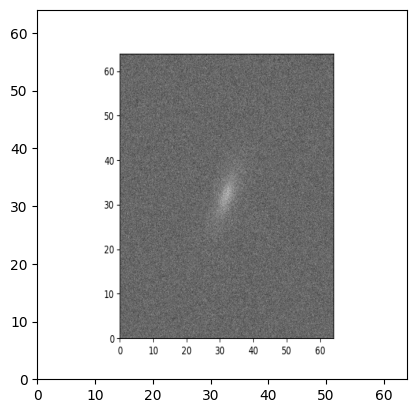

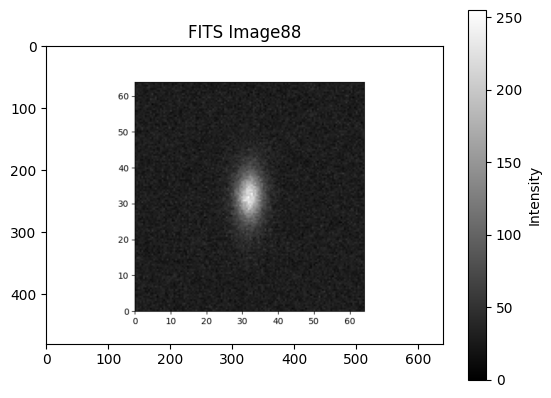

random_sim_gal/ellips88.png


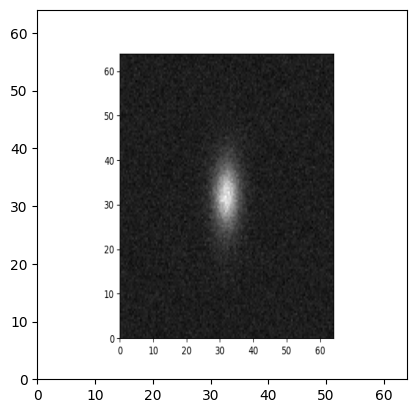

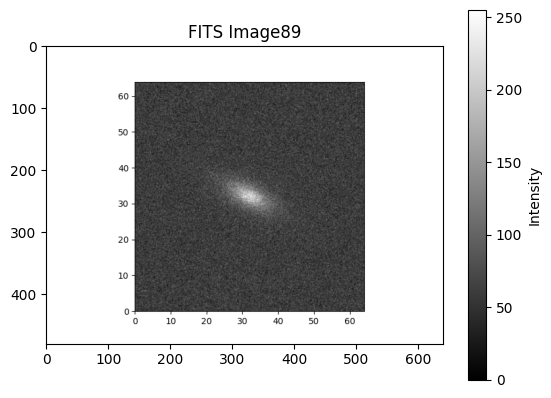

random_sim_gal/ellips89.png


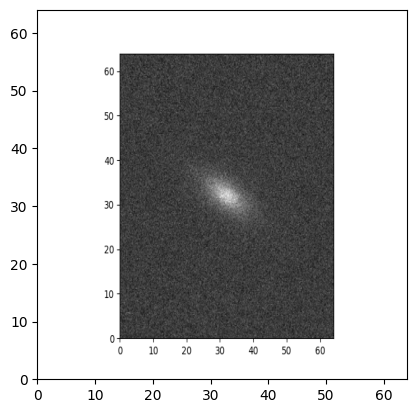

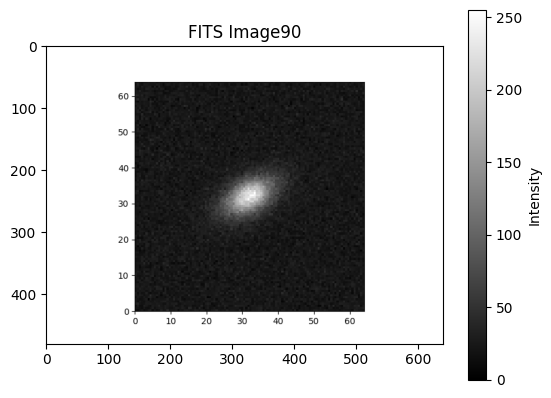

random_sim_gal/ellips90.png


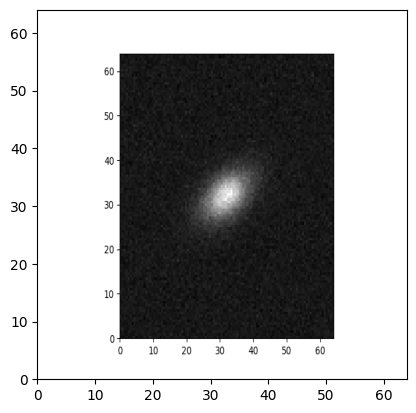

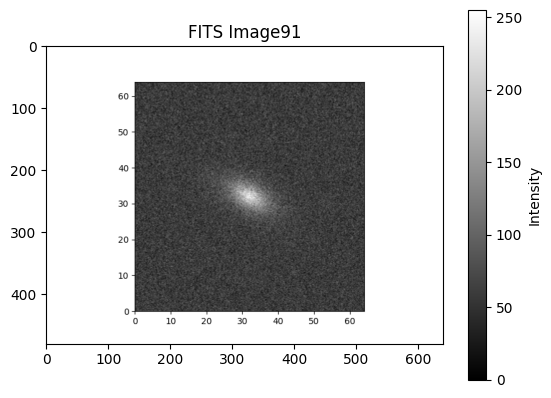

random_sim_gal/ellips91.png


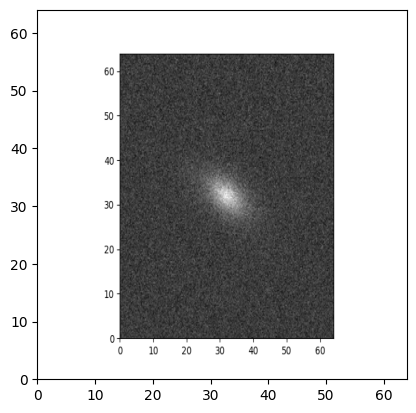

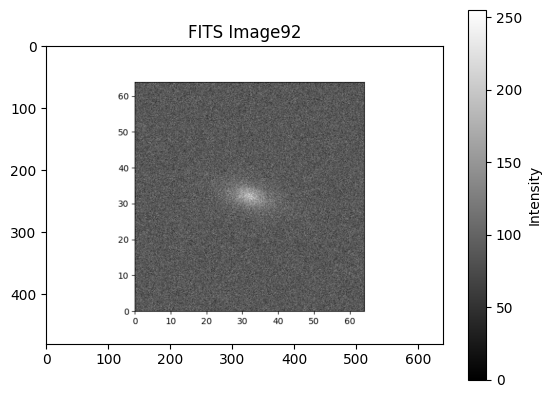

random_sim_gal/ellips92.png


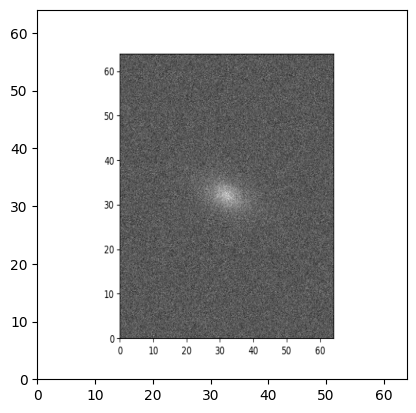

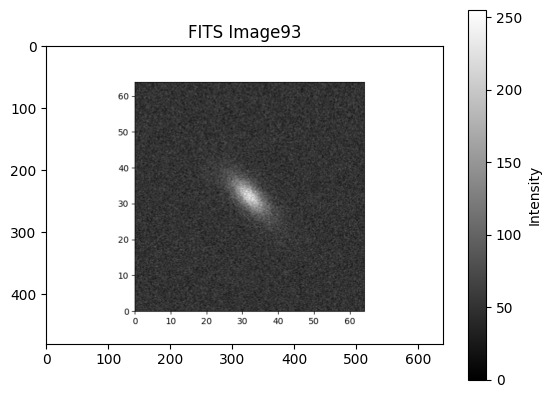

random_sim_gal/ellips93.png


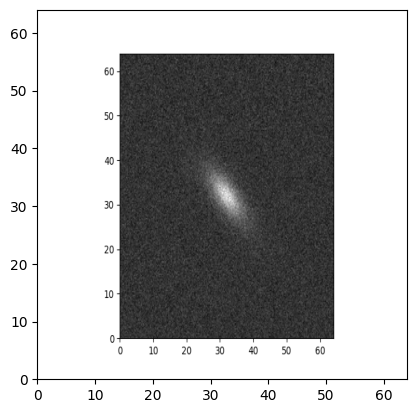

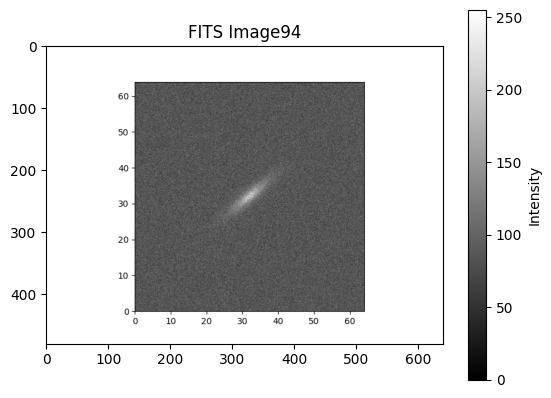

random_sim_gal/ellips94.png


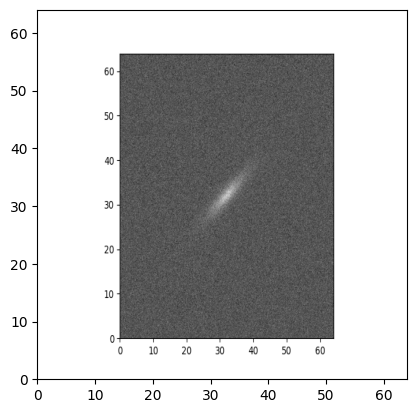

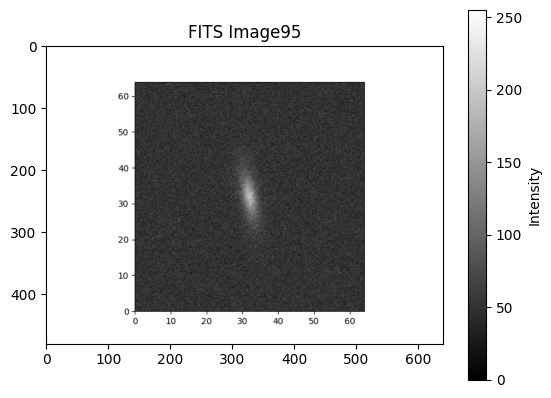

random_sim_gal/ellips95.png


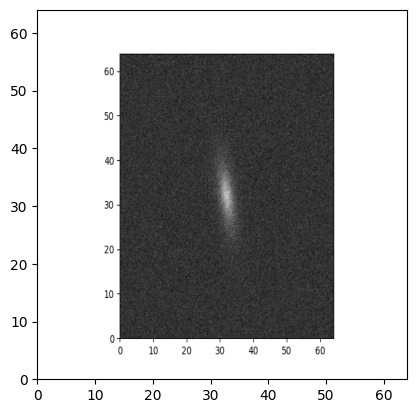

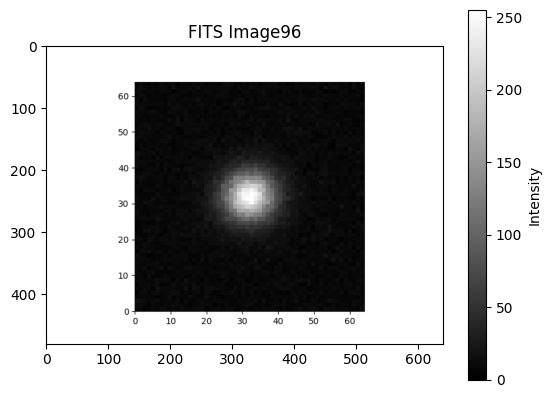

random_sim_gal/ellips96.png


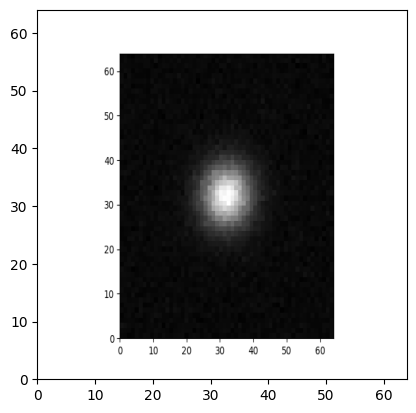

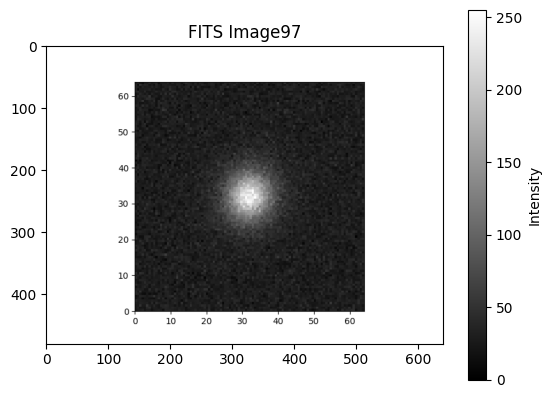

random_sim_gal/ellips97.png


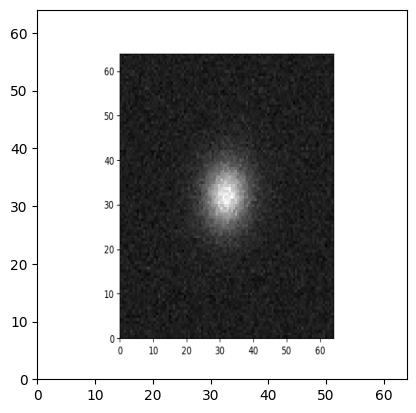

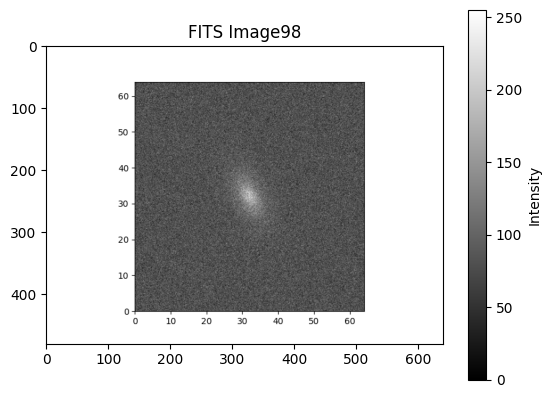

random_sim_gal/ellips98.png


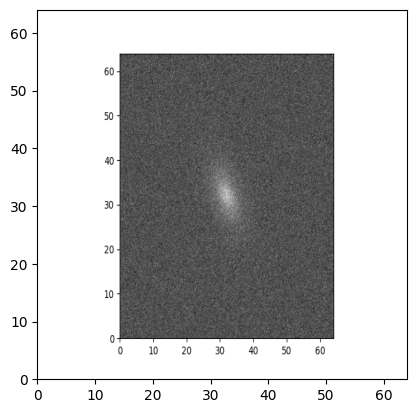

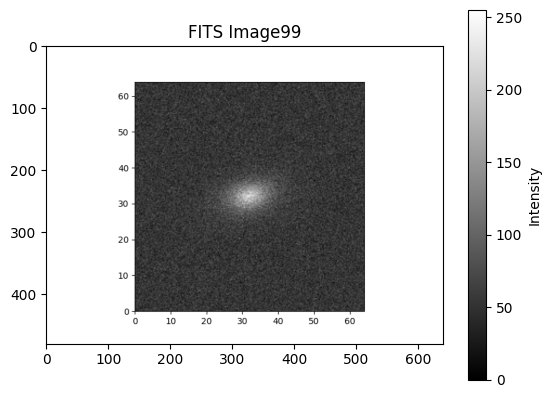

random_sim_gal/ellips99.png


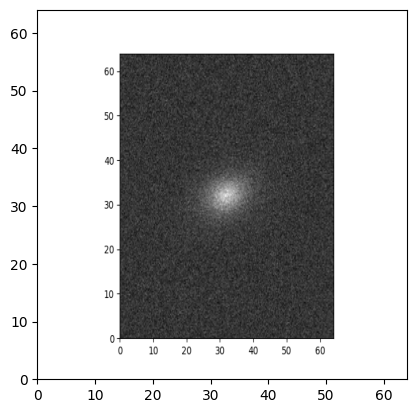

In [5]:
#put data in correct format
size = (64,64)

for i in range(100):

    # Specify the path to your FITS file
    fits_file_path = f'random_sim_gal/ellips{i}.fits'

    # Open the FITS file
    hdul = fits.open(fits_file_path)

    # Assuming the data is in the primary HDU (extension 0)
    data = hdul[0].data

    # Close the FITS file
    hdul.close()

    # Plot the image using matplotlib
    plt.imshow(data, cmap='gray')  # Use 'cmap' to specify the color map
    plt.title(f'FITS Image{i}')
    plt.colorbar(label="Intensity")
    plt.show()

    # Save the matplotlib figure to a PNG file
    png_path = f'random_sim_gal/ellips{i}.png'
    plt.savefig(png_path)
    plt.close()  # Close the matplotlib figure
 
    plt.imshow(data, cmap='gray',extent=[0, size[0], 0, size[1]])

    save_path = png_path
    print(save_path)
    plt.savefig(save_path)
    plt.show()

    png_image = Image.open(save_path)
    data = np.array(png_image)

    # Create a FITS header
    header = fits.Header()
    header['COMMENT'] = 'Shape corrected'

    # Create a FITS HDU (Header/Data Unit)
    hdu = fits.PrimaryHDU(data, header=header)

    # Specify the path for saving the FITS file
    filename = f'ellips{i}.fits'
    fits_path = f'random_sim_gal/{filename}'

    # Write the FITS file
    hdu.writeto(fits_path, overwrite=True)

    if os.path.exists(save_path):
        # Delete the file
        os.remove(save_path)

In [179]:
'''
    # Open the PNG file and save it to a FITS file
    png_image = plt.imread(png_path)
    hdu = fits.PrimaryHDU(png_image)
    hdul = fits.HDUList([hdu])
    hdul.writeto(fits_file_path, overwrite=True)
    hdul.close()

    # Optionally, you can remove the temporary PNG file
    os.remove(png_path)
'''   

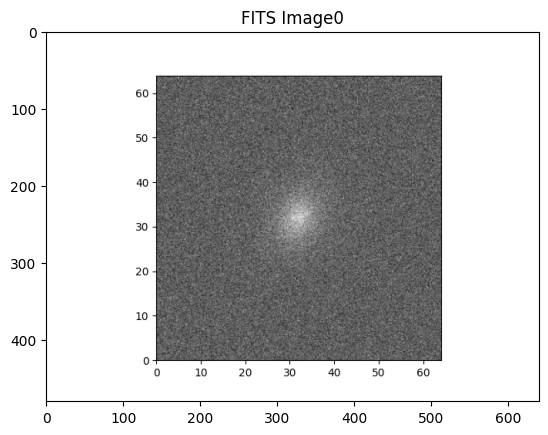

(480, 640, 4)


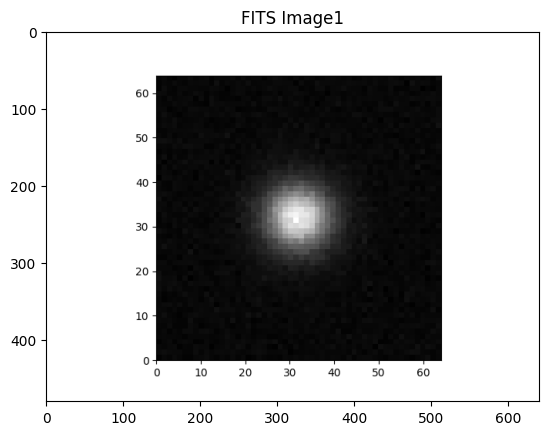

(480, 640, 4)


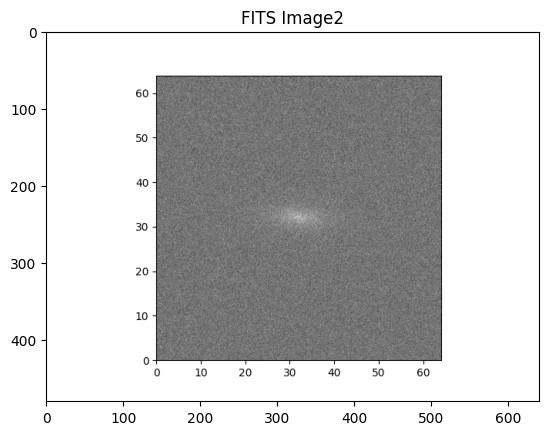

(480, 640, 4)


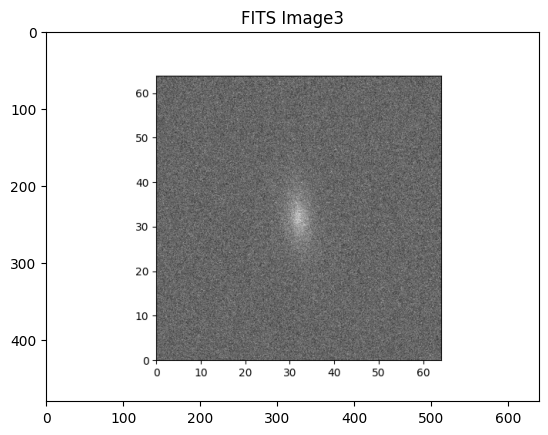

(480, 640, 4)


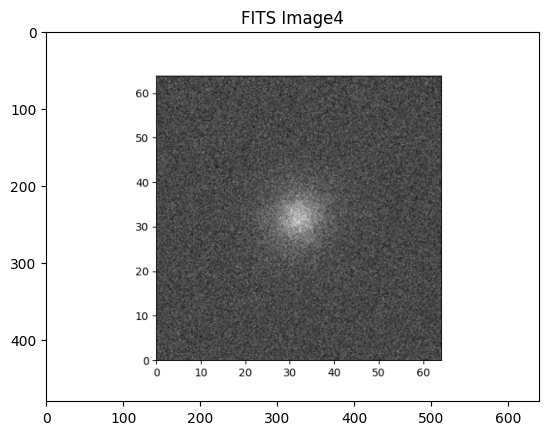

(480, 640, 4)


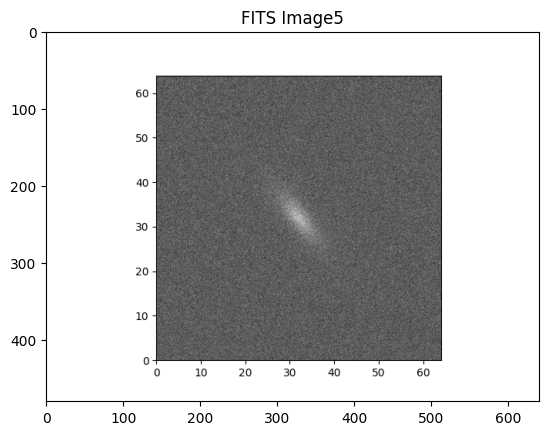

(480, 640, 4)


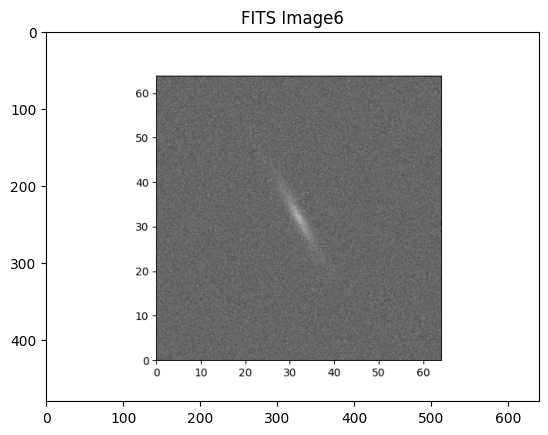

(480, 640, 4)


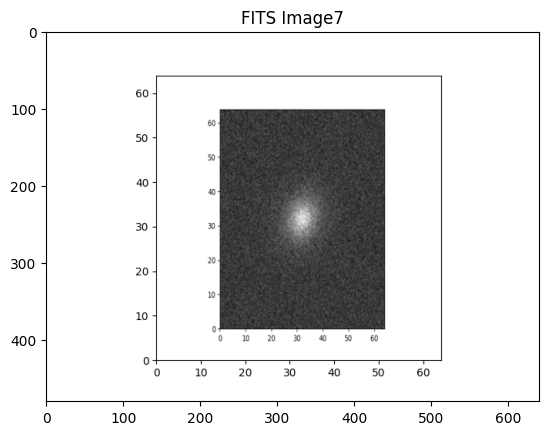

(480, 640, 4)


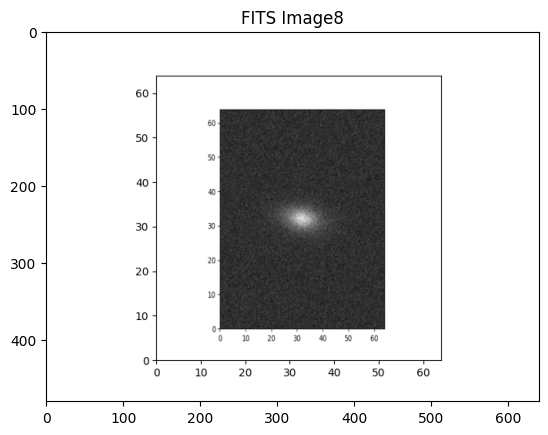

(480, 640, 4)


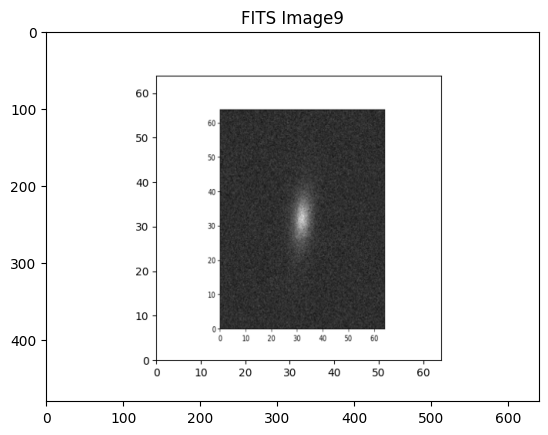

(480, 640, 4)


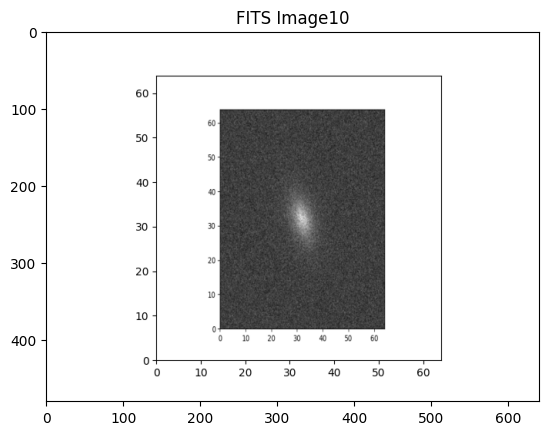

(480, 640, 4)


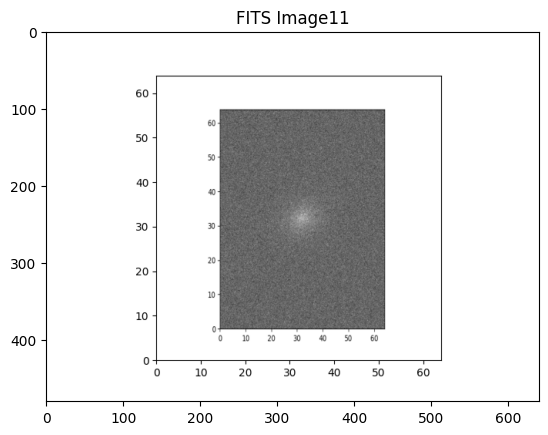

(480, 640, 4)


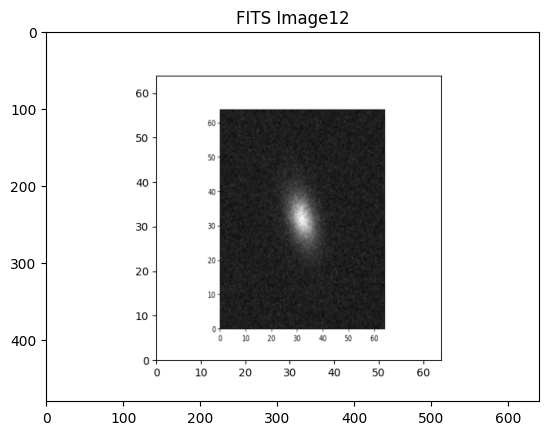

(480, 640, 4)


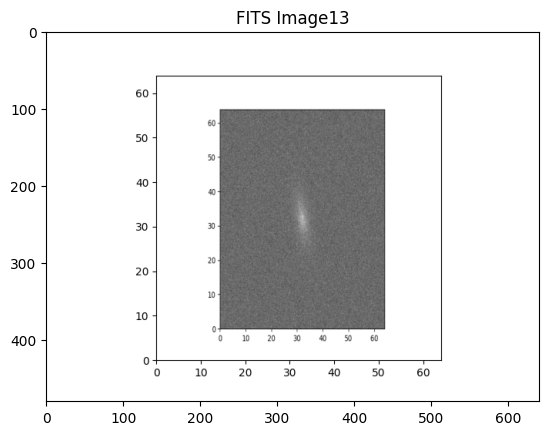

(480, 640, 4)


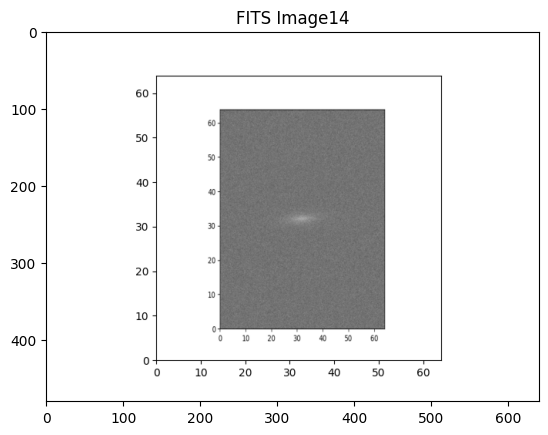

(480, 640, 4)


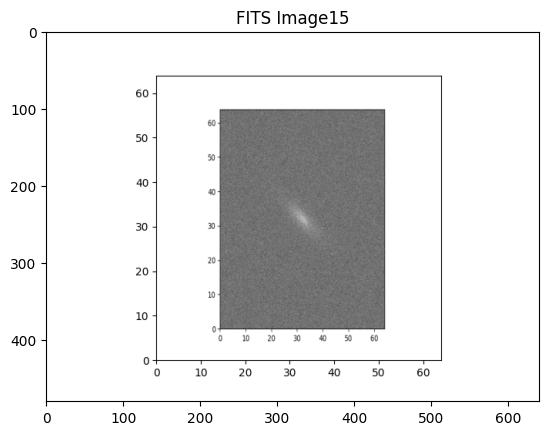

(480, 640, 4)


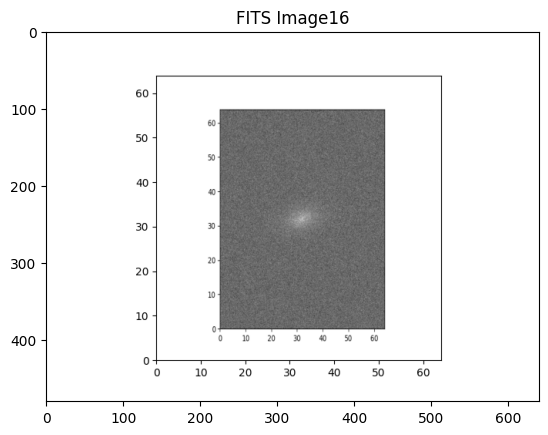

(480, 640, 4)


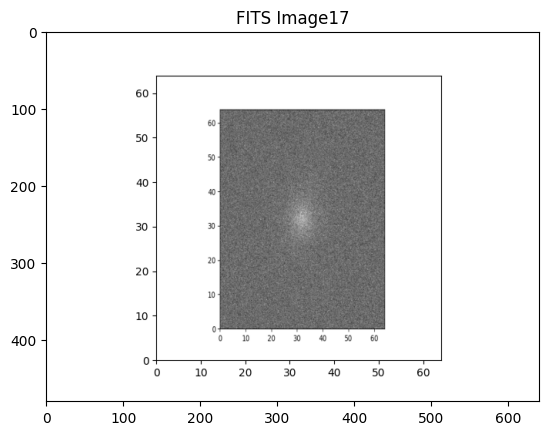

(480, 640, 4)


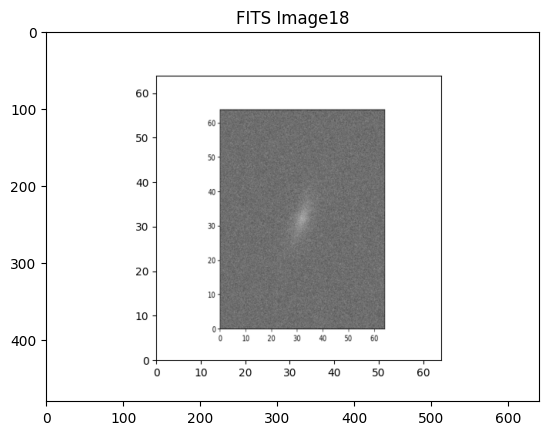

(480, 640, 4)


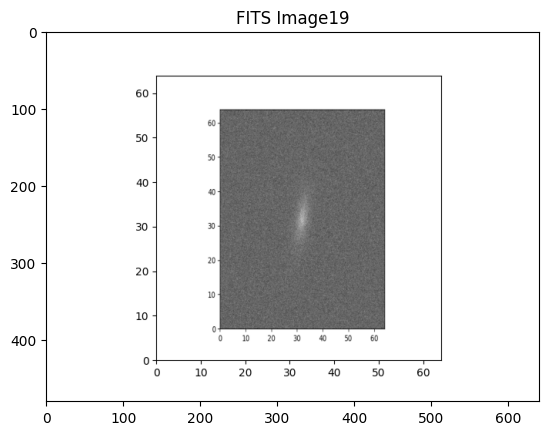

(480, 640, 4)


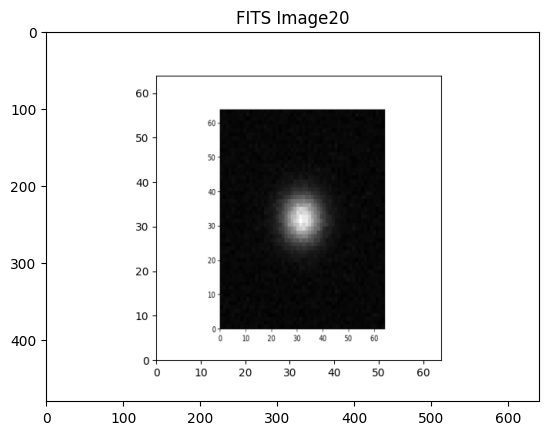

(480, 640, 4)


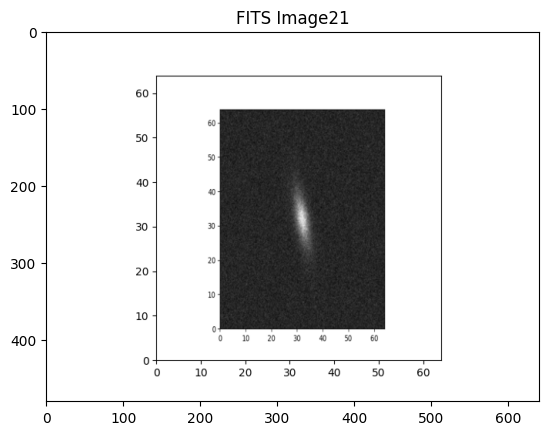

(480, 640, 4)


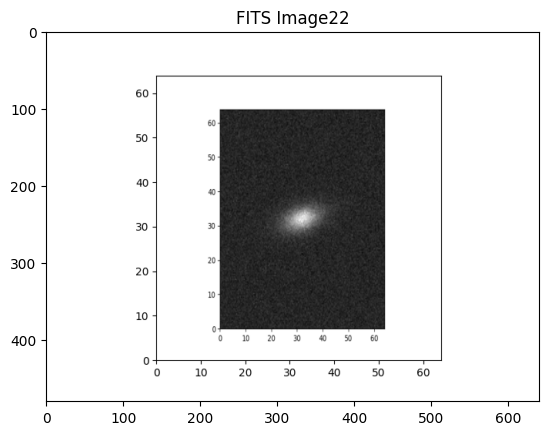

(480, 640, 4)


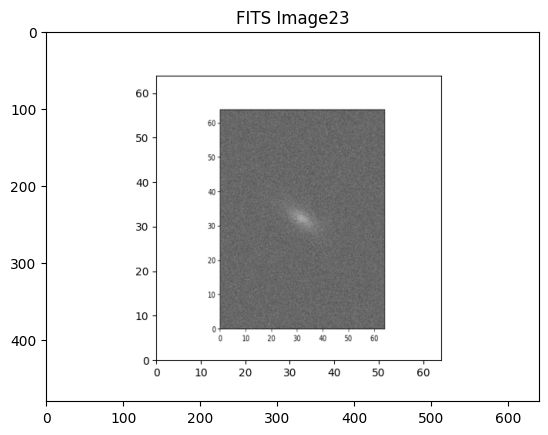

(480, 640, 4)


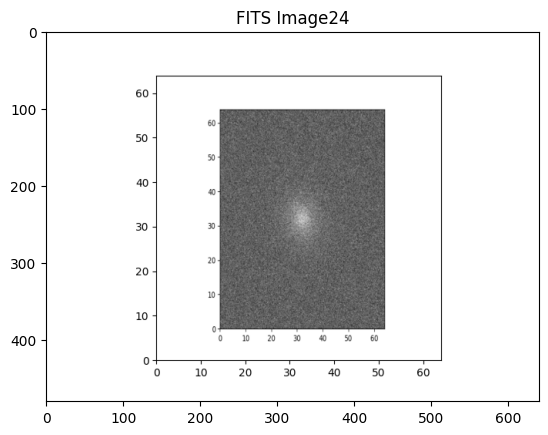

(480, 640, 4)


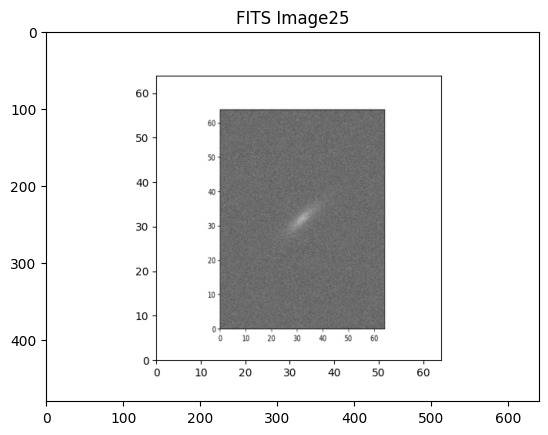

(480, 640, 4)


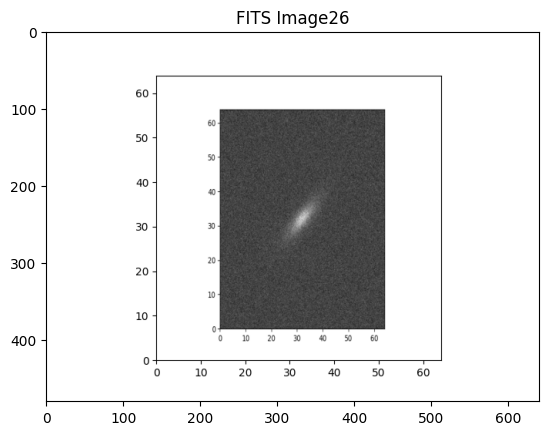

(480, 640, 4)


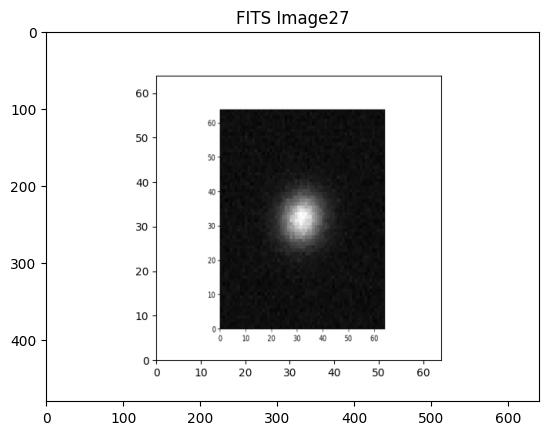

(480, 640, 4)


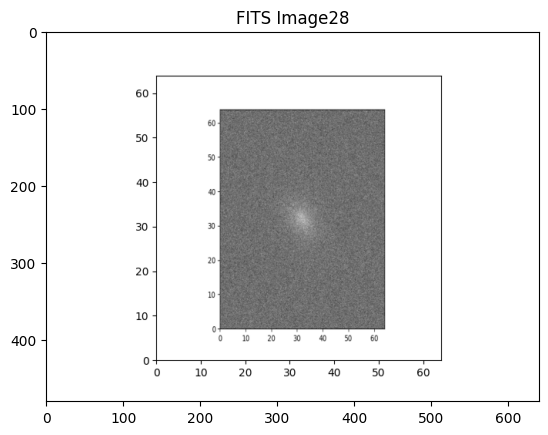

(480, 640, 4)


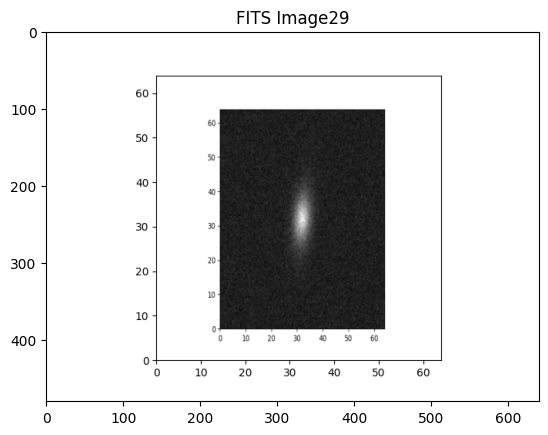

(480, 640, 4)


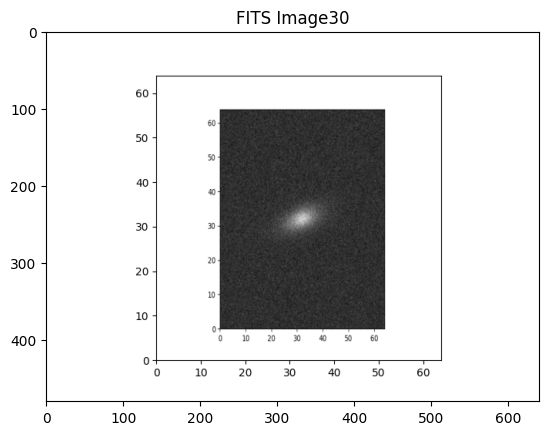

(480, 640, 4)


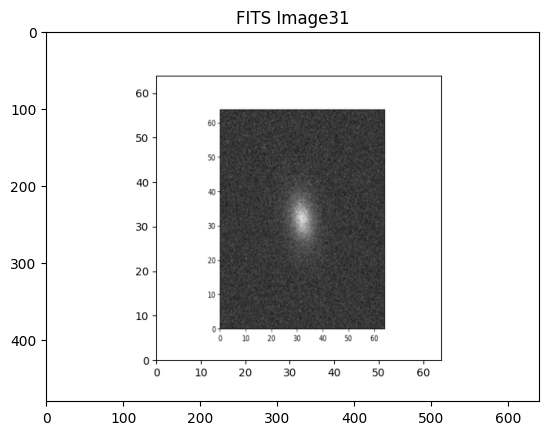

(480, 640, 4)


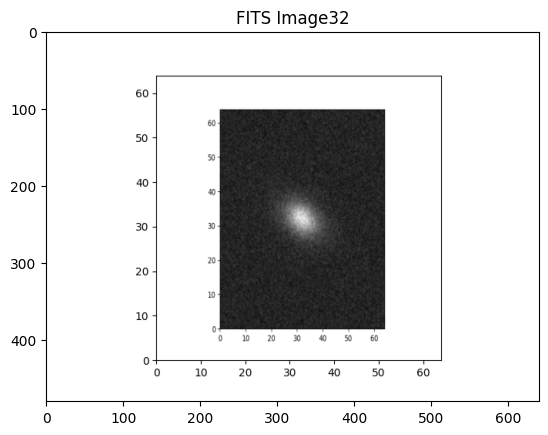

(480, 640, 4)


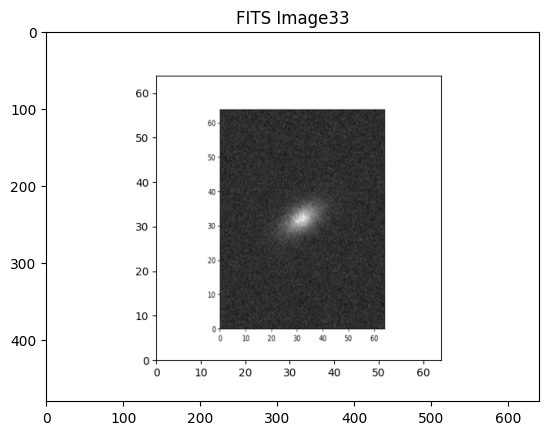

(480, 640, 4)


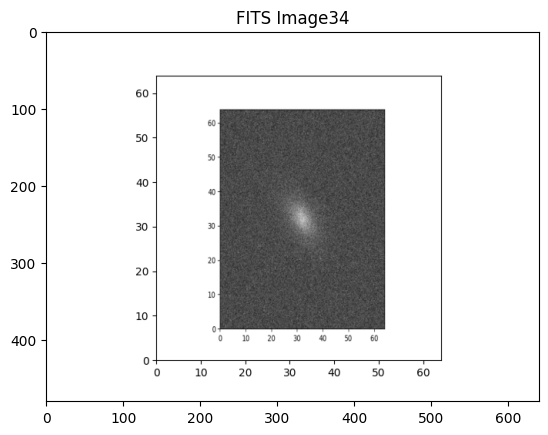

(480, 640, 4)


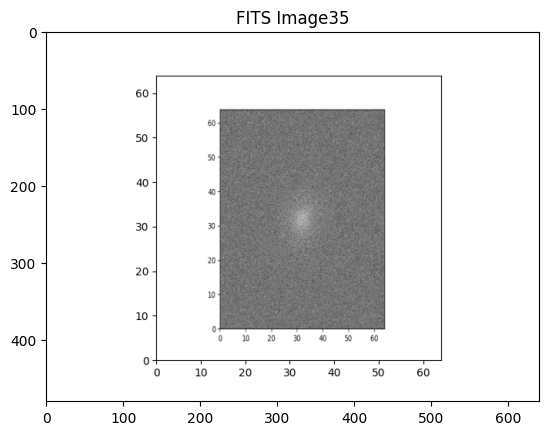

(480, 640, 4)


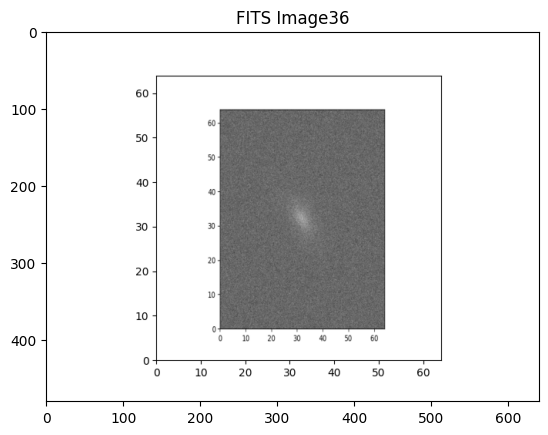

(480, 640, 4)


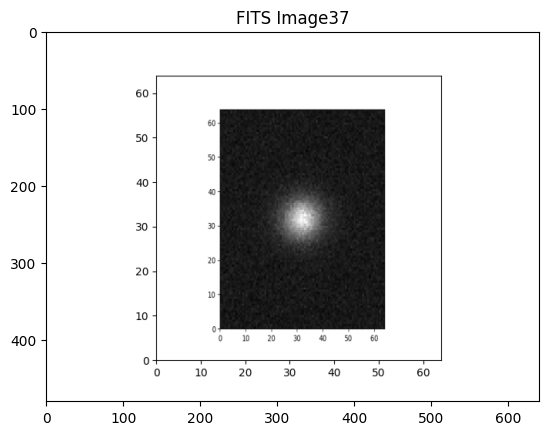

(480, 640, 4)


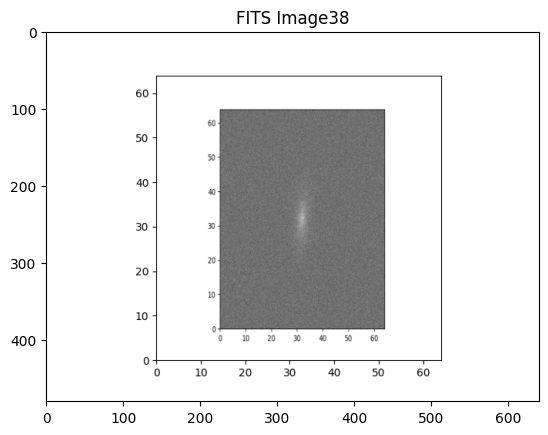

(480, 640, 4)


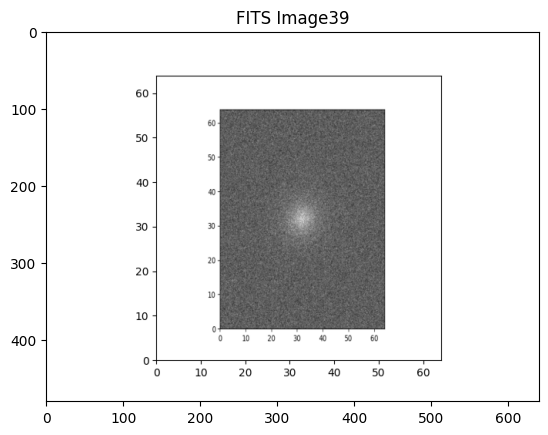

(480, 640, 4)


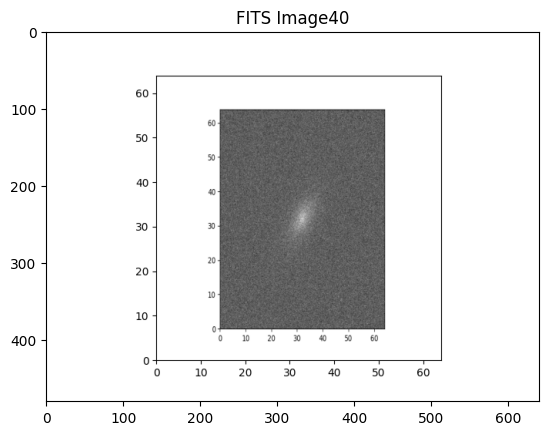

(480, 640, 4)


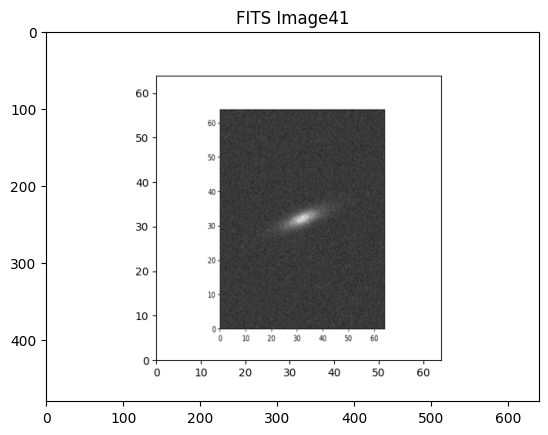

(480, 640, 4)


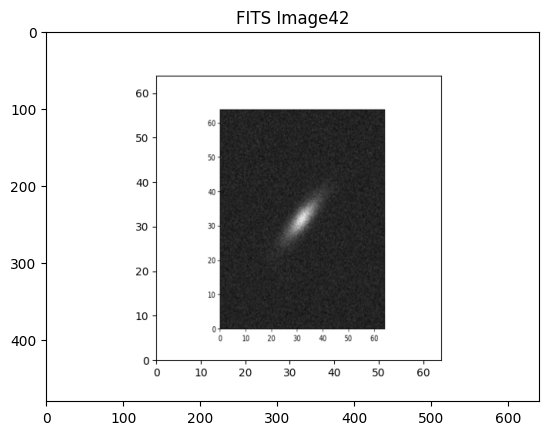

(480, 640, 4)


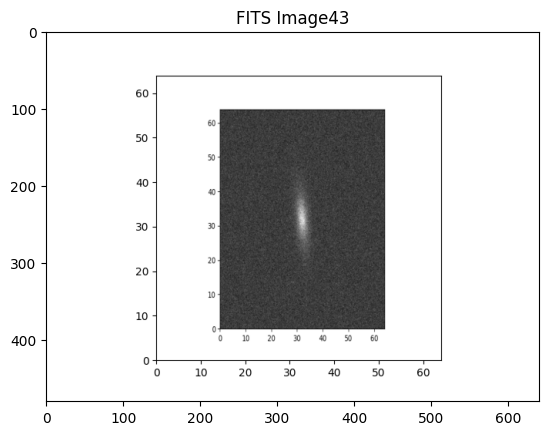

(480, 640, 4)


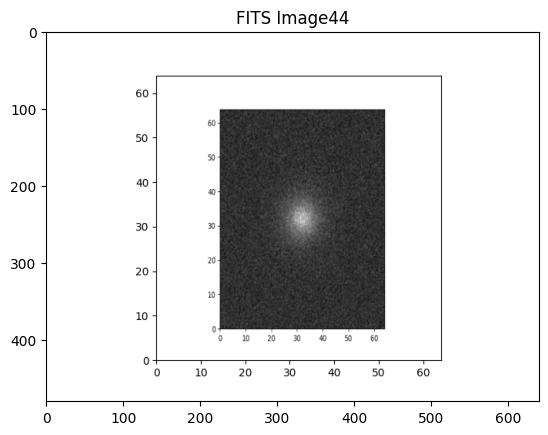

(480, 640, 4)


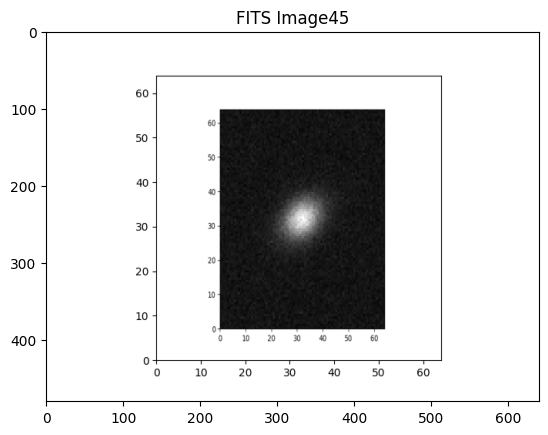

(480, 640, 4)


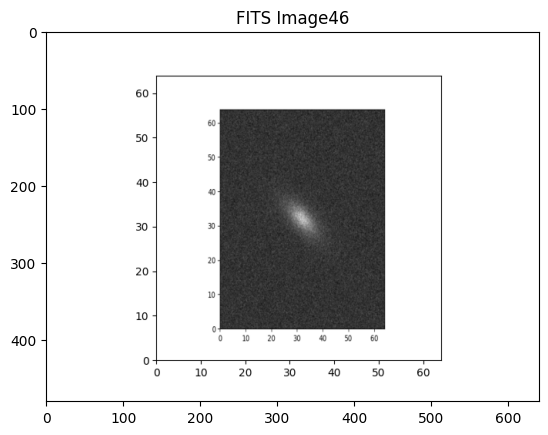

(480, 640, 4)


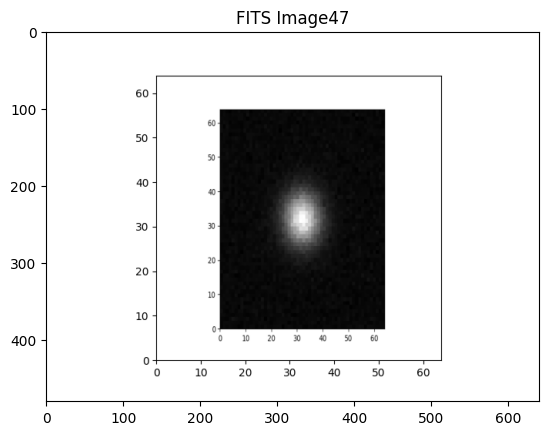

(480, 640, 4)


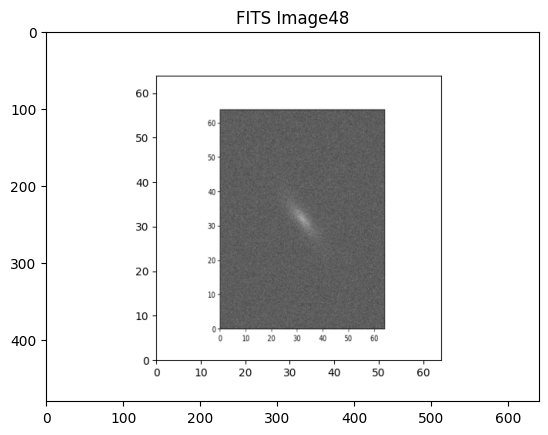

(480, 640, 4)


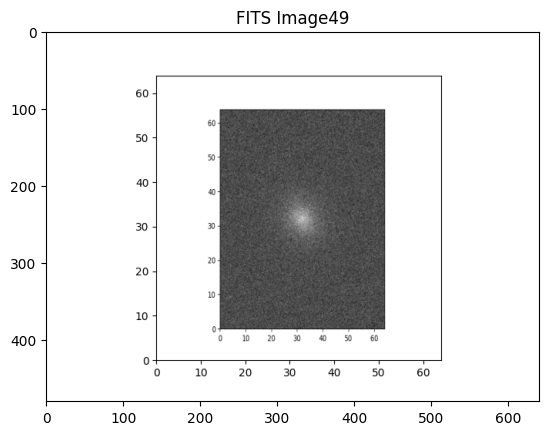

(480, 640, 4)


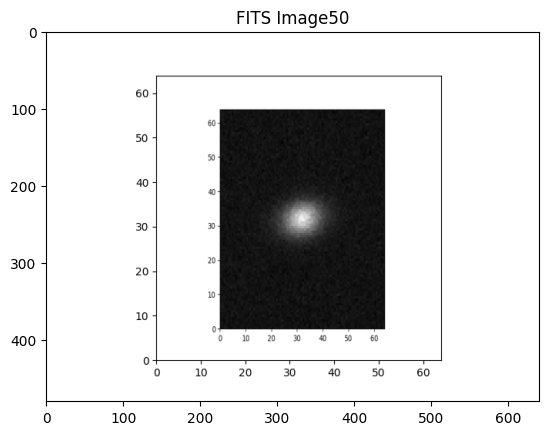

(480, 640, 4)


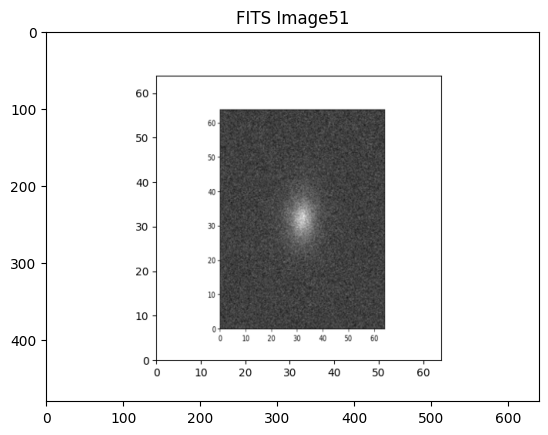

(480, 640, 4)


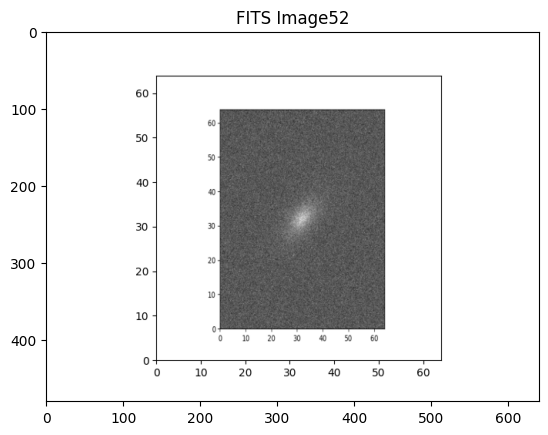

(480, 640, 4)


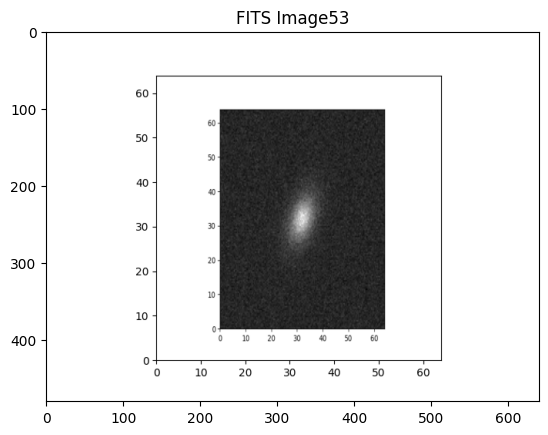

(480, 640, 4)


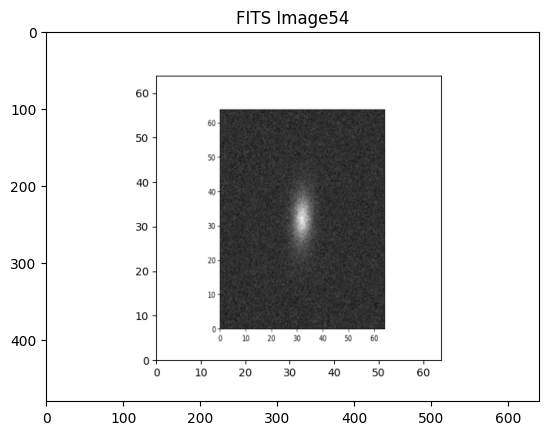

(480, 640, 4)


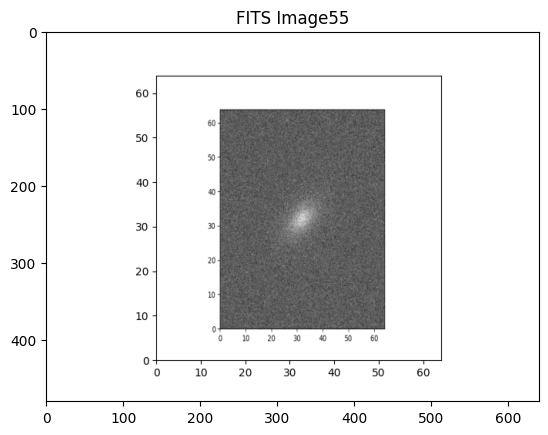

(480, 640, 4)


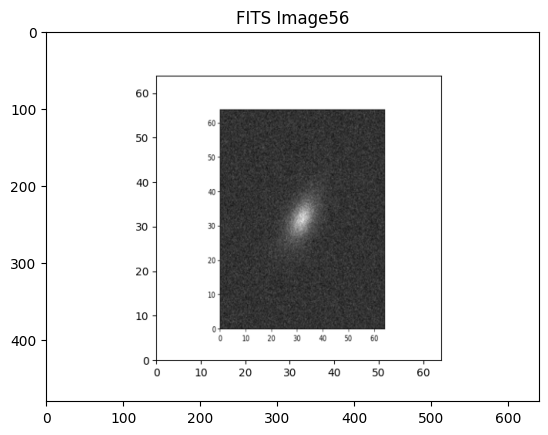

(480, 640, 4)


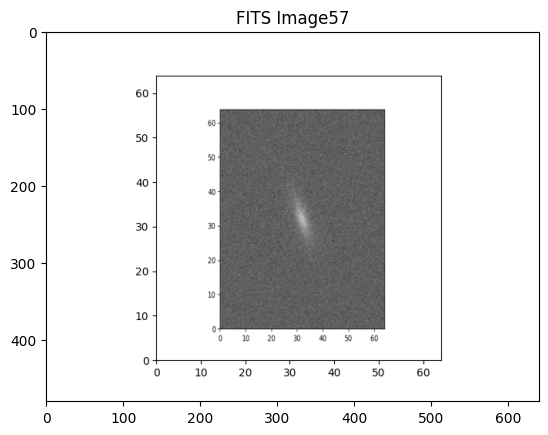

(480, 640, 4)


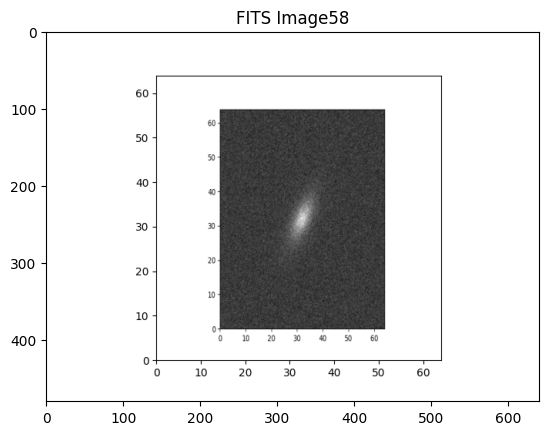

(480, 640, 4)


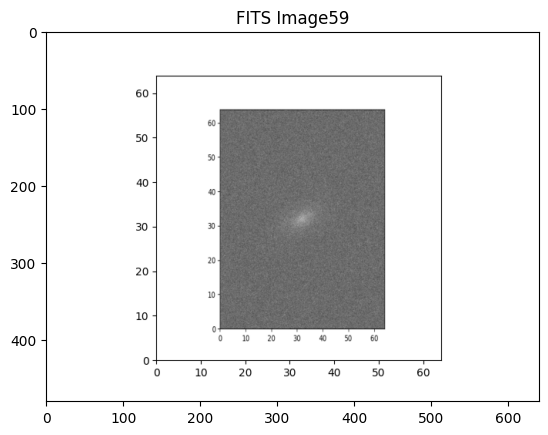

(480, 640, 4)


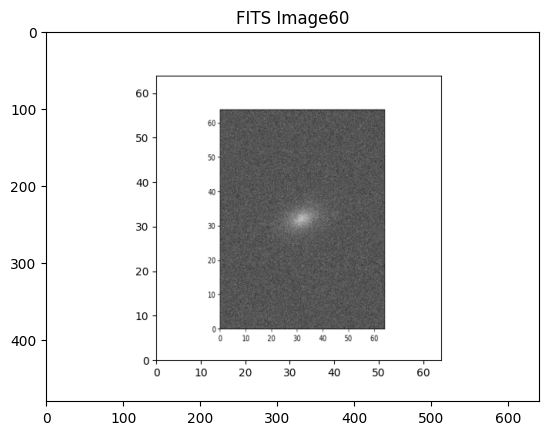

(480, 640, 4)


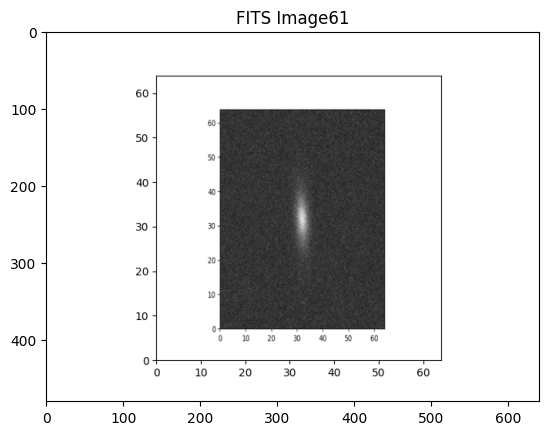

(480, 640, 4)


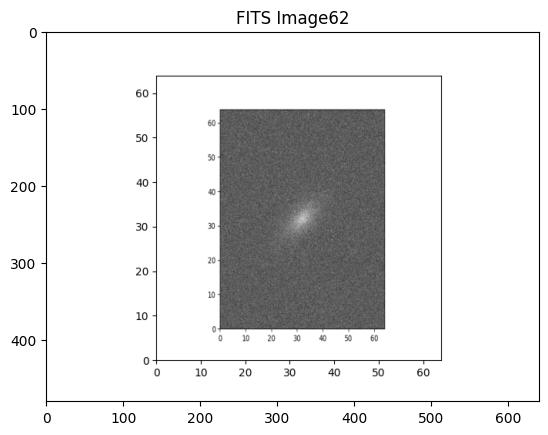

(480, 640, 4)


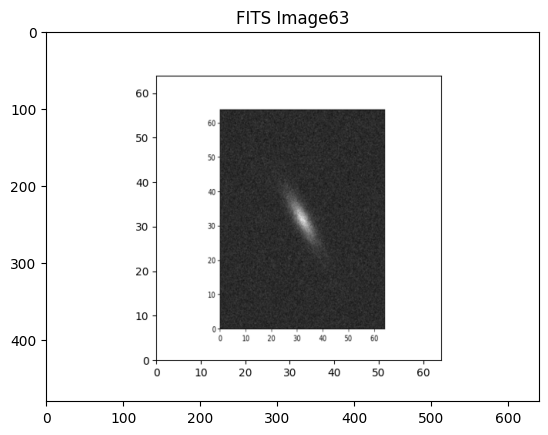

(480, 640, 4)


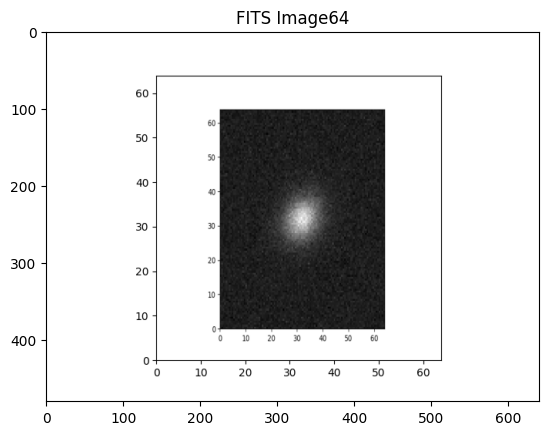

(480, 640, 4)


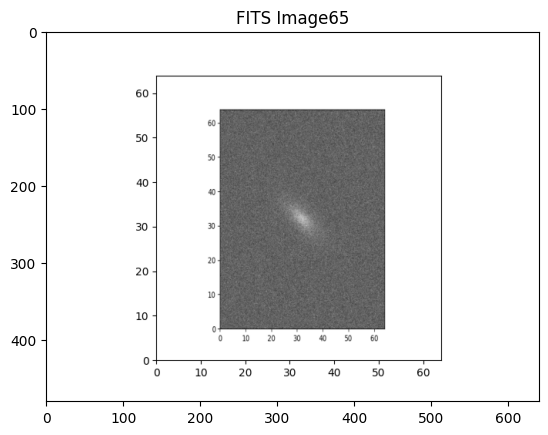

(480, 640, 4)


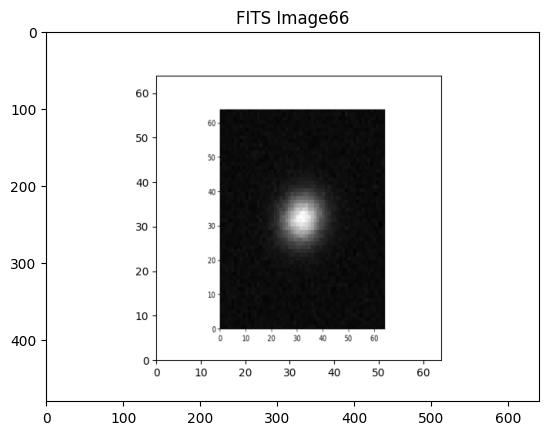

(480, 640, 4)


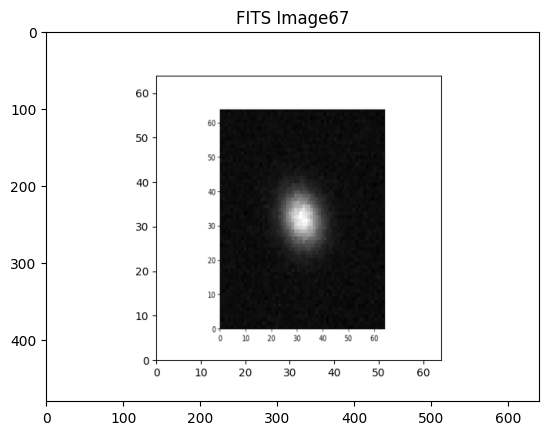

(480, 640, 4)


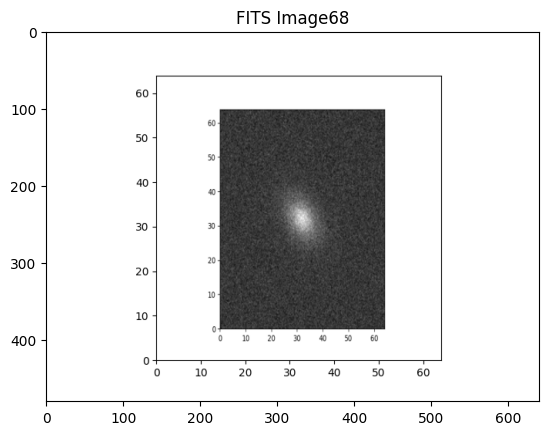

(480, 640, 4)


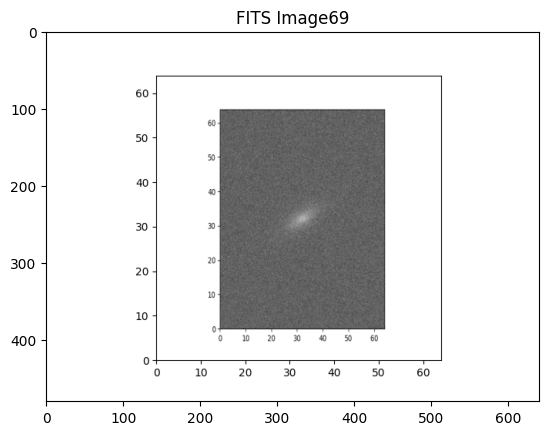

(480, 640, 4)


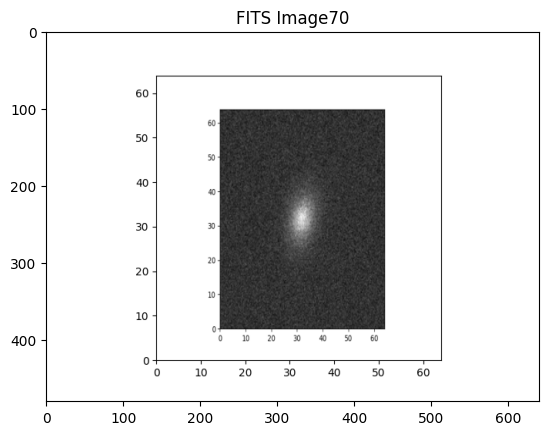

(480, 640, 4)


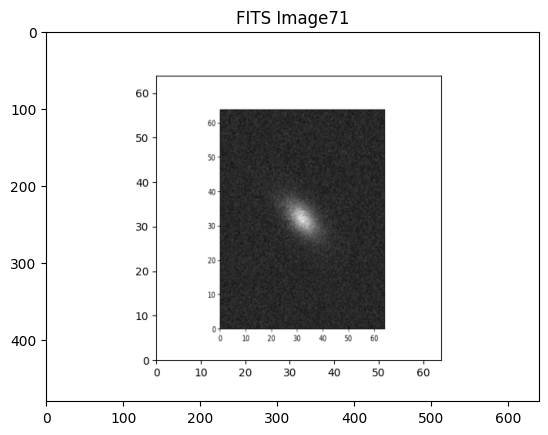

(480, 640, 4)


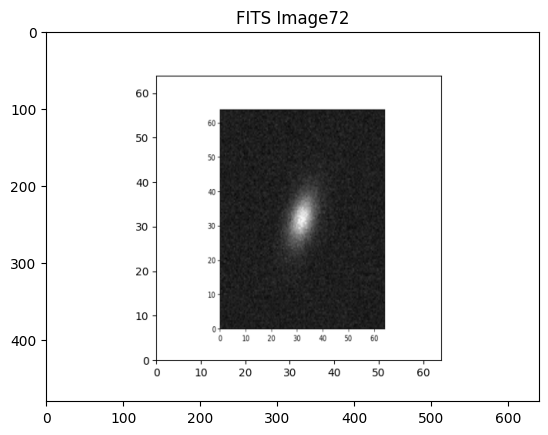

(480, 640, 4)


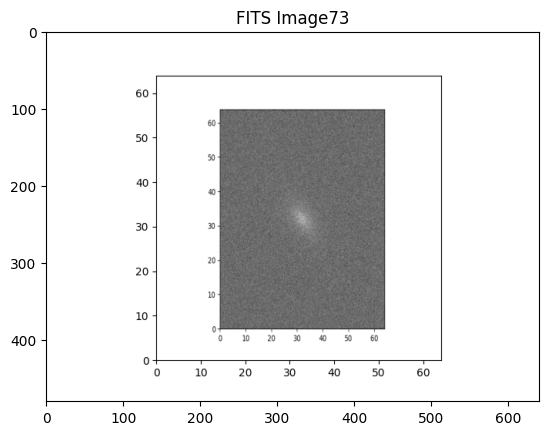

(480, 640, 4)


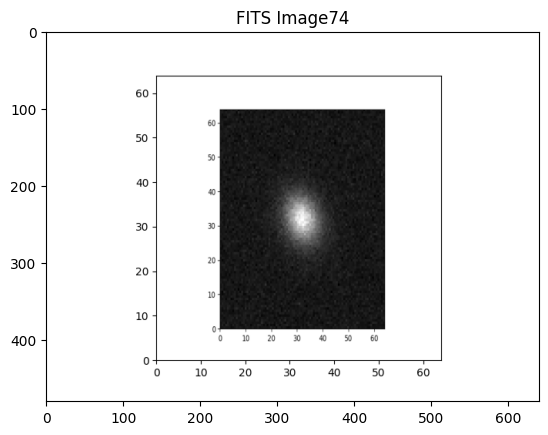

(480, 640, 4)


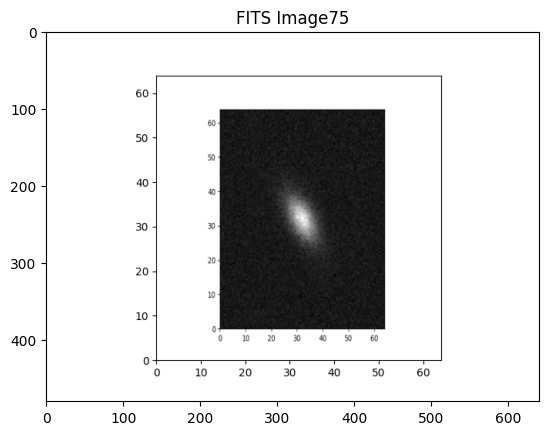

(480, 640, 4)


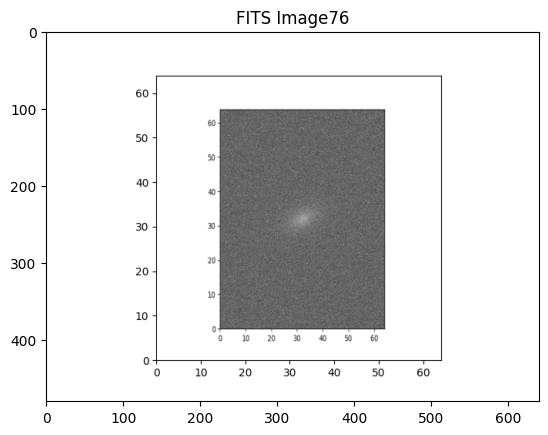

(480, 640, 4)


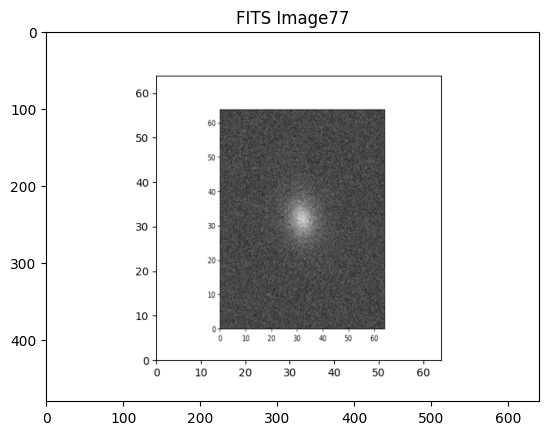

(480, 640, 4)


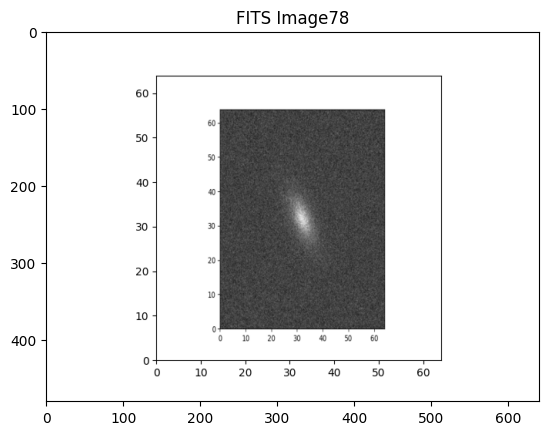

(480, 640, 4)


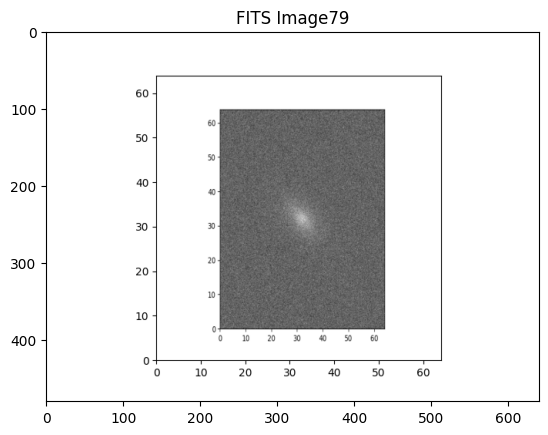

(480, 640, 4)


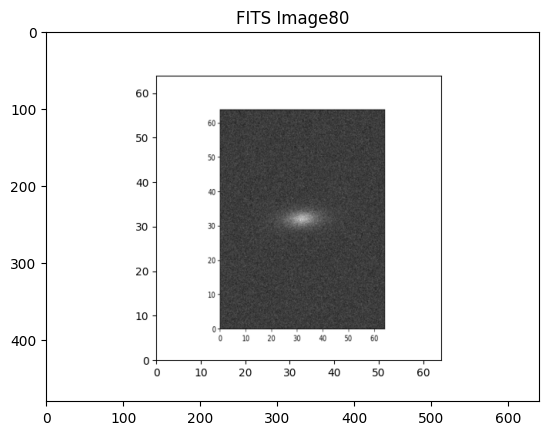

(480, 640, 4)


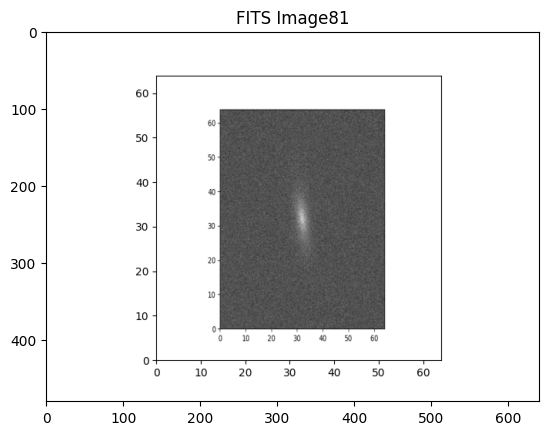

(480, 640, 4)


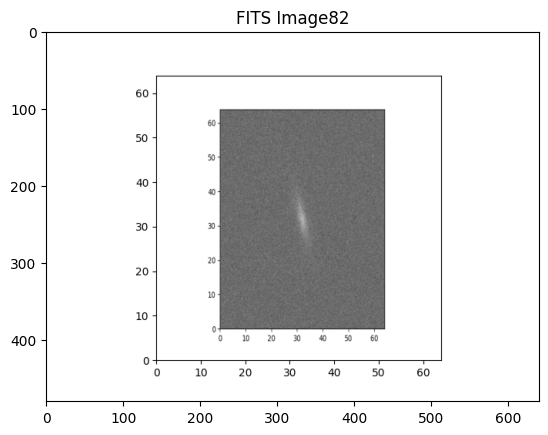

(480, 640, 4)


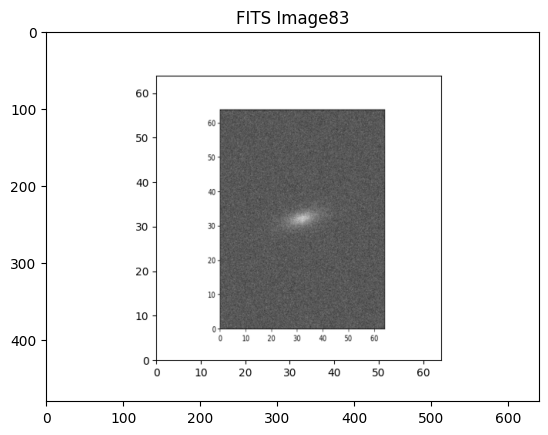

(480, 640, 4)


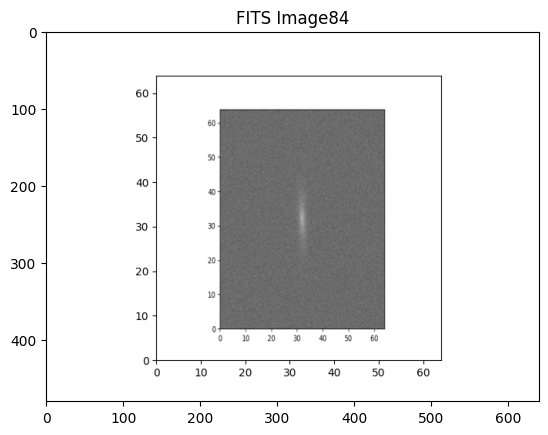

(480, 640, 4)


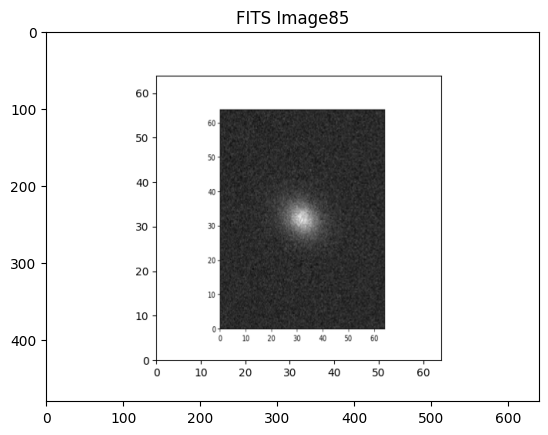

(480, 640, 4)


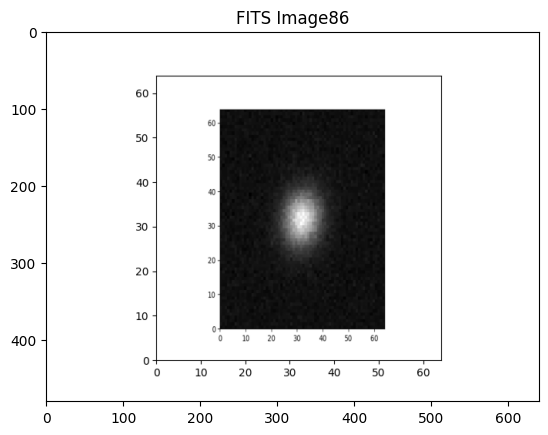

(480, 640, 4)


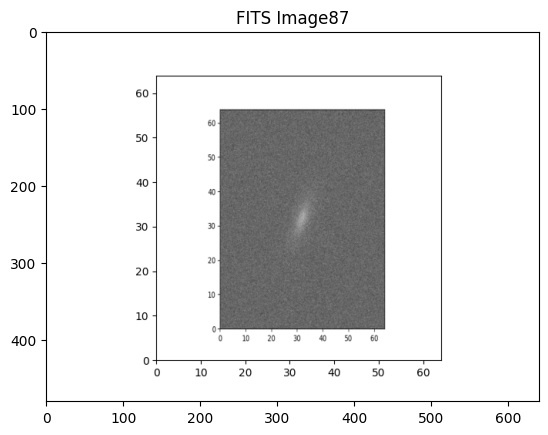

(480, 640, 4)


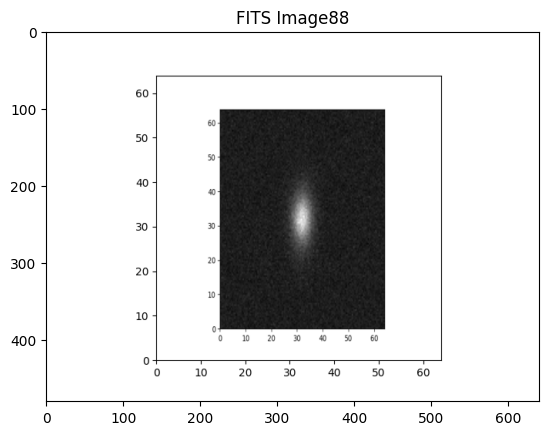

(480, 640, 4)


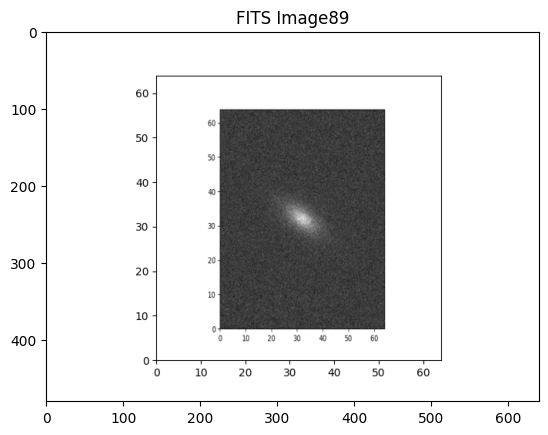

(480, 640, 4)


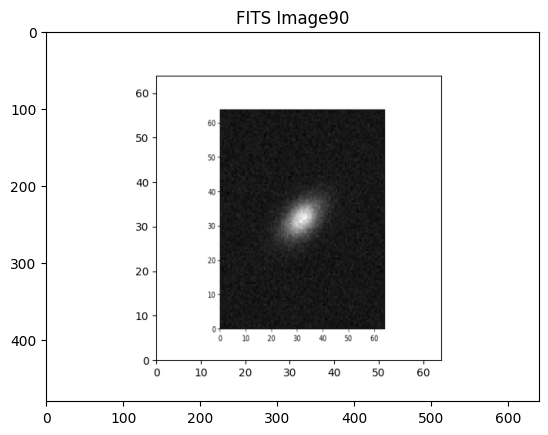

(480, 640, 4)


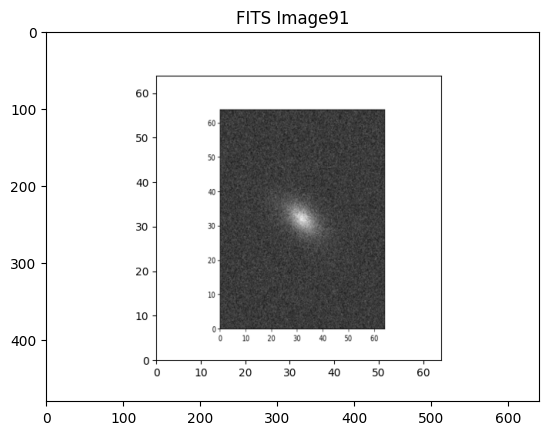

(480, 640, 4)


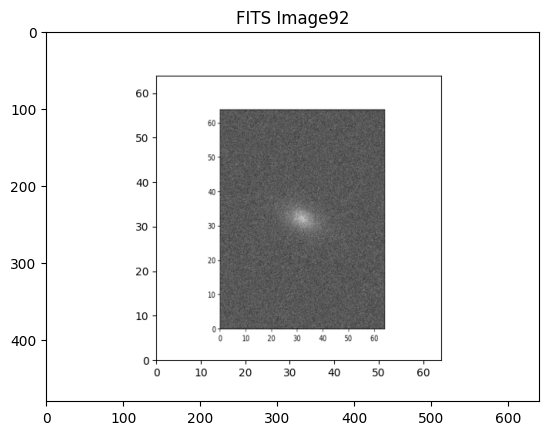

(480, 640, 4)


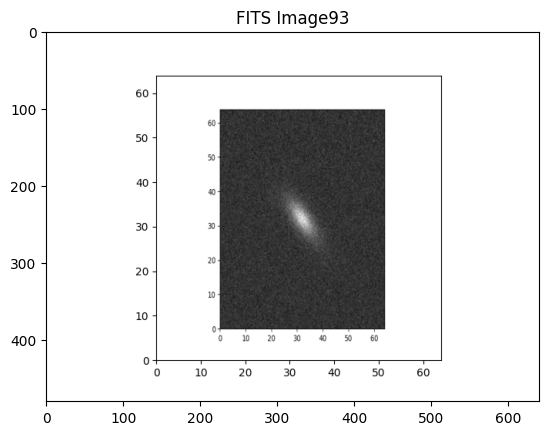

(480, 640, 4)


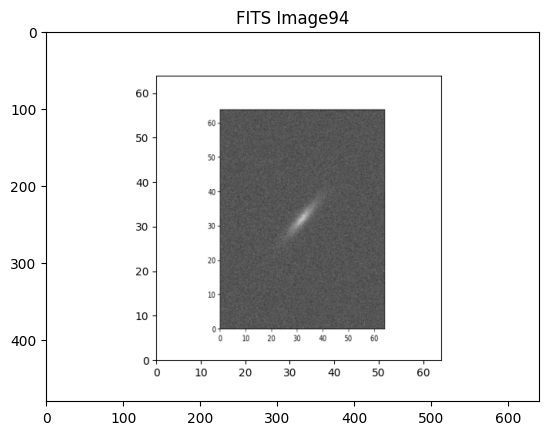

(480, 640, 4)


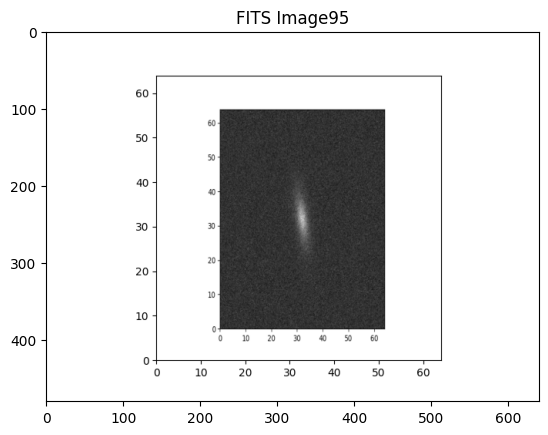

(480, 640, 4)


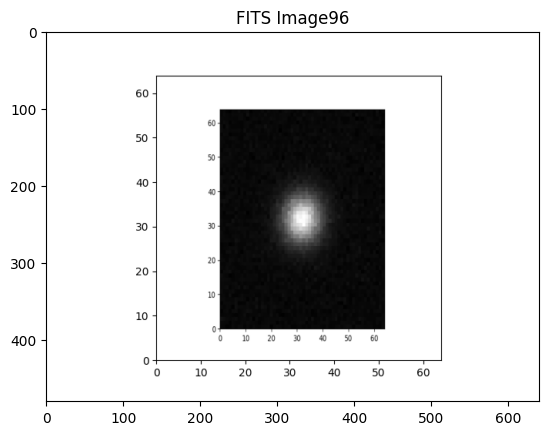

(480, 640, 4)


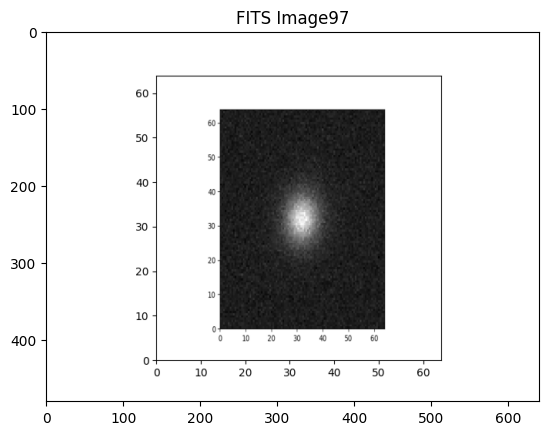

(480, 640, 4)


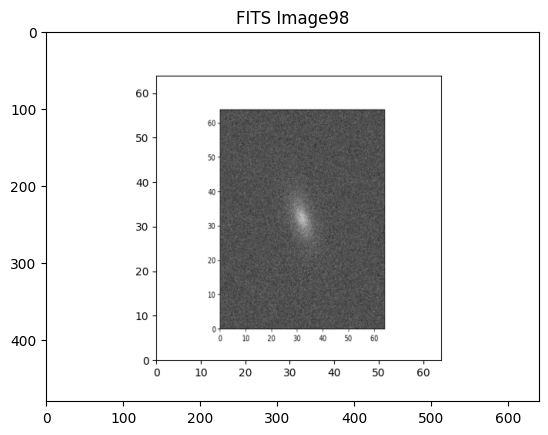

(480, 640, 4)


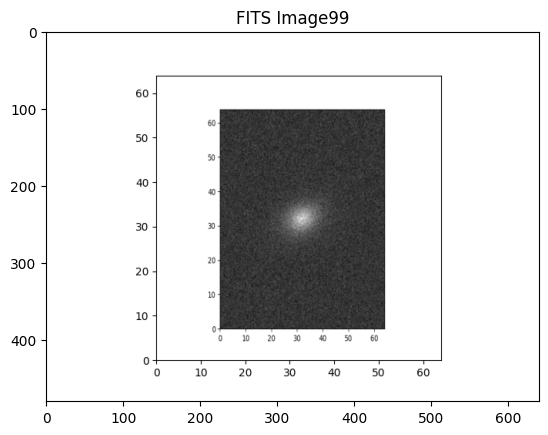

(480, 640, 4)


In [6]:
for i in range(100):

    # Specify the path to your FITS file
    fits_file_path = f'random_sim_gal/ellips{i}.fits'

    # Open the FITS file
    hdul = fits.open(fits_file_path)

    # Assuming the data is in the primary HDU (extension 0)
    data = hdul[0].data

    # Close the FITS file
    hdul.close()

    # Plot the image using matplotlib
    plt.imshow(data, cmap='gray')  # Use 'cmap' to specify the color map
    plt.title(f'FITS Image{i}')

    plt.show()
    
    print(np.shape(np.array(data)))

## Simulate ring galaxies 

## Merger galaxies